# Generative Adversarial Networks for Beginners
## Build a neural network that learns to generate handwritten digits.
### By [Jon Bruner](https://github.com/jonbruner) and [Adit Deshpande](https://github.com/adeshpande3)

This notebook accompanies [the O'Reilly interactive tutorial on generative adversarial networks](https://www.oreilly.com/learning/generative-adversarial-networks-for-beginners). See the original tutorial to run this code in a pre-built environment on O'Reilly's servers with cell-by-cell guidance, or run this notebook on your own machine.

Also, see [gan-script.py](gan-script.py) in this repository for a straight Python implementation of this code.

### Prerequisites

You'll need [TensorFlow](https://www.tensorflow.org/install/), [NumPy](https://docs.scipy.org/doc/numpy/user/install.html), [matplotlib](https://matplotlib.org/) and [Jupyter](https://jupyter.readthedocs.io/en/latest/install.html) in order to run this notebook on your machine. See [the readme](https://github.com/jonbruner/generative-adversarial-networks) for advice on installing these packages.

## Introduction

According to Yann LeCun, “adversarial training is the coolest thing since sliced bread.” Sliced bread certainly never created this much excitement within the deep learning community. Generative adversarial networks—or GANs, for short—have dramatically sharpened the possibility of AI-generated content, and have drawn active research efforts since they were [first described by Ian Goodfellow et al. in 2014](https://arxiv.org/abs/1406.2661).

GANs are neural networks that learn to create synthetic data similar to some known input data. For instance, researchers have generated convincing images from [photographs of everything from bedrooms to album covers](https://github.com/Newmu/dcgan_code), and they display a remarkable ability to reflect [higher-order semantic logic](https://github.com/Newmu/dcgan_code).

Those examples are fairly complex, but it's easy to build a GAN that generates very simple images. In this tutorial, we'll build a GAN that analyzes lots of images of handwritten digits and gradually learns to generate new images from scratch—*essentially, we'll be teaching a neural network how to write*.

<img src="notebook-images/gan-animation.gif" />
_Sample images from the generative adversarial network that we'll build in this tutorial. During training, it gradually refines its ability to generate digits._

## GAN architecture

Generative adversarial networks consist of two models: a generative model and a discriminative model.

![caption](notebook-images/GAN_Overall.png)

The discriminator model is a classifier that determines whether a given image looks like a real image from the dataset or like an artificially created image. This is basically a binary classifier that will take the form of a normal convolutional neural network (CNN).

The generator model takes random input values and transforms them into images through a deconvolutional neural network.

Over the course of many training iterations, the weights and biases in the discriminator and the generator are trained through backpropagation. The discriminator learns to tell "real" images of handwritten digits apart from "fake" images created by the generator. At the same time, the generator uses feedback from the discriminator to learn how to produce convincing images that the discriminator can't distinguish from real images.

## Getting started

We’re going to create a GAN that will generate handwritten digits that can fool even the best classifiers (and humans too, of course). We'll use [TensorFlow](https://www.tensorflow.org/), a deep learning library open-sourced by Google that makes it easy to train neural networks on GPUs.

This tutorial expects that you're already at least a little bit familiar with TensorFlow. If you're not, we recommend reading "[Hello, TensorFlow!](https://www.oreilly.com/learning/hello-tensorflow)" or watching the "[Hello, Tensorflow!](https://www.safaribooksonline.com/oriole/hello-tensorflow-oriole)" interactive tutorial on Safari before proceeding.

## Loading MNIST data

We need a set of real handwritten digits to give the discriminator a starting point in distinguishing between real and fake images. We'll use [MNIST](http://yann.lecun.com/exdb/mnist/), a benchmark dataset in deep learning. It consists of 70,000 images of handwritten digits compiled by the U.S. National Institute of Standards and Technology from Census Bureau employees and high school students.

Let's start by importing TensorFlow along with a couple of other helpful libraries. We'll also import our MNIST images using a TensorFlow convenience function called `read_data_sets`.

In [1]:
import tensorflow as tf
import numpy as np
import datetime
import matplotlib.pyplot as plt
%matplotlib inline
import os
os.environ['CUDA_VISIBLE_DEVICES']='3'

from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets("../../MNIST_data/")

#from read_cifar import read_data_sets
#mnist = read_data_sets("/home/lapardo/cifar-10-batches-py/cifar_GANs.npz")

The MNIST variable we created above contains both the images and their labels, divided into a training set called `train` and a validation set called `validation`. (We won't need to worry about the labels in this tutorial.) We can retrieve batches of images by calling `next_batch` on `mnist`. Let's load one image and look at it.

The images are initially formatted as a single row of 784 pixels. We can reshape them into 28 x 28-pixel images and view them using pyplot.

(1, 784)


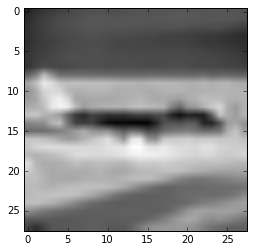

In [2]:
sample_image = mnist.train.next_batch(1)[0]
print(sample_image.shape)

sample_image = sample_image.reshape([28, 28])
plt.imshow(sample_image, cmap='Greys')

If you run the cell above again, you'll see a different image from the MNIST training set.

## Discriminator network

Our discriminator is a convolutional neural network that takes in an image of size 28 x 28 x 1 as input and returns a single scalar number that describes whether or not the input image is "real" or "fake"—that is, whether it's drawn from the set of MNIST images or generated by the generator.

![caption](notebook-images/GAN_Discriminator.png)

The structure of our discriminator network is based closely on [TensorFlow's sample CNN classifier model](https://www.tensorflow.org/get_started/mnist/pros). It features two convolutional layers that find 5x5-pixel features, and two "fully connected" layers that multiply weights by every pixel in the image.

To set up each layer, we start by creating weight and bias variables through [`tf.get_variable`](https://www.tensorflow.org/api_docs/python/tf/get_variable). Weights are initialized from a [truncated normal](https://www.tensorflow.org/api_docs/python/tf/truncated_normal) distribution, and biases are initialized at zero.

[`tf.nn.conv2d()`](https://www.tensorflow.org/api_docs/python/tf/nn/conv2d) is TensorFlow's standard convolution function. It takes 4 arguments. The first is the input volume (our `28 x 28 x 1` images in this case). The next argument is the filter/weight matrix. Finally, you can also change the stride and padding of the convolution. Those two values affect the dimensions of the output volume.

If you're already comfortable with CNNs, you'll recognize this as a simple binary classifier—nothing fancy. 

In [3]:
def discriminator(images, reuse_variables=None):
    with tf.variable_scope(tf.get_variable_scope(), reuse=reuse_variables) as scope:
        # First convolutional and pool layers
        # This finds 32 different 5 x 5 pixel features
        d_w1 = tf.get_variable('d_w1', [5, 5, 1, 32], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b1 = tf.get_variable('d_b1', [32], initializer=tf.constant_initializer(0))
        d1 = tf.nn.conv2d(input=images, filter=d_w1, strides=[1, 1, 1, 1], padding='SAME')
        d1 = d1 + d_b1
        d1 = tf.nn.relu(d1)
        d1 = tf.nn.avg_pool(d1, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

        # Second convolutional and pool layers
        # This finds 64 different 5 x 5 pixel features
        d_w2 = tf.get_variable('d_w2', [5, 5, 32, 64], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b2 = tf.get_variable('d_b2', [64], initializer=tf.constant_initializer(0))
        d2 = tf.nn.conv2d(input=d1, filter=d_w2, strides=[1, 1, 1, 1], padding='SAME')
        d2 = d2 + d_b2
        d2 = tf.nn.relu(d2)
        d2 = tf.nn.avg_pool(d2, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

        # First fully connected layer
        d_w3 = tf.get_variable('d_w3', [7 * 7 * 64, 1024], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b3 = tf.get_variable('d_b3', [1024], initializer=tf.constant_initializer(0))
        d3 = tf.reshape(d2, [-1, 7 * 7 * 64])
        d3 = tf.matmul(d3, d_w3)
        d3 = d3 + d_b3
        d3 = tf.nn.relu(d3)

        # Second fully connected layer
        d_w4 = tf.get_variable('d_w4', [1024, 1], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b4 = tf.get_variable('d_b4', [1], initializer=tf.constant_initializer(0))
        d4 = tf.matmul(d3, d_w4) + d_b4

        # d4 contains unscaled values
        return d4

## Generator network

![caption](notebook-images/GAN_Generator.png)

Now that we have our discriminator defined, let’s take a look at the generator model. We'll base the overall structure of our model on a simple generator published by [Tim O'Shea](https://github.com/osh/KerasGAN).

You can think of the generator as a kind of reverse convolutional neural network. A typical CNN like our discriminator network transforms a 2- or 3-dimensional matrix of pixel values into a single probability. A generator, however, takes a `d`-dimensional vector of noise and upsamples it to become a 28 x 28 image. ReLU and batch normalization are used to stabilize the outputs of each layer.

In our generator network, we use three convolutional layers along with interpolation until a `28 x 28` pixel image is formed. (Actually, as you'll see below, we've taken care to form `28 x 28 x 1` images; many TensorFlow tools for dealing with images anticipate that the images will have some number of _channels_—usually 1 for greyscale images or 3 for RGB color images.)

At the output layer we add a [`tf.sigmoid()`](https://www.tensorflow.org/api_docs/python/tf/sigmoid) activation function; this squeezes pixels that would appear grey toward either black or white, resulting in a crisper image.

In [4]:
def generator(z, batch_size, z_dim):
    g_w1 = tf.get_variable('g_w1', [z_dim, 3136], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b1 = tf.get_variable('g_b1', [3136], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g1 = tf.matmul(z, g_w1) + g_b1
    g1 = tf.reshape(g1, [-1, 56, 56, 1])
    g1 = tf.contrib.layers.batch_norm(g1, epsilon=1e-5, scope='bn1')
    g1 = tf.nn.relu(g1)

    # Generate 50 features
    g_w2 = tf.get_variable('g_w2', [3, 3, 1, z_dim/2], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b2 = tf.get_variable('g_b2', [z_dim/2], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g2 = tf.nn.conv2d(g1, g_w2, strides=[1, 2, 2, 1], padding='SAME')
    g2 = g2 + g_b2
    g2 = tf.contrib.layers.batch_norm(g2, epsilon=1e-5, scope='bn2')
    g2 = tf.nn.relu(g2)
    g2 = tf.image.resize_images(g2, [56, 56])

    # Generate 25 features
    g_w3 = tf.get_variable('g_w3', [3, 3, z_dim/2, z_dim/4], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b3 = tf.get_variable('g_b3', [z_dim/4], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g3 = tf.nn.conv2d(g2, g_w3, strides=[1, 2, 2, 1], padding='SAME')
    g3 = g3 + g_b3
    g3 = tf.contrib.layers.batch_norm(g3, epsilon=1e-5, scope='bn3')
    g3 = tf.nn.relu(g3)
    g3 = tf.image.resize_images(g3, [56, 56])

    # Final convolution with one output channel
    g_w4 = tf.get_variable('g_w4', [1, 1, z_dim/4, 1], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b4 = tf.get_variable('g_b4', [1], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g4 = tf.nn.conv2d(g3, g_w4, strides=[1, 2, 2, 1], padding='SAME')
    g4 = g4 + g_b4
    g4 = tf.sigmoid(g4)
    
    # Dimensions of g4: batch_size x 28 x 28 x 1
    return g4

## Generating a sample image

Now we’ve defined both the generator and discriminator functions. Let’s see what a sample output from an untrained generator looks like.

We need to open a TensorFlow session and create a placeholder for the input to our generator. The shape of the placeholder will be `None, z_dimensions`. The `None` keyword means that the value can be determined at session runtime. We normally have `None` as our first dimension so that we can have variable batch sizes. (With a batch size of 50, the input to the generator would be 50 x 100). With the `None` keywoard, we don't have to specify `batch_size` until later. 

In [5]:
z_dimensions = 100
z_placeholder = tf.placeholder(tf.float32, [None, z_dimensions])

Now, we create a variable (`generated_image_output`) that holds the output of the generator, and we'll also initialize the random noise vector that we're going to use as input. The [`np.random.normal()`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.random.normal.html) function has three arguments. The first and second define the mean and standard deviation for the normal distribution (0 and 1 in our case), and the third defines the the shape of the vector (`1 x 100`).

In [6]:
generated_image_output = generator(z_placeholder, 1, z_dimensions)
z_batch = np.random.normal(0, 1, [1, z_dimensions])

Next, we initialize all the variables, feed our `z_batch` into the placeholder, and run the session.

The [`sess.run()`](https://www.tensorflow.org/api_docs/python/tf/Session#run) function has two arguments. The first is called the "fetches" argument; it defines the value you're interested in computing. In our case, we want to see what the output of the generator is. If you look back at the last code snippet, you'll see that the output of the generator function is stored in `generated_image_output`, so we'll use `generated_image_output` for our first argument.

The second argument takes a dictionary of inputs that are substituted into the graph when it runs. This is where we feed in our placeholders. In our example, we need to feed our `z_batch` variable into the `z_placeholder` that we defined earlier. As before, we'll view the image by reshaping it to `28 x 28` pixels and show it with PyPlot.

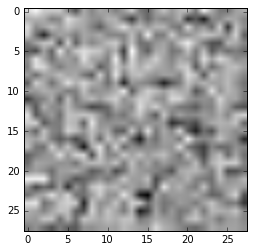

In [7]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    generated_image = sess.run(generated_image_output,
                                feed_dict={z_placeholder: z_batch})
    generated_image = generated_image.reshape([28, 28])
    plt.imshow(generated_image, cmap='Greys')

That looks like noise, right? Now we need to train the weights and biases in the generator network to convert random numbers into recognizable digits. Let's look at loss functions and optimization!

## Training a GAN

One of the trickiest parts about building and tuning GANs is that they have two loss functions: one that encourages the generator to create better images, and the other that encourages the discriminator to distinguish generated images from real images.

We train both the generator and the discriminator simultaneously. As the discriminator gets better at distinguishing real images from generated images, the generator is able to better tune its weights and biases to generate convincing images.

Here are the inputs and outputs for our networks.

In [8]:
tf.reset_default_graph()
batch_size = 50

z_placeholder = tf.placeholder(tf.float32, [None, z_dimensions], name='z_placeholder') 
# z_placeholder is for feeding input noise to the generator

x_placeholder = tf.placeholder(tf.float32, shape = [None,28,28,1], name='x_placeholder') 
# x_placeholder is for feeding input images to the discriminator

Gz = generator(z_placeholder, batch_size, z_dimensions) 
# Gz holds the generated images

Dx = discriminator(x_placeholder) 
# Dx will hold discriminator prediction probabilities
# for the real MNIST images

Dg = discriminator(Gz, reuse_variables=True)
# Dg will hold discriminator prediction probabilities for generated images

So, let’s first think about what we want out of our networks. The discriminator's goal is to correctly label real MNIST images as real (return a higher output) and generated images as fake (return a lower output). We'll calculate two losses for the discriminator: one loss that compares `Dx` and 1 for real images from the MNIST set, as well as a loss that compares `Dg` and 0 for images from the generator. We'll do this with TensorFlow's [`tf.nn.sigmoid_cross_entropy_with_logits()`](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits) function, which calculates the cross-entropy losses between `Dx` and 1 and between `Dg` and 0.

`sigmoid_cross_entropy_with_logits` operates on unscaled values rather than probability values from 0 to 1. Take a look at the last line of our discriminator: there's no softmax or sigmoid layer at the end. GANs can fail if their discriminators "saturate," or become confident enough to return exactly 0 when they're given a generated image; that leaves the discriminator without a useful gradient to descend.

The [`tf.reduce_mean()`](https://www.tensorflow.org/api_docs/python/tf/reduce_mean) function takes the mean value of all of the components in the matrix returned by the cross entropy function. This is a way of reducing the loss to a single scalar value, instead of a vector or matrix.

In [9]:
d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dx, labels = tf.ones_like(Dx)))
d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dg, labels = tf.zeros_like(Dg)))

Now let's set up the generator's loss function. We want the generator network to create images that will fool the discriminator: the generator wants the discriminator to output a value close to 1 when it's given an image from the generator. Therefore, we want to compute the loss between `Dg` and 1.

In [10]:
g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dg, labels = tf.ones_like(Dg)))  

Now that we have our loss functions, we need to define our optimizers. The optimizer for the generator network needs to only update the generator’s weights, not those of the discriminator. Likewise, when we train the discriminator, we want to hold the generator's weights fixed.

In order to make this distinction, we need to create two lists of variables, one with the discriminator’s weights and biases and another with the generator’s weights and biases. This is where naming all of your TensorFlow variables with a thoughtful scheme can come in handy.

In [11]:
tvars = tf.trainable_variables()

d_vars = [var for var in tvars if 'd_' in var.name]
g_vars = [var for var in tvars if 'g_' in var.name]

print([v.name for v in d_vars])
print([v.name for v in g_vars])
print(len(tvars))

[u'd_w1:0', u'd_b1:0', u'd_w2:0', u'd_b2:0', u'd_w3:0', u'd_b3:0', u'd_w4:0', u'd_b4:0']
[u'g_w1:0', u'g_b1:0', u'g_w2:0', u'g_b2:0', u'g_w3:0', u'g_b3:0', u'g_w4:0', u'g_b4:0']
19


Next, we specify our two optimizers. [Adam](https://www.tensorflow.org/api_docs/python/tf/train/AdamOptimizer) is usually the optimization algorithm of choice for GANs; it utilizes adaptive learning rates and momentum. We call Adam's minimize function and also specify the variables that we want it to update—the generator's weights and biases when we train the generator, and the discriminator's weights and biases when we train the discriminator.

We're setting up two different training operations for the discriminator here: one that trains the discriminator on real images and one that trains the discrmnator on fake images. It's sometimes useful to use different learning rates for these two training operations, or to use them separately to [regulate learning in other ways](https://github.com/jonbruner/ezgan).

In [12]:
# Train the discriminator
d_trainer_fake = tf.train.AdamOptimizer(0.0003).minimize(d_loss_fake, var_list=d_vars)
d_trainer_real = tf.train.AdamOptimizer(0.0003).minimize(d_loss_real, var_list=d_vars)

# Train the generator
g_trainer = tf.train.AdamOptimizer(0.0001).minimize(g_loss, var_list=g_vars)

It can be tricky to get GANs to converge, and moreover they often need to train for a very long time. [TensorBoard](https://www.tensorflow.org/how_tos/summaries_and_tensorboard/) is useful for tracking the training process; it can graph scalar properties like losses, display sample images during training, and illustrate the topology of the neural networks.

If you run this script on your own machine, include the cell below. Then, in a terminal window from the directory that this notebook lives in, run

```
tensorboard --logdir=tensorboard/
```

and open TensorBoard by visiting [`http://localhost:6006`](http://localhost:6006) in your web browser.

In [13]:
# From this point forward, reuse variables
tf.get_variable_scope().reuse_variables()

tf.summary.scalar('Generator_loss', g_loss)
tf.summary.scalar('Discriminator_loss_real', d_loss_real)
tf.summary.scalar('Discriminator_loss_fake', d_loss_fake)

images_for_tensorboard = generator(z_placeholder, batch_size, z_dimensions)
tf.summary.image('Generated_images', images_for_tensorboard, 5)
merged = tf.summary.merge_all()
logdir = "tensorboard/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"
writer = tf.summary.FileWriter(logdir, sess.graph)

And now we iterate. We begin by briefly giving the discriminator some initial training; this helps it develop a gradient that's useful to the generator.

Then we move on to the main training loop. When we train the generator, we’ll feed a random `z` vector into the generator and pass its output to the discriminator (this is the `Dg` variable we specified earlier). The generator’s weights and biases will be updated in order to produce images that the discriminator is more likely to classify as real.

To train the discriminator, we’ll feed it a batch of images from the MNIST set to serve as the positive examples, and then train the discriminator again on generated images, using them as negative examples. Remember that as the generator improves its output, the discriminator continues to learn to classify the improved generator images as fake.

Because it takes a long time to train a GAN, **we recommend not running this code block if you're going through this tutorial for the first time**. Instead, follow along but then run the following code block, which loads a pre-trained model for us to continue the tutorial.

**If you want to run this code yourself, prepare to wait: it takes about three hours on a fast GPU, but could take ten times that long on a desktop CPU.**

('dLossReal:', 0.7049759, 'dLossFake:', 0.69232595)
('dLossReal:', 0.38684613, 'dLossFake:', 1.0288079)
('dLossReal:', 0.20617807, 'dLossFake:', 0.52901804)
('dLossReal:', 0.039176382, 'dLossFake:', 0.84906149)
('dLossReal:', 0.10315183, 'dLossFake:', 2.5278823)
('Iteration:', 0, 'at', datetime.datetime(2017, 7, 7, 13, 51, 18, 737707))


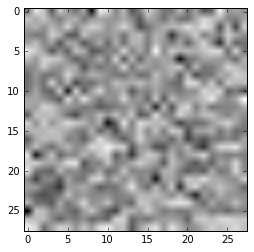

('Estimate:', array([[-2.65325809]], dtype=float32))
('Iteration:', 100, 'at', datetime.datetime(2017, 7, 7, 13, 51, 21, 269270))


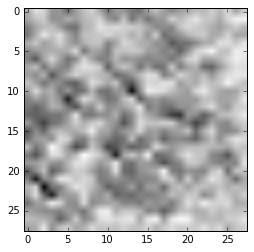

('Estimate:', array([[ 0.32402137]], dtype=float32))
('Iteration:', 200, 'at', datetime.datetime(2017, 7, 7, 13, 51, 23, 712350))


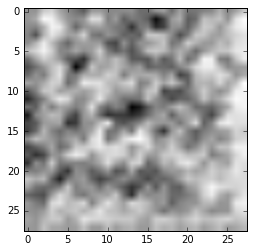

('Estimate:', array([[ 1.00247645]], dtype=float32))
('Iteration:', 300, 'at', datetime.datetime(2017, 7, 7, 13, 51, 26, 414146))


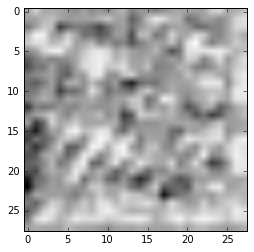

('Estimate:', array([[-1.33793557]], dtype=float32))
('Iteration:', 400, 'at', datetime.datetime(2017, 7, 7, 13, 51, 31, 360581))


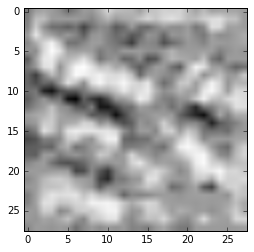

('Estimate:', array([[ 0.32765466]], dtype=float32))
('Iteration:', 500, 'at', datetime.datetime(2017, 7, 7, 13, 51, 33, 931996))


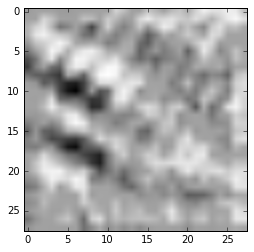

('Estimate:', array([[ 0.72170371]], dtype=float32))
('Iteration:', 600, 'at', datetime.datetime(2017, 7, 7, 13, 51, 36, 582299))


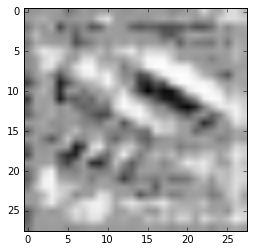

('Estimate:', array([[ 0.22790685]], dtype=float32))
('Iteration:', 700, 'at', datetime.datetime(2017, 7, 7, 13, 51, 39, 325526))


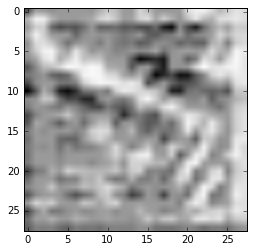

('Estimate:', array([[ 1.30925918]], dtype=float32))
('Iteration:', 800, 'at', datetime.datetime(2017, 7, 7, 13, 51, 42, 52340))


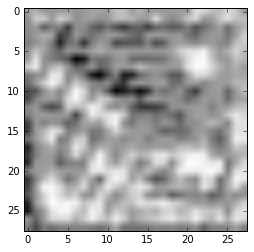

('Estimate:', array([[ 0.80004758]], dtype=float32))
('Iteration:', 900, 'at', datetime.datetime(2017, 7, 7, 13, 51, 44, 740740))


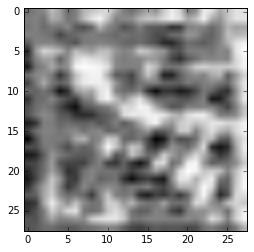

('Estimate:', array([[ 0.02155043]], dtype=float32))
('Iteration:', 1000, 'at', datetime.datetime(2017, 7, 7, 13, 51, 47, 507200))


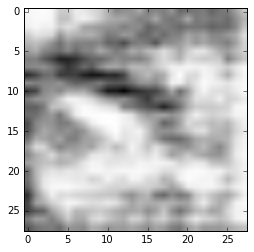

('Estimate:', array([[ 0.31309193]], dtype=float32))
('Iteration:', 1100, 'at', datetime.datetime(2017, 7, 7, 13, 51, 50, 108745))


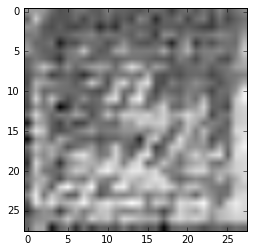

('Estimate:', array([[ 0.29379654]], dtype=float32))
('Iteration:', 1200, 'at', datetime.datetime(2017, 7, 7, 13, 51, 52, 762079))


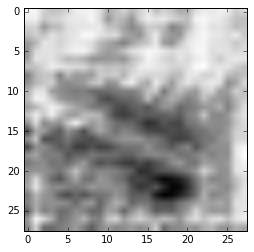

('Estimate:', array([[ 0.56846339]], dtype=float32))
('Iteration:', 1300, 'at', datetime.datetime(2017, 7, 7, 13, 52, 0, 706645))


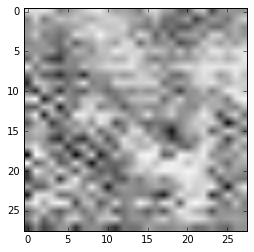

('Estimate:', array([[ 0.3376545]], dtype=float32))
('Iteration:', 1400, 'at', datetime.datetime(2017, 7, 7, 13, 52, 3, 415541))


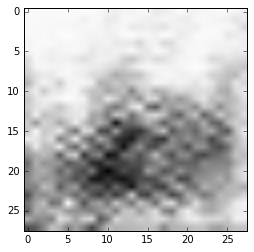

('Estimate:', array([[ 2.20402551]], dtype=float32))
('Iteration:', 1500, 'at', datetime.datetime(2017, 7, 7, 13, 52, 6, 117844))


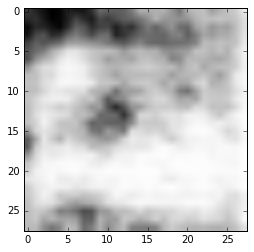

('Estimate:', array([[-0.05345802]], dtype=float32))
('Iteration:', 1600, 'at', datetime.datetime(2017, 7, 7, 13, 52, 8, 967337))


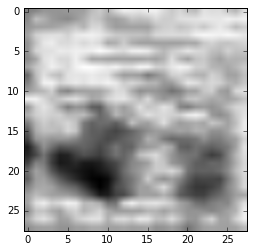

('Estimate:', array([[ 0.00906973]], dtype=float32))
('Iteration:', 1700, 'at', datetime.datetime(2017, 7, 7, 13, 52, 11, 639028))


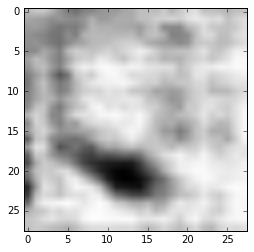

('Estimate:', array([[ 1.52769494]], dtype=float32))
('Iteration:', 1800, 'at', datetime.datetime(2017, 7, 7, 13, 52, 14, 391997))


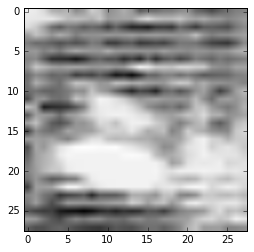

('Estimate:', array([[ 0.45099196]], dtype=float32))
('Iteration:', 1900, 'at', datetime.datetime(2017, 7, 7, 13, 52, 17, 176867))


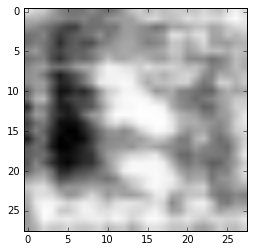

('Estimate:', array([[ 0.04943873]], dtype=float32))
('Iteration:', 2000, 'at', datetime.datetime(2017, 7, 7, 13, 52, 19, 961359))


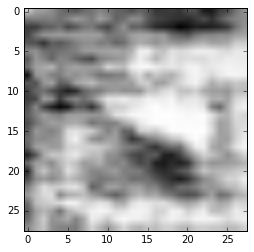

('Estimate:', array([[ 0.8708396]], dtype=float32))
('Iteration:', 2100, 'at', datetime.datetime(2017, 7, 7, 13, 52, 22, 780384))


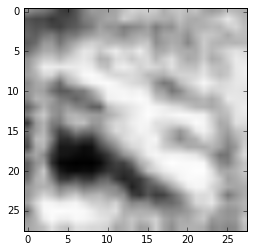

('Estimate:', array([[ 1.37633228]], dtype=float32))
('Iteration:', 2200, 'at', datetime.datetime(2017, 7, 7, 13, 52, 30, 597919))


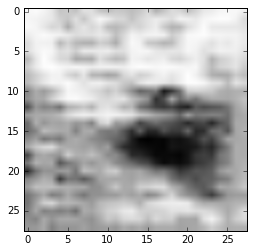

('Estimate:', array([[-0.65924865]], dtype=float32))
('Iteration:', 2300, 'at', datetime.datetime(2017, 7, 7, 13, 52, 33, 205278))


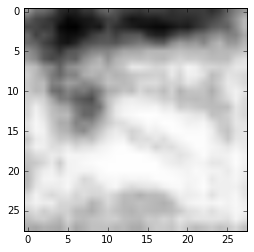

('Estimate:', array([[ 1.95193017]], dtype=float32))
('Iteration:', 2400, 'at', datetime.datetime(2017, 7, 7, 13, 52, 35, 985606))


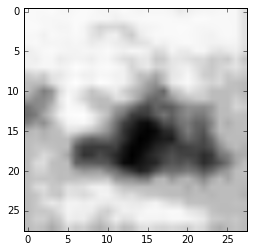

('Estimate:', array([[ 1.45354664]], dtype=float32))
('Iteration:', 2500, 'at', datetime.datetime(2017, 7, 7, 13, 52, 38, 792560))


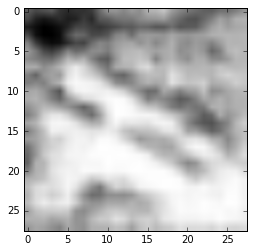

('Estimate:', array([[ 0.85651737]], dtype=float32))
('Iteration:', 2600, 'at', datetime.datetime(2017, 7, 7, 13, 52, 41, 598682))


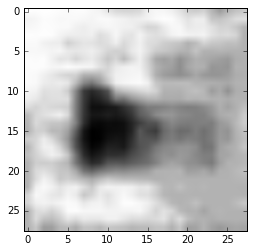

('Estimate:', array([[ 0.42910483]], dtype=float32))
('Iteration:', 2700, 'at', datetime.datetime(2017, 7, 7, 13, 52, 44, 431815))


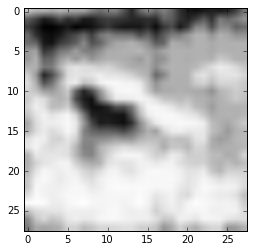

('Estimate:', array([[ 1.0349133]], dtype=float32))
('Iteration:', 2800, 'at', datetime.datetime(2017, 7, 7, 13, 52, 47, 356560))


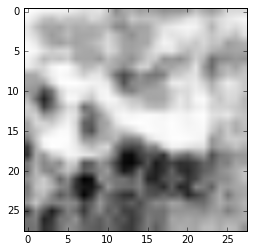

('Estimate:', array([[-0.25345781]], dtype=float32))
('Iteration:', 2900, 'at', datetime.datetime(2017, 7, 7, 13, 52, 50, 119582))


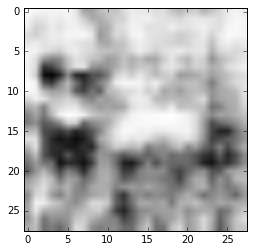

('Estimate:', array([[ 0.75521314]], dtype=float32))
('Iteration:', 3000, 'at', datetime.datetime(2017, 7, 7, 13, 52, 52, 996792))


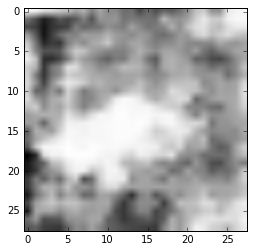

('Estimate:', array([[ 0.52180308]], dtype=float32))
('Iteration:', 3100, 'at', datetime.datetime(2017, 7, 7, 13, 52, 58, 795922))


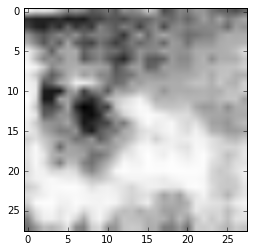

('Estimate:', array([[-0.50204086]], dtype=float32))
('Iteration:', 3200, 'at', datetime.datetime(2017, 7, 7, 13, 53, 1, 557442))


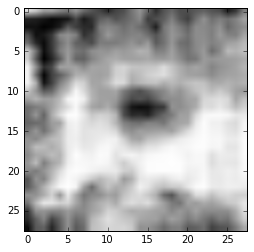

('Estimate:', array([[ 0.41153955]], dtype=float32))
('Iteration:', 3300, 'at', datetime.datetime(2017, 7, 7, 13, 53, 4, 526822))


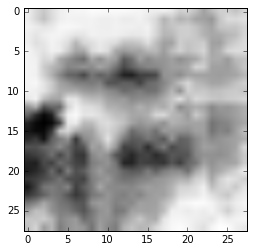

('Estimate:', array([[ 0.14887692]], dtype=float32))
('Iteration:', 3400, 'at', datetime.datetime(2017, 7, 7, 13, 53, 7, 530816))


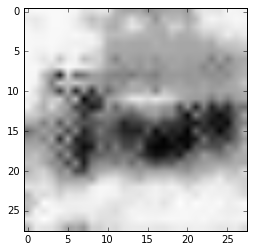

('Estimate:', array([[ 0.48566589]], dtype=float32))
('Iteration:', 3500, 'at', datetime.datetime(2017, 7, 7, 13, 53, 10, 277330))


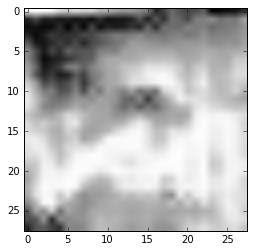

('Estimate:', array([[ 0.78625333]], dtype=float32))
('Iteration:', 3600, 'at', datetime.datetime(2017, 7, 7, 13, 53, 13, 450728))


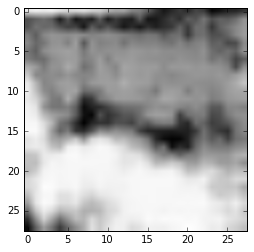

('Estimate:', array([[ 0.96159077]], dtype=float32))
('Iteration:', 3700, 'at', datetime.datetime(2017, 7, 7, 13, 53, 16, 323408))


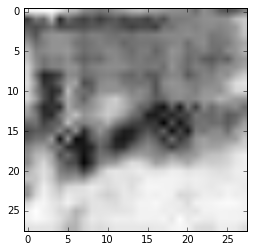

('Estimate:', array([[ 0.7867893]], dtype=float32))
('Iteration:', 3800, 'at', datetime.datetime(2017, 7, 7, 13, 53, 19, 231771))


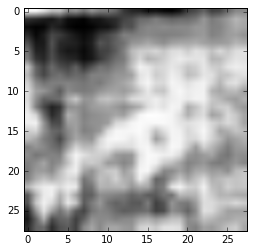

('Estimate:', array([[ 0.96531546]], dtype=float32))
('Iteration:', 3900, 'at', datetime.datetime(2017, 7, 7, 13, 53, 22, 148845))


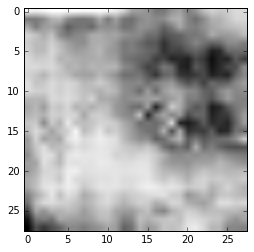

('Estimate:', array([[ 0.40903983]], dtype=float32))
('Iteration:', 4000, 'at', datetime.datetime(2017, 7, 7, 13, 53, 26, 234912))


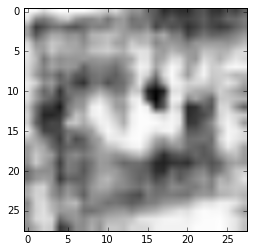

('Estimate:', array([[ 0.55101395]], dtype=float32))
('Iteration:', 4100, 'at', datetime.datetime(2017, 7, 7, 13, 53, 29, 73156))


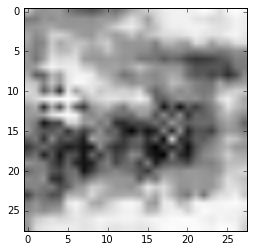

('Estimate:', array([[ 1.01256645]], dtype=float32))
('Iteration:', 4200, 'at', datetime.datetime(2017, 7, 7, 13, 53, 32, 63381))


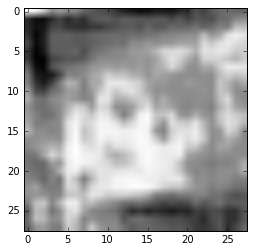

('Estimate:', array([[ 0.20909493]], dtype=float32))
('Iteration:', 4300, 'at', datetime.datetime(2017, 7, 7, 13, 53, 35, 70174))


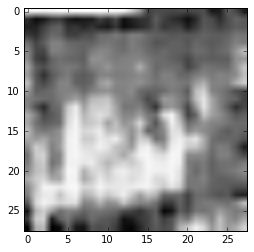

('Estimate:', array([[-0.03003672]], dtype=float32))
('Iteration:', 4400, 'at', datetime.datetime(2017, 7, 7, 13, 53, 38, 259))


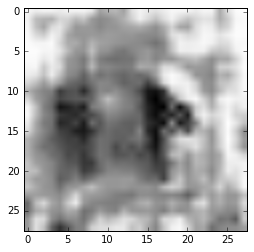

('Estimate:', array([[ 0.34032878]], dtype=float32))
('Iteration:', 4500, 'at', datetime.datetime(2017, 7, 7, 13, 53, 40, 922198))


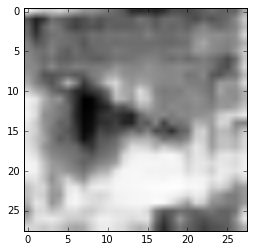

('Estimate:', array([[ 0.77197814]], dtype=float32))
('Iteration:', 4600, 'at', datetime.datetime(2017, 7, 7, 13, 53, 43, 970175))


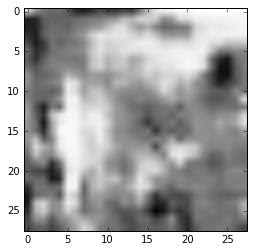

('Estimate:', array([[ 0.49601951]], dtype=float32))
('Iteration:', 4700, 'at', datetime.datetime(2017, 7, 7, 13, 53, 47, 40607))


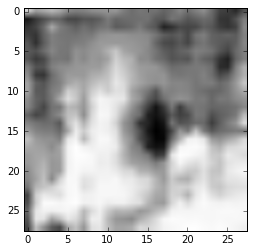

('Estimate:', array([[ 2.34502673]], dtype=float32))
('Iteration:', 4800, 'at', datetime.datetime(2017, 7, 7, 13, 53, 50, 136222))


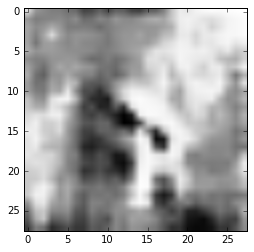

('Estimate:', array([[ 0.16551927]], dtype=float32))
('Iteration:', 4900, 'at', datetime.datetime(2017, 7, 7, 13, 53, 54, 157222))


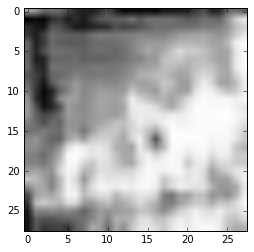

('Estimate:', array([[ 0.02785544]], dtype=float32))
('Iteration:', 5000, 'at', datetime.datetime(2017, 7, 7, 13, 53, 57, 12916))


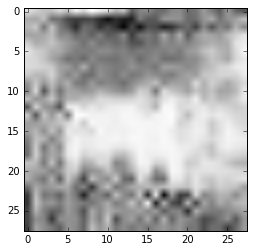

('Estimate:', array([[ 1.38898337]], dtype=float32))
('Iteration:', 5100, 'at', datetime.datetime(2017, 7, 7, 13, 53, 59, 892075))


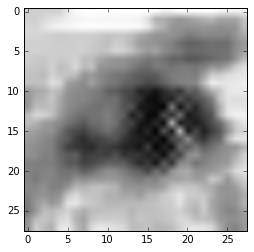

('Estimate:', array([[ 0.95269608]], dtype=float32))
('Iteration:', 5200, 'at', datetime.datetime(2017, 7, 7, 13, 54, 2, 758869))


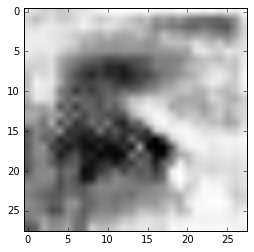

('Estimate:', array([[-0.50903368]], dtype=float32))
('Iteration:', 5300, 'at', datetime.datetime(2017, 7, 7, 13, 54, 6, 219602))


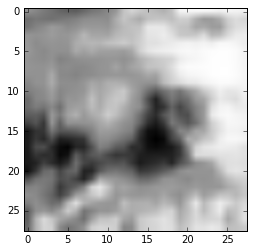

('Estimate:', array([[ 0.11814886]], dtype=float32))
('Iteration:', 5400, 'at', datetime.datetime(2017, 7, 7, 13, 54, 9, 396540))


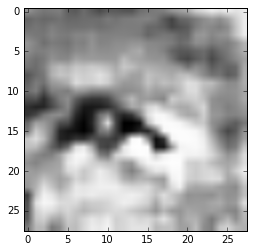

('Estimate:', array([[ 0.72313058]], dtype=float32))
('Iteration:', 5500, 'at', datetime.datetime(2017, 7, 7, 13, 54, 12, 355382))


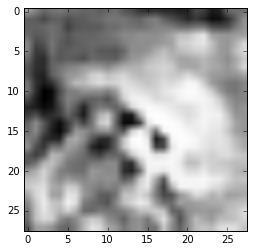

('Estimate:', array([[ 0.23051825]], dtype=float32))
('Iteration:', 5600, 'at', datetime.datetime(2017, 7, 7, 13, 54, 15, 365673))


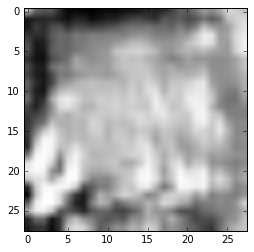

('Estimate:', array([[ 0.69410717]], dtype=float32))
('Iteration:', 5700, 'at', datetime.datetime(2017, 7, 7, 13, 54, 18, 441686))


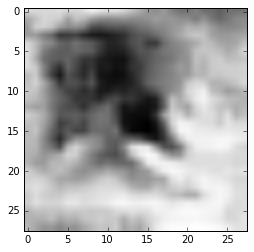

('Estimate:', array([[ 0.88369149]], dtype=float32))
('Iteration:', 5800, 'at', datetime.datetime(2017, 7, 7, 13, 54, 22, 658286))


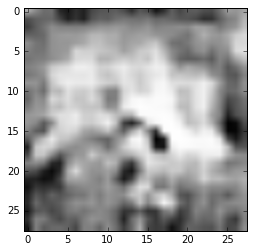

('Estimate:', array([[-1.17126524]], dtype=float32))
('Iteration:', 5900, 'at', datetime.datetime(2017, 7, 7, 13, 54, 25, 637423))


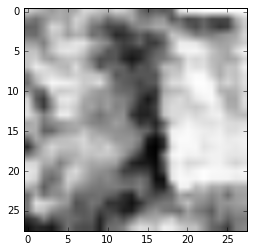

('Estimate:', array([[ 2.55565667]], dtype=float32))
('Iteration:', 6000, 'at', datetime.datetime(2017, 7, 7, 13, 54, 29, 12740))


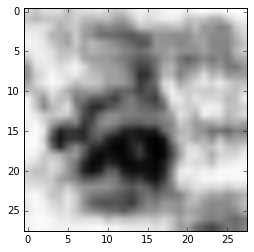

('Estimate:', array([[ 0.28730237]], dtype=float32))
('Iteration:', 6100, 'at', datetime.datetime(2017, 7, 7, 13, 54, 32, 87370))


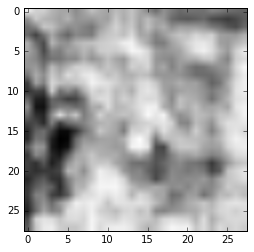

('Estimate:', array([[-0.08505547]], dtype=float32))
('Iteration:', 6200, 'at', datetime.datetime(2017, 7, 7, 13, 54, 35, 97308))


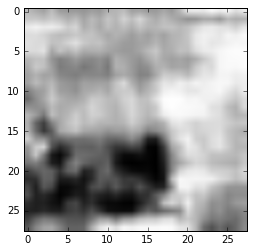

('Estimate:', array([[ 0.8123886]], dtype=float32))
('Iteration:', 6300, 'at', datetime.datetime(2017, 7, 7, 13, 54, 38, 55715))


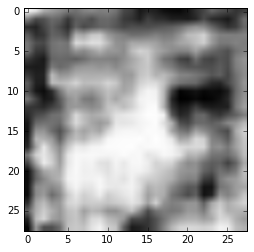

('Estimate:', array([[ 0.27906793]], dtype=float32))
('Iteration:', 6400, 'at', datetime.datetime(2017, 7, 7, 13, 54, 41, 57621))


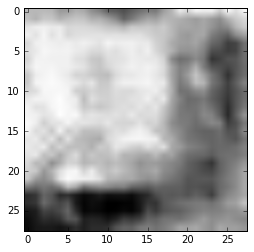

('Estimate:', array([[ 0.28379548]], dtype=float32))
('Iteration:', 6500, 'at', datetime.datetime(2017, 7, 7, 13, 54, 44, 125877))


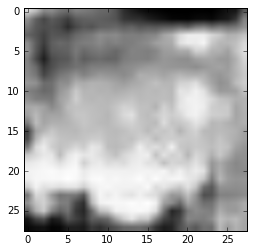

('Estimate:', array([[ 1.43221533]], dtype=float32))
('Iteration:', 6600, 'at', datetime.datetime(2017, 7, 7, 13, 54, 47, 255188))


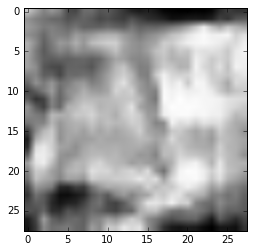

('Estimate:', array([[ 0.98868763]], dtype=float32))
('Iteration:', 6700, 'at', datetime.datetime(2017, 7, 7, 13, 54, 51, 806487))


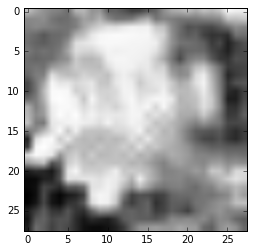

('Estimate:', array([[-0.41453987]], dtype=float32))
('Iteration:', 6800, 'at', datetime.datetime(2017, 7, 7, 13, 54, 54, 766825))


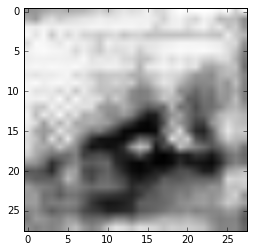

('Estimate:', array([[-0.36933827]], dtype=float32))
('Iteration:', 6900, 'at', datetime.datetime(2017, 7, 7, 13, 54, 57, 916562))


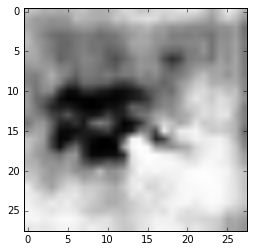

('Estimate:', array([[ 0.45079577]], dtype=float32))
('Iteration:', 7000, 'at', datetime.datetime(2017, 7, 7, 13, 55, 0, 967357))


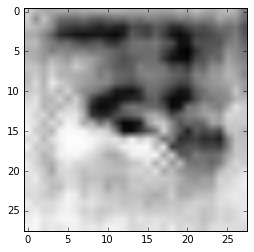

('Estimate:', array([[-0.68294519]], dtype=float32))
('Iteration:', 7100, 'at', datetime.datetime(2017, 7, 7, 13, 55, 4, 136409))


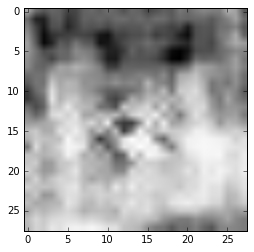

('Estimate:', array([[ 0.61839074]], dtype=float32))
('Iteration:', 7200, 'at', datetime.datetime(2017, 7, 7, 13, 55, 7, 464793))


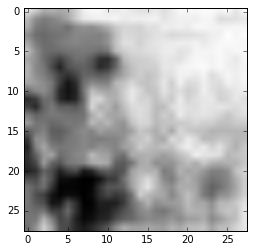

('Estimate:', array([[ 0.97145283]], dtype=float32))
('Iteration:', 7300, 'at', datetime.datetime(2017, 7, 7, 13, 55, 10, 545005))


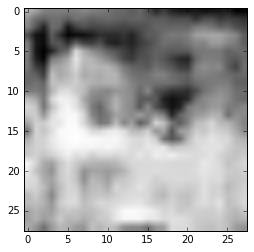

('Estimate:', array([[ 1.04973662]], dtype=float32))
('Iteration:', 7400, 'at', datetime.datetime(2017, 7, 7, 13, 55, 13, 581736))


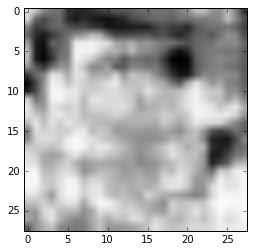

('Estimate:', array([[ 0.63384563]], dtype=float32))
('Iteration:', 7500, 'at', datetime.datetime(2017, 7, 7, 13, 55, 16, 671402))


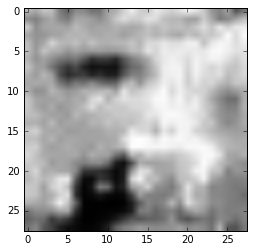

('Estimate:', array([[-0.3120971]], dtype=float32))
('Iteration:', 7600, 'at', datetime.datetime(2017, 7, 7, 13, 55, 21, 259658))


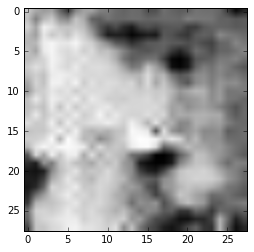

('Estimate:', array([[ 0.07221488]], dtype=float32))
('Iteration:', 7700, 'at', datetime.datetime(2017, 7, 7, 13, 55, 24, 354297))


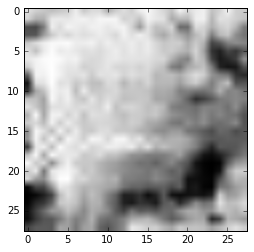

('Estimate:', array([[ 0.16444993]], dtype=float32))
('Iteration:', 7800, 'at', datetime.datetime(2017, 7, 7, 13, 55, 27, 540260))


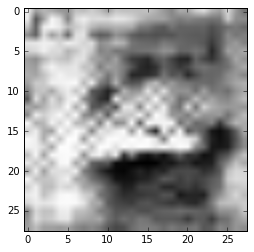

('Estimate:', array([[ 0.35832912]], dtype=float32))
('Iteration:', 7900, 'at', datetime.datetime(2017, 7, 7, 13, 55, 30, 579438))


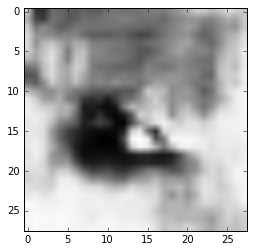

('Estimate:', array([[ 0.5132947]], dtype=float32))
('Iteration:', 8000, 'at', datetime.datetime(2017, 7, 7, 13, 55, 33, 728391))


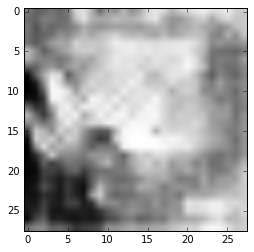

('Estimate:', array([[-0.99740332]], dtype=float32))
('Iteration:', 8100, 'at', datetime.datetime(2017, 7, 7, 13, 55, 36, 937615))


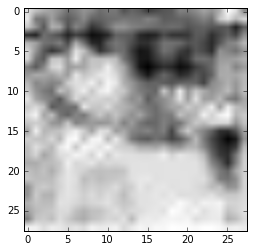

('Estimate:', array([[ 0.10915419]], dtype=float32))
('Iteration:', 8200, 'at', datetime.datetime(2017, 7, 7, 13, 55, 40, 413550))


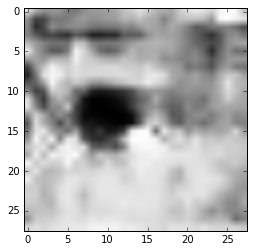

('Estimate:', array([[-5.90504313]], dtype=float32))
('Iteration:', 8300, 'at', datetime.datetime(2017, 7, 7, 13, 55, 43, 597817))


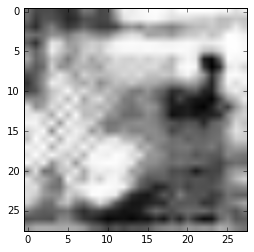

('Estimate:', array([[-2.93889308]], dtype=float32))
('Iteration:', 8400, 'at', datetime.datetime(2017, 7, 7, 13, 55, 46, 765401))


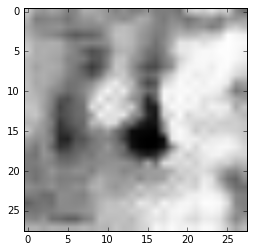

('Estimate:', array([[-6.9924531]], dtype=float32))
('Iteration:', 8500, 'at', datetime.datetime(2017, 7, 7, 13, 55, 51, 30199))


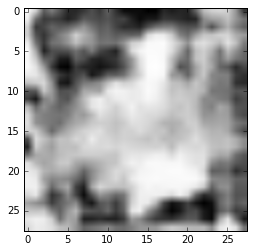

('Estimate:', array([[ 1.07534385]], dtype=float32))
('Iteration:', 8600, 'at', datetime.datetime(2017, 7, 7, 13, 55, 54, 89597))


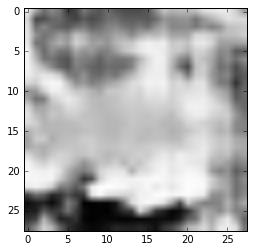

('Estimate:', array([[ 5.08584642]], dtype=float32))
('Iteration:', 8700, 'at', datetime.datetime(2017, 7, 7, 13, 55, 57, 293457))


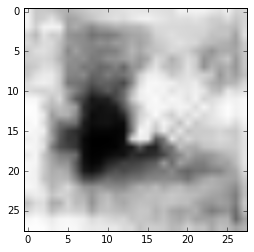

('Estimate:', array([[ 3.54853177]], dtype=float32))
('Iteration:', 8800, 'at', datetime.datetime(2017, 7, 7, 13, 56, 0, 326653))


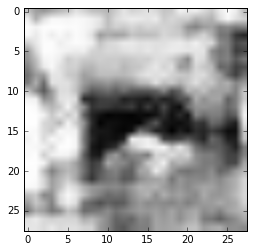

('Estimate:', array([[ 12.85288525]], dtype=float32))
('Iteration:', 8900, 'at', datetime.datetime(2017, 7, 7, 13, 56, 3, 597086))


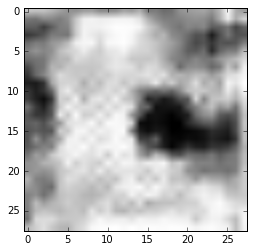

('Estimate:', array([[ 1.4799546]], dtype=float32))
('Iteration:', 9000, 'at', datetime.datetime(2017, 7, 7, 13, 56, 6, 864380))


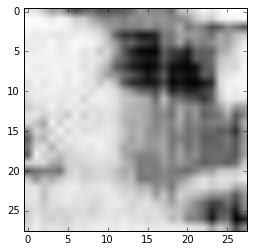

('Estimate:', array([[ 10.55134296]], dtype=float32))
('Iteration:', 9100, 'at', datetime.datetime(2017, 7, 7, 13, 56, 9, 946735))


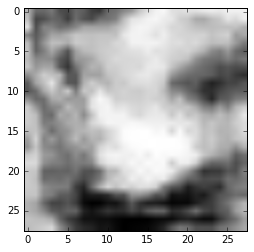

('Estimate:', array([[ 3.51196671]], dtype=float32))
('Iteration:', 9200, 'at', datetime.datetime(2017, 7, 7, 13, 56, 13, 156303))


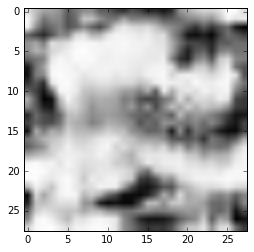

('Estimate:', array([[ 6.31397963]], dtype=float32))
('Iteration:', 9300, 'at', datetime.datetime(2017, 7, 7, 13, 56, 16, 445341))


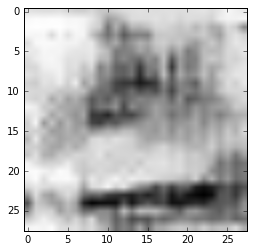

('Estimate:', array([[ 0.56846809]], dtype=float32))
('Iteration:', 9400, 'at', datetime.datetime(2017, 7, 7, 13, 56, 20, 647075))


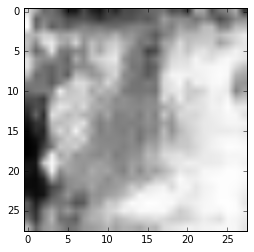

('Estimate:', array([[-3.58024693]], dtype=float32))
('Iteration:', 9500, 'at', datetime.datetime(2017, 7, 7, 13, 56, 23, 754394))


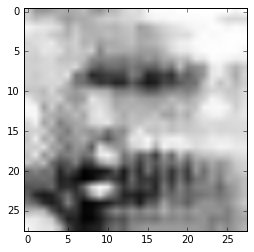

('Estimate:', array([[ 20.82611465]], dtype=float32))
('Iteration:', 9600, 'at', datetime.datetime(2017, 7, 7, 13, 56, 27, 143171))


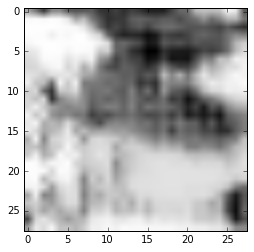

('Estimate:', array([[-7.75051212]], dtype=float32))
('Iteration:', 9700, 'at', datetime.datetime(2017, 7, 7, 13, 56, 30, 429137))


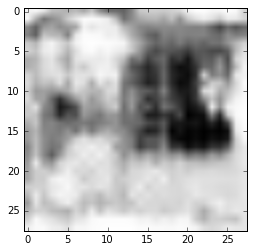

('Estimate:', array([[-0.69177949]], dtype=float32))
('Iteration:', 9800, 'at', datetime.datetime(2017, 7, 7, 13, 56, 33, 721904))


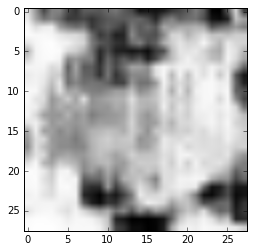

('Estimate:', array([[-1.64740872]], dtype=float32))
('Iteration:', 9900, 'at', datetime.datetime(2017, 7, 7, 13, 56, 37, 285603))


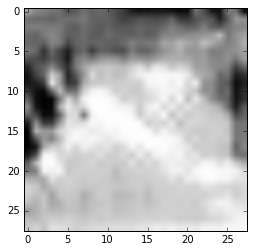

('Estimate:', array([[ 1.845011]], dtype=float32))
('Iteration:', 10000, 'at', datetime.datetime(2017, 7, 7, 13, 56, 40, 620633))


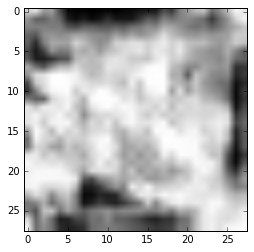

('Estimate:', array([[ 10.91067028]], dtype=float32))
('Iteration:', 10100, 'at', datetime.datetime(2017, 7, 7, 13, 56, 43, 782979))


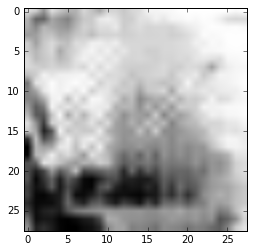

('Estimate:', array([[ 9.30674744]], dtype=float32))
('Iteration:', 10200, 'at', datetime.datetime(2017, 7, 7, 13, 56, 47, 147335))


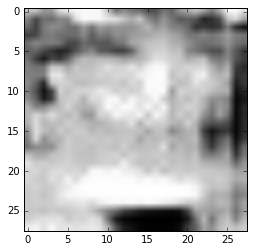

('Estimate:', array([[ 1.71991694]], dtype=float32))
('Iteration:', 10300, 'at', datetime.datetime(2017, 7, 7, 13, 56, 51, 518325))


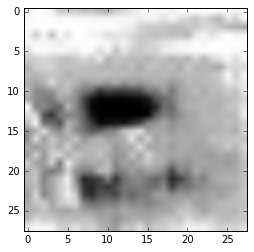

('Estimate:', array([[ 4.9853301]], dtype=float32))
('Iteration:', 10400, 'at', datetime.datetime(2017, 7, 7, 13, 56, 54, 695810))


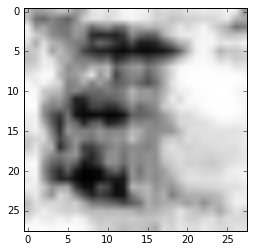

('Estimate:', array([[-12.91716576]], dtype=float32))
('Iteration:', 10500, 'at', datetime.datetime(2017, 7, 7, 13, 56, 58, 25875))


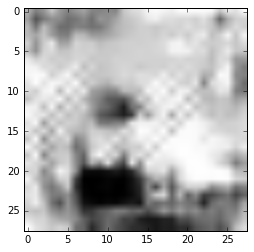

('Estimate:', array([[ 7.23154402]], dtype=float32))
('Iteration:', 10600, 'at', datetime.datetime(2017, 7, 7, 13, 57, 1, 211517))


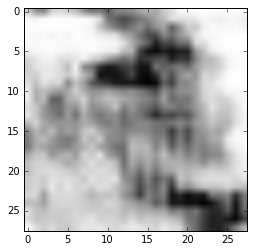

('Estimate:', array([[-2.93853378]], dtype=float32))
('Iteration:', 10700, 'at', datetime.datetime(2017, 7, 7, 13, 57, 4, 367563))


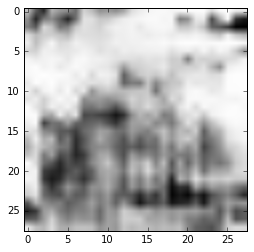

('Estimate:', array([[ 0.77167088]], dtype=float32))
('Iteration:', 10800, 'at', datetime.datetime(2017, 7, 7, 13, 57, 7, 936896))


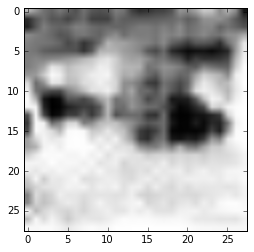

('Estimate:', array([[ 0.16660972]], dtype=float32))
('Iteration:', 10900, 'at', datetime.datetime(2017, 7, 7, 13, 57, 11, 113173))


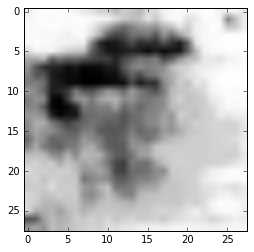

('Estimate:', array([[ 1.28370774]], dtype=float32))
('Iteration:', 11000, 'at', datetime.datetime(2017, 7, 7, 13, 57, 14, 410989))


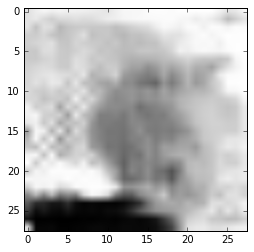

('Estimate:', array([[ 21.89951324]], dtype=float32))
('Iteration:', 11100, 'at', datetime.datetime(2017, 7, 7, 13, 57, 17, 640983))


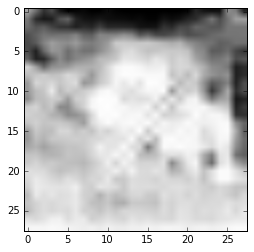

('Estimate:', array([[ 4.74107742]], dtype=float32))
('Iteration:', 11200, 'at', datetime.datetime(2017, 7, 7, 13, 57, 21, 988102))


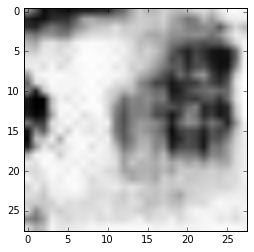

('Estimate:', array([[-0.19091514]], dtype=float32))
('Iteration:', 11300, 'at', datetime.datetime(2017, 7, 7, 13, 57, 25, 113050))


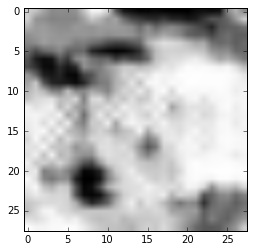

('Estimate:', array([[-4.22920084]], dtype=float32))
('Iteration:', 11400, 'at', datetime.datetime(2017, 7, 7, 13, 57, 28, 736188))


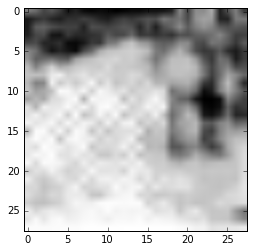

('Estimate:', array([[ 3.20184875]], dtype=float32))
('Iteration:', 11500, 'at', datetime.datetime(2017, 7, 7, 13, 57, 31, 854433))


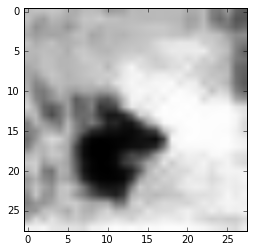

('Estimate:', array([[ 4.30253363]], dtype=float32))
('Iteration:', 11600, 'at', datetime.datetime(2017, 7, 7, 13, 57, 35, 216784))


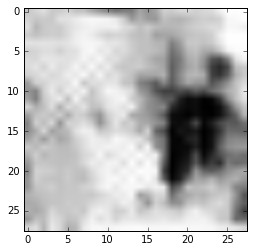

('Estimate:', array([[ 0.53323621]], dtype=float32))
('Iteration:', 11700, 'at', datetime.datetime(2017, 7, 7, 13, 57, 38, 436328))


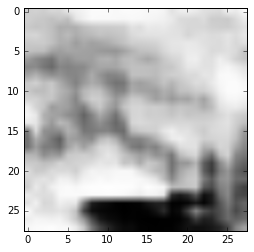

('Estimate:', array([[-3.33862782]], dtype=float32))
('Iteration:', 11800, 'at', datetime.datetime(2017, 7, 7, 13, 57, 42, 35567))


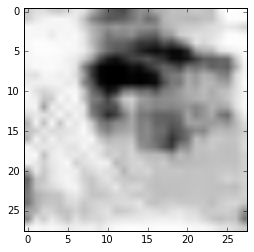

('Estimate:', array([[ 0.88362086]], dtype=float32))
('Iteration:', 11900, 'at', datetime.datetime(2017, 7, 7, 13, 57, 45, 377293))


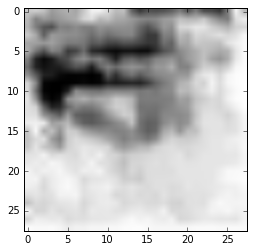

('Estimate:', array([[ 0.97032404]], dtype=float32))
('Iteration:', 12000, 'at', datetime.datetime(2017, 7, 7, 13, 57, 48, 911224))


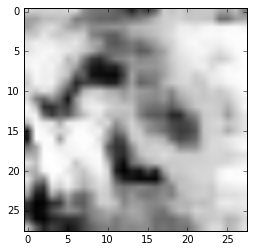

('Estimate:', array([[ 18.16200256]], dtype=float32))
('Iteration:', 12100, 'at', datetime.datetime(2017, 7, 7, 13, 57, 53, 543111))


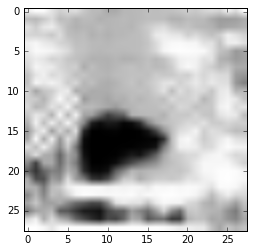

('Estimate:', array([[ 2.45268488]], dtype=float32))
('Iteration:', 12200, 'at', datetime.datetime(2017, 7, 7, 13, 57, 56, 972716))


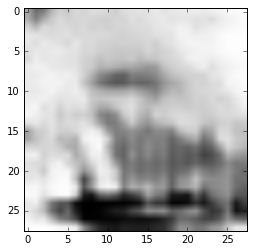

('Estimate:', array([[ 0.8371309]], dtype=float32))
('Iteration:', 12300, 'at', datetime.datetime(2017, 7, 7, 13, 58, 0, 335883))


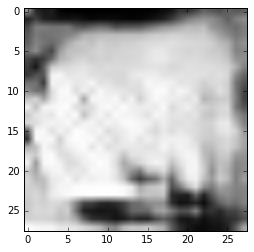

('Estimate:', array([[ 4.60522604]], dtype=float32))
('Iteration:', 12400, 'at', datetime.datetime(2017, 7, 7, 13, 58, 3, 594426))


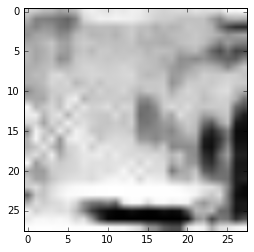

('Estimate:', array([[-2.27335739]], dtype=float32))
('Iteration:', 12500, 'at', datetime.datetime(2017, 7, 7, 13, 58, 7, 37818))


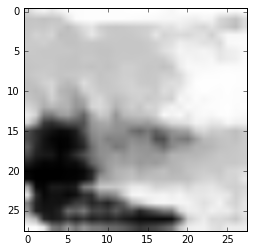

('Estimate:', array([[-0.6496734]], dtype=float32))
('Iteration:', 12600, 'at', datetime.datetime(2017, 7, 7, 13, 58, 10, 322962))


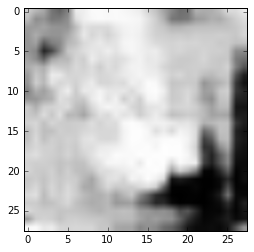

('Estimate:', array([[-2.34306622]], dtype=float32))
('Iteration:', 12700, 'at', datetime.datetime(2017, 7, 7, 13, 58, 13, 726792))


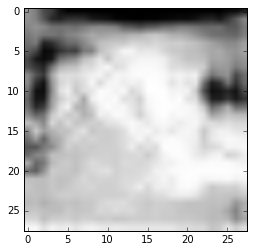

('Estimate:', array([[ 3.49543047]], dtype=float32))
('Iteration:', 12800, 'at', datetime.datetime(2017, 7, 7, 13, 58, 17, 300371))


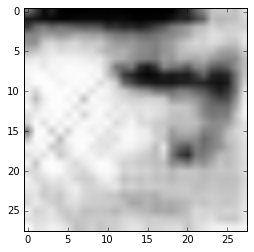

('Estimate:', array([[-4.29296112]], dtype=float32))
('Iteration:', 12900, 'at', datetime.datetime(2017, 7, 7, 13, 58, 20, 644629))


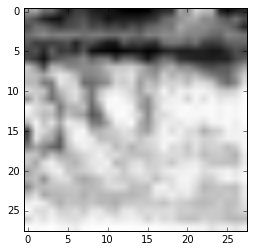

('Estimate:', array([[ 7.49950981]], dtype=float32))
('Iteration:', 13000, 'at', datetime.datetime(2017, 7, 7, 13, 58, 25, 278544))


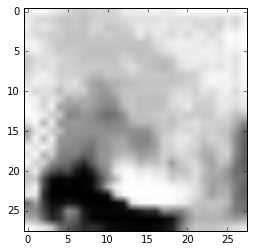

('Estimate:', array([[-0.27947187]], dtype=float32))
('Iteration:', 13100, 'at', datetime.datetime(2017, 7, 7, 13, 58, 29, 32682))


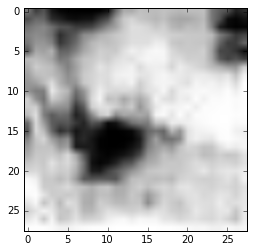

('Estimate:', array([[-7.03818989]], dtype=float32))
('Iteration:', 13200, 'at', datetime.datetime(2017, 7, 7, 13, 58, 32, 378978))


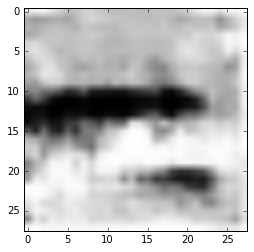

('Estimate:', array([[ 0.32834762]], dtype=float32))
('Iteration:', 13300, 'at', datetime.datetime(2017, 7, 7, 13, 58, 35, 884021))


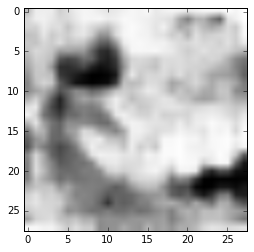

('Estimate:', array([[ 3.61903]], dtype=float32))
('Iteration:', 13400, 'at', datetime.datetime(2017, 7, 7, 13, 58, 39, 275444))


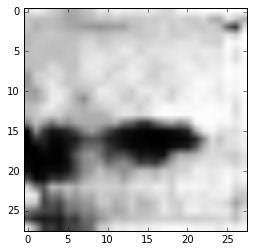

('Estimate:', array([[ 1.37106228]], dtype=float32))
('Iteration:', 13500, 'at', datetime.datetime(2017, 7, 7, 13, 58, 42, 814932))


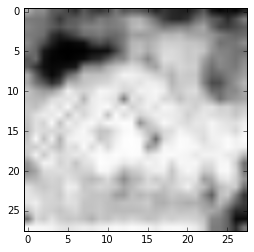

('Estimate:', array([[ 1.5181073]], dtype=float32))
('Iteration:', 13600, 'at', datetime.datetime(2017, 7, 7, 13, 58, 46, 343991))


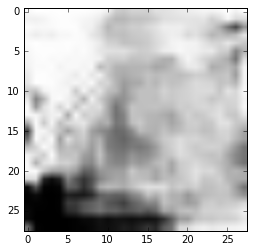

('Estimate:', array([[ 14.98472786]], dtype=float32))
('Iteration:', 13700, 'at', datetime.datetime(2017, 7, 7, 13, 58, 49, 787754))


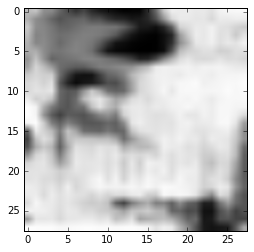

('Estimate:', array([[ 2.50135636]], dtype=float32))
('Iteration:', 13800, 'at', datetime.datetime(2017, 7, 7, 13, 58, 53, 139937))


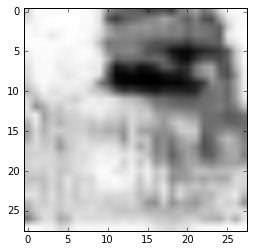

('Estimate:', array([[-7.49590445]], dtype=float32))
('Iteration:', 13900, 'at', datetime.datetime(2017, 7, 7, 13, 58, 57, 708553))


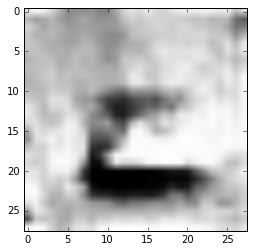

('Estimate:', array([[-1.84870064]], dtype=float32))
('Iteration:', 14000, 'at', datetime.datetime(2017, 7, 7, 13, 59, 1, 527530))


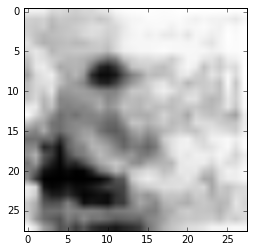

('Estimate:', array([[ 10.80909729]], dtype=float32))
('Iteration:', 14100, 'at', datetime.datetime(2017, 7, 7, 13, 59, 4, 862579))


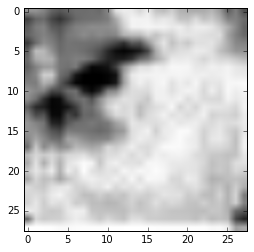

('Estimate:', array([[ 0.91288501]], dtype=float32))
('Iteration:', 14200, 'at', datetime.datetime(2017, 7, 7, 13, 59, 8, 472082))


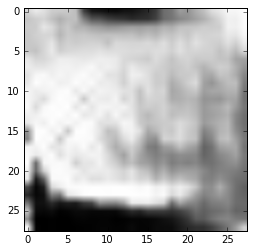

('Estimate:', array([[-15.08491993]], dtype=float32))
('Iteration:', 14300, 'at', datetime.datetime(2017, 7, 7, 13, 59, 11, 960388))


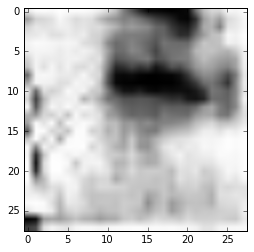

('Estimate:', array([[ 4.39446926]], dtype=float32))
('Iteration:', 14400, 'at', datetime.datetime(2017, 7, 7, 13, 59, 15, 419225))


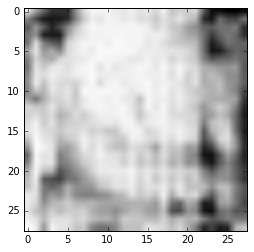

('Estimate:', array([[-9.36280632]], dtype=float32))
('Iteration:', 14500, 'at', datetime.datetime(2017, 7, 7, 13, 59, 18, 881654))


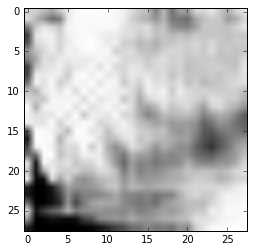

('Estimate:', array([[ 1.06146753]], dtype=float32))
('Iteration:', 14600, 'at', datetime.datetime(2017, 7, 7, 13, 59, 22, 302249))


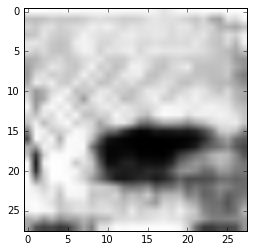

('Estimate:', array([[ 1.3557204]], dtype=float32))
('Iteration:', 14700, 'at', datetime.datetime(2017, 7, 7, 13, 59, 25, 842814))


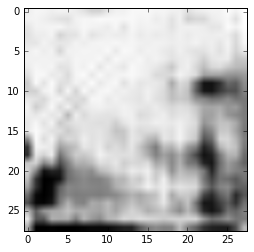

('Estimate:', array([[ 7.58471918]], dtype=float32))
('Iteration:', 14800, 'at', datetime.datetime(2017, 7, 7, 13, 59, 30, 516283))


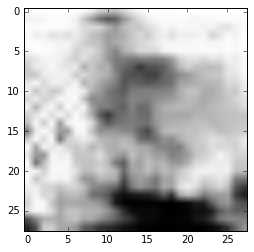

('Estimate:', array([[-0.31057209]], dtype=float32))
('Iteration:', 14900, 'at', datetime.datetime(2017, 7, 7, 13, 59, 33, 951604))


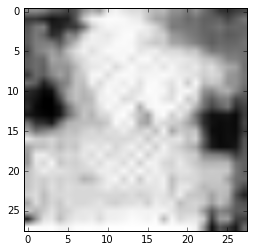

('Estimate:', array([[ 1.63530719]], dtype=float32))
('Iteration:', 15000, 'at', datetime.datetime(2017, 7, 7, 13, 59, 37, 355074))


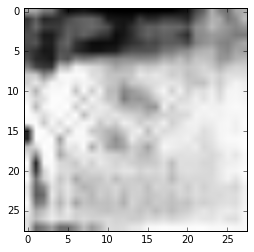

('Estimate:', array([[-7.09446192]], dtype=float32))
('Iteration:', 15100, 'at', datetime.datetime(2017, 7, 7, 13, 59, 40, 795043))


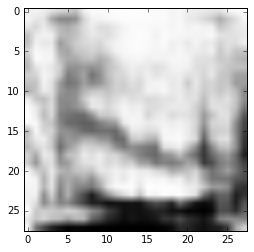

('Estimate:', array([[-3.41965556]], dtype=float32))
('Iteration:', 15200, 'at', datetime.datetime(2017, 7, 7, 13, 59, 44, 263998))


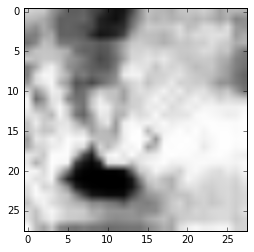

('Estimate:', array([[-1.34162247]], dtype=float32))
('Iteration:', 15300, 'at', datetime.datetime(2017, 7, 7, 13, 59, 48, 27566))


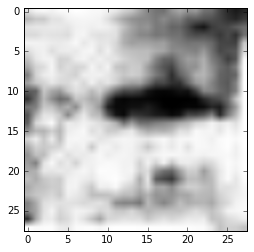

('Estimate:', array([[ 1.18164134]], dtype=float32))
('Iteration:', 15400, 'at', datetime.datetime(2017, 7, 7, 13, 59, 51, 378266))


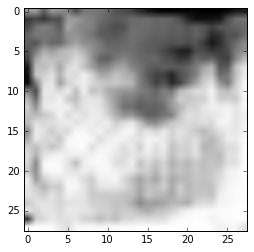

('Estimate:', array([[-2.05412745]], dtype=float32))
('Iteration:', 15500, 'at', datetime.datetime(2017, 7, 7, 13, 59, 54, 794295))


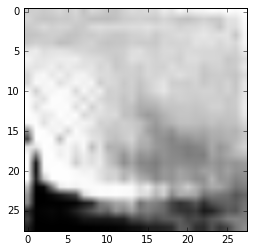

('Estimate:', array([[-9.64810276]], dtype=float32))
('Iteration:', 15600, 'at', datetime.datetime(2017, 7, 7, 13, 59, 58, 251051))


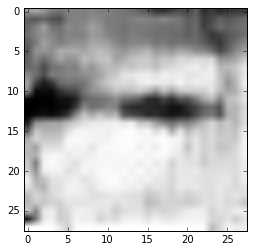

('Estimate:', array([[ 0.76238048]], dtype=float32))
('Iteration:', 15700, 'at', datetime.datetime(2017, 7, 7, 14, 0, 2, 997486))


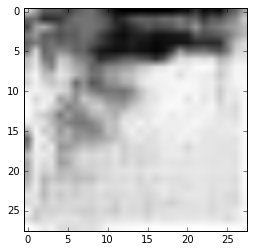

('Estimate:', array([[-0.74562228]], dtype=float32))
('Iteration:', 15800, 'at', datetime.datetime(2017, 7, 7, 14, 0, 6, 418394))


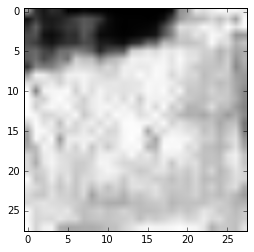

('Estimate:', array([[ 2.33460212]], dtype=float32))
('Iteration:', 15900, 'at', datetime.datetime(2017, 7, 7, 14, 0, 9, 921124))


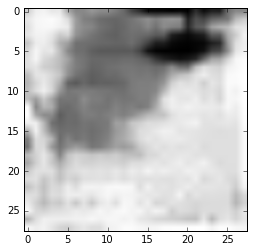

('Estimate:', array([[-0.78361875]], dtype=float32))
('Iteration:', 16000, 'at', datetime.datetime(2017, 7, 7, 14, 0, 13, 488691))


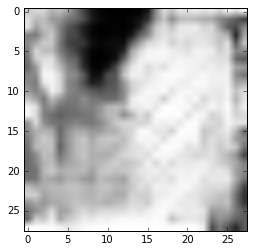

('Estimate:', array([[-0.47423613]], dtype=float32))
('Iteration:', 16100, 'at', datetime.datetime(2017, 7, 7, 14, 0, 16, 903849))


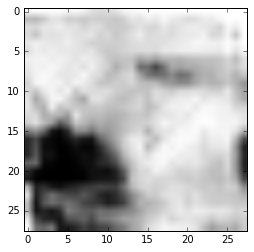

('Estimate:', array([[-3.35054874]], dtype=float32))
('Iteration:', 16200, 'at', datetime.datetime(2017, 7, 7, 14, 0, 20, 589116))


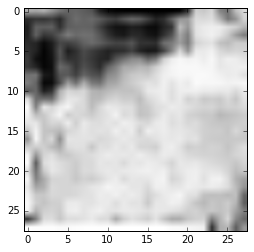

('Estimate:', array([[ 3.40305495]], dtype=float32))
('Iteration:', 16300, 'at', datetime.datetime(2017, 7, 7, 14, 0, 24, 40744))


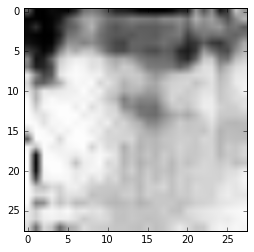

('Estimate:', array([[ 3.93366814]], dtype=float32))
('Iteration:', 16400, 'at', datetime.datetime(2017, 7, 7, 14, 0, 27, 843661))


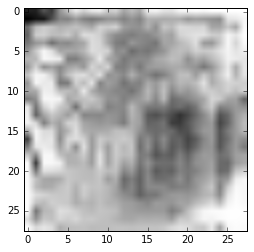

('Estimate:', array([[ 2.97423315]], dtype=float32))
('Iteration:', 16500, 'at', datetime.datetime(2017, 7, 7, 14, 0, 31, 731639))


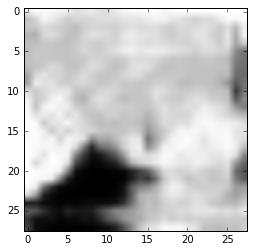

('Estimate:', array([[-0.31251624]], dtype=float32))
('Iteration:', 16600, 'at', datetime.datetime(2017, 7, 7, 14, 0, 36, 412397))


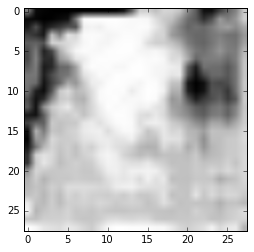

('Estimate:', array([[ 0.16970707]], dtype=float32))
('Iteration:', 16700, 'at', datetime.datetime(2017, 7, 7, 14, 0, 39, 909464))


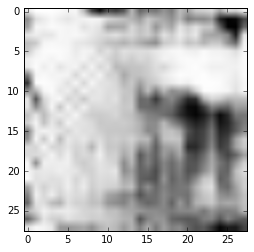

('Estimate:', array([[ 6.23321056]], dtype=float32))
('Iteration:', 16800, 'at', datetime.datetime(2017, 7, 7, 14, 0, 43, 466644))


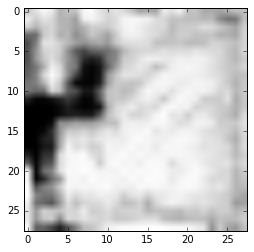

('Estimate:', array([[-2.74594474]], dtype=float32))
('Iteration:', 16900, 'at', datetime.datetime(2017, 7, 7, 14, 0, 47, 142990))


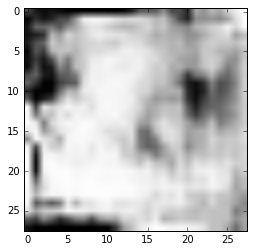

('Estimate:', array([[ 0.79262054]], dtype=float32))
('Iteration:', 17000, 'at', datetime.datetime(2017, 7, 7, 14, 0, 50, 846974))


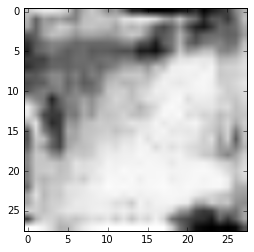

('Estimate:', array([[-0.70110089]], dtype=float32))
('Iteration:', 17100, 'at', datetime.datetime(2017, 7, 7, 14, 0, 54, 352568))


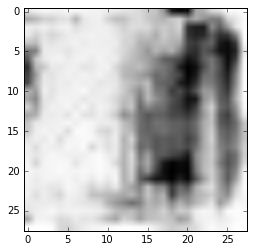

('Estimate:', array([[ 10.74594402]], dtype=float32))
('Iteration:', 17200, 'at', datetime.datetime(2017, 7, 7, 14, 0, 58, 6909))


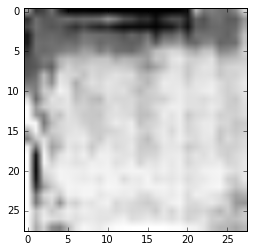

('Estimate:', array([[ 2.34652472]], dtype=float32))
('Iteration:', 17300, 'at', datetime.datetime(2017, 7, 7, 14, 1, 1, 556720))


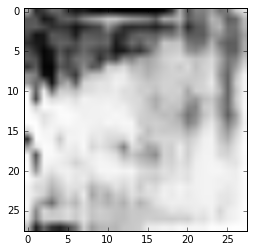

('Estimate:', array([[ 0.67436367]], dtype=float32))
('Iteration:', 17400, 'at', datetime.datetime(2017, 7, 7, 14, 1, 5, 164851))


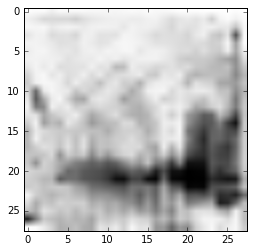

('Estimate:', array([[ 12.18078899]], dtype=float32))
('Iteration:', 17500, 'at', datetime.datetime(2017, 7, 7, 14, 1, 10, 540178))


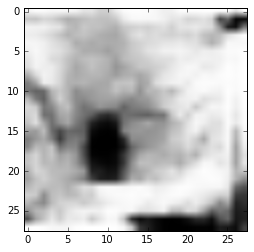

('Estimate:', array([[-1.68507934]], dtype=float32))
('Iteration:', 17600, 'at', datetime.datetime(2017, 7, 7, 14, 1, 14, 67955))


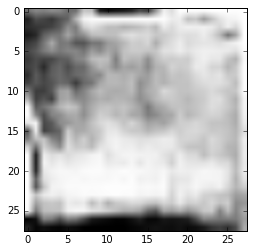

('Estimate:', array([[ 0.63290596]], dtype=float32))
('Iteration:', 17700, 'at', datetime.datetime(2017, 7, 7, 14, 1, 17, 674723))


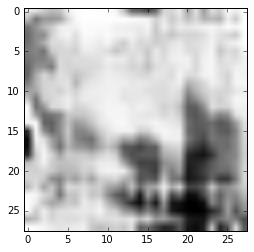

('Estimate:', array([[ 2.80190778]], dtype=float32))
('Iteration:', 17800, 'at', datetime.datetime(2017, 7, 7, 14, 1, 21, 450951))


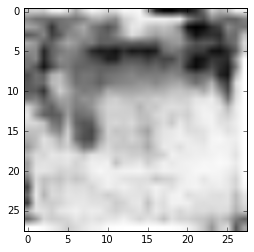

('Estimate:', array([[ 1.11463428]], dtype=float32))
('Iteration:', 17900, 'at', datetime.datetime(2017, 7, 7, 14, 1, 25, 37093))


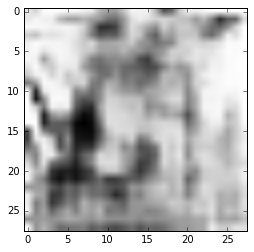

('Estimate:', array([[-11.7068243]], dtype=float32))
('Iteration:', 18000, 'at', datetime.datetime(2017, 7, 7, 14, 1, 29, 171452))


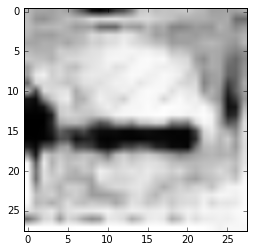

('Estimate:', array([[ 1.78344548]], dtype=float32))
('Iteration:', 18100, 'at', datetime.datetime(2017, 7, 7, 14, 1, 32, 845258))


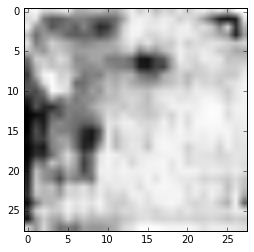

('Estimate:', array([[-5.24120998]], dtype=float32))
('Iteration:', 18200, 'at', datetime.datetime(2017, 7, 7, 14, 1, 36, 266553))


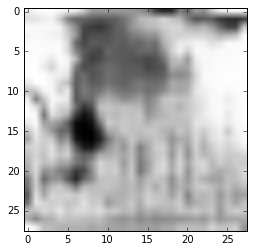

('Estimate:', array([[-1.78518414]], dtype=float32))
('Iteration:', 18300, 'at', datetime.datetime(2017, 7, 7, 14, 1, 40, 3530))


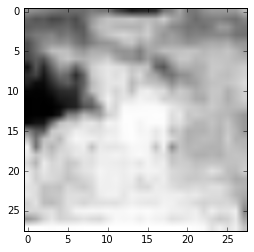

('Estimate:', array([[-2.42518902]], dtype=float32))
('Iteration:', 18400, 'at', datetime.datetime(2017, 7, 7, 14, 1, 44, 903042))


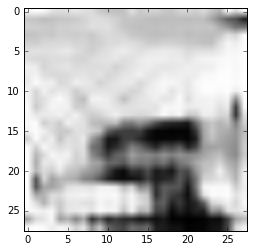

('Estimate:', array([[ 2.56251073]], dtype=float32))
('Iteration:', 18500, 'at', datetime.datetime(2017, 7, 7, 14, 1, 48, 736743))


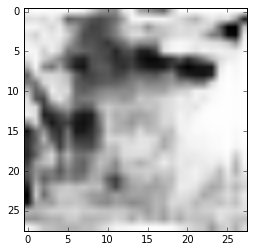

('Estimate:', array([[ 1.3600105]], dtype=float32))
('Iteration:', 18600, 'at', datetime.datetime(2017, 7, 7, 14, 1, 52, 312918))


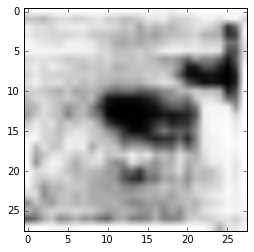

('Estimate:', array([[-0.90677321]], dtype=float32))
('Iteration:', 18700, 'at', datetime.datetime(2017, 7, 7, 14, 1, 56, 33326))


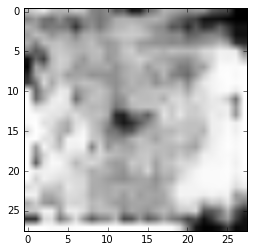

('Estimate:', array([[ 1.365821]], dtype=float32))
('Iteration:', 18800, 'at', datetime.datetime(2017, 7, 7, 14, 1, 59, 694367))


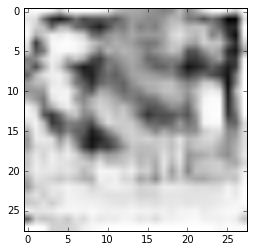

('Estimate:', array([[-0.14658517]], dtype=float32))
('Iteration:', 18900, 'at', datetime.datetime(2017, 7, 7, 14, 2, 3, 280892))


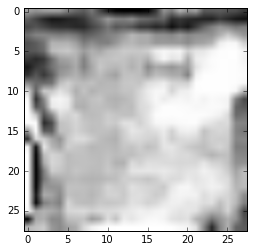

('Estimate:', array([[ 3.20921803]], dtype=float32))
('Iteration:', 19000, 'at', datetime.datetime(2017, 7, 7, 14, 2, 6, 991416))


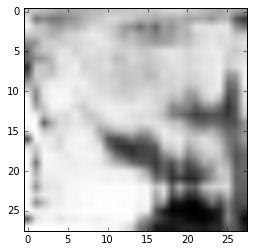

('Estimate:', array([[-6.04375267]], dtype=float32))
('Iteration:', 19100, 'at', datetime.datetime(2017, 7, 7, 14, 2, 10, 719264))


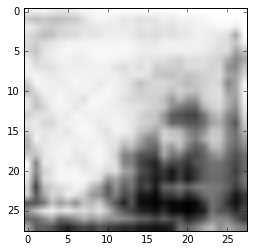

('Estimate:', array([[ 2.68899322]], dtype=float32))
('Iteration:', 19200, 'at', datetime.datetime(2017, 7, 7, 14, 2, 14, 398245))


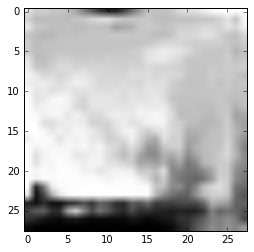

('Estimate:', array([[-0.7325834]], dtype=float32))
('Iteration:', 19300, 'at', datetime.datetime(2017, 7, 7, 14, 2, 19, 970396))


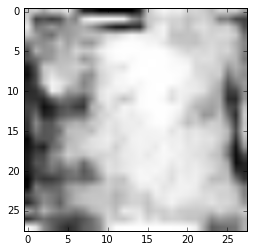

('Estimate:', array([[ 2.95418954]], dtype=float32))
('Iteration:', 19400, 'at', datetime.datetime(2017, 7, 7, 14, 2, 23, 708312))


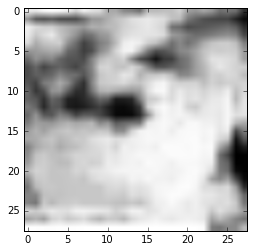

('Estimate:', array([[ 3.78593493]], dtype=float32))
('Iteration:', 19500, 'at', datetime.datetime(2017, 7, 7, 14, 2, 27, 524197))


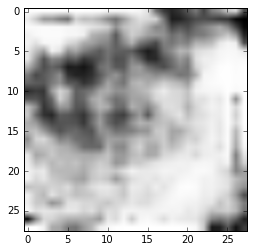

('Estimate:', array([[ 6.9560833]], dtype=float32))
('Iteration:', 19600, 'at', datetime.datetime(2017, 7, 7, 14, 2, 31, 388888))


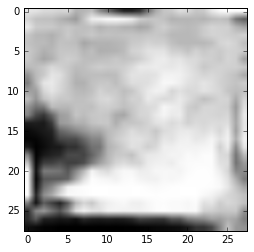

('Estimate:', array([[ 3.32819128]], dtype=float32))
('Iteration:', 19700, 'at', datetime.datetime(2017, 7, 7, 14, 2, 35, 32072))


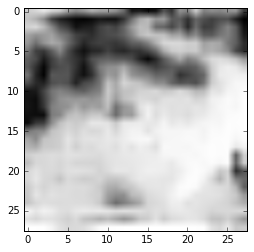

('Estimate:', array([[-3.21854877]], dtype=float32))
('Iteration:', 19800, 'at', datetime.datetime(2017, 7, 7, 14, 2, 38, 843460))


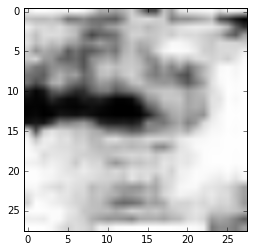

('Estimate:', array([[ 1.15257323]], dtype=float32))
('Iteration:', 19900, 'at', datetime.datetime(2017, 7, 7, 14, 2, 42, 505973))


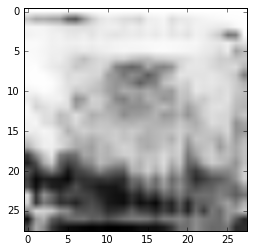

('Estimate:', array([[ 0.38960722]], dtype=float32))
('Iteration:', 20000, 'at', datetime.datetime(2017, 7, 7, 14, 2, 46, 328441))


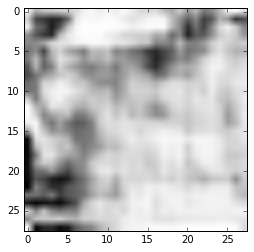

('Estimate:', array([[-8.14580441]], dtype=float32))
('Iteration:', 20100, 'at', datetime.datetime(2017, 7, 7, 14, 2, 50, 194385))


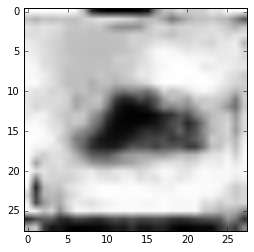

('Estimate:', array([[ 4.90235615]], dtype=float32))
('Iteration:', 20200, 'at', datetime.datetime(2017, 7, 7, 14, 2, 54, 923171))


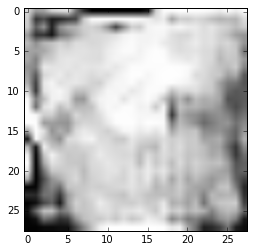

('Estimate:', array([[-2.12609553]], dtype=float32))
('Iteration:', 20300, 'at', datetime.datetime(2017, 7, 7, 14, 2, 58, 727178))


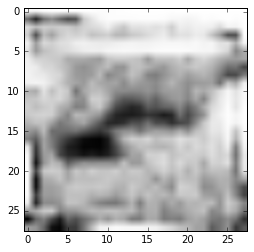

('Estimate:', array([[ 3.69468451]], dtype=float32))
('Iteration:', 20400, 'at', datetime.datetime(2017, 7, 7, 14, 3, 2, 310131))


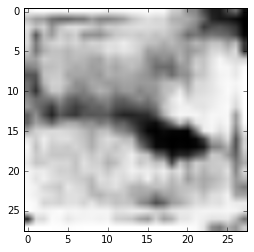

('Estimate:', array([[-1.93102777]], dtype=float32))
('Iteration:', 20500, 'at', datetime.datetime(2017, 7, 7, 14, 3, 6, 184089))


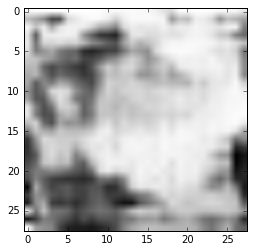

('Estimate:', array([[ 0.00090156]], dtype=float32))
('Iteration:', 20600, 'at', datetime.datetime(2017, 7, 7, 14, 3, 10, 35394))


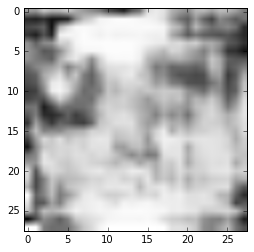

('Estimate:', array([[-4.07315302]], dtype=float32))
('Iteration:', 20700, 'at', datetime.datetime(2017, 7, 7, 14, 3, 13, 812365))


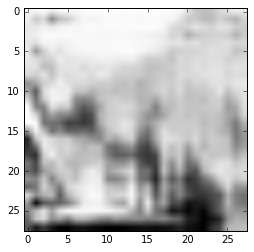

('Estimate:', array([[-0.56701279]], dtype=float32))
('Iteration:', 20800, 'at', datetime.datetime(2017, 7, 7, 14, 3, 17, 521447))


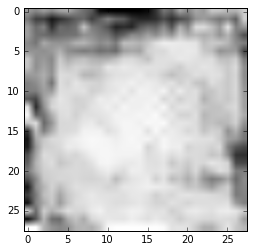

('Estimate:', array([[ 32.58568573]], dtype=float32))
('Iteration:', 20900, 'at', datetime.datetime(2017, 7, 7, 14, 3, 21, 437926))


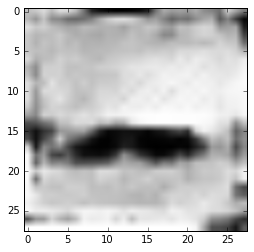

('Estimate:', array([[-13.42488766]], dtype=float32))
('Iteration:', 21000, 'at', datetime.datetime(2017, 7, 7, 14, 3, 25, 207670))


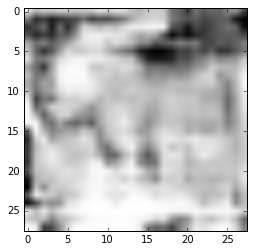

('Estimate:', array([[-6.62679958]], dtype=float32))
('Iteration:', 21100, 'at', datetime.datetime(2017, 7, 7, 14, 3, 30, 529423))


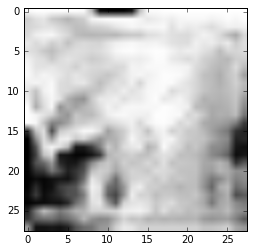

('Estimate:', array([[ 8.7797184]], dtype=float32))
('Iteration:', 21200, 'at', datetime.datetime(2017, 7, 7, 14, 3, 34, 212884))


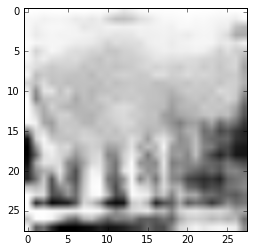

('Estimate:', array([[ 11.14629173]], dtype=float32))
('Iteration:', 21300, 'at', datetime.datetime(2017, 7, 7, 14, 3, 38, 120597))


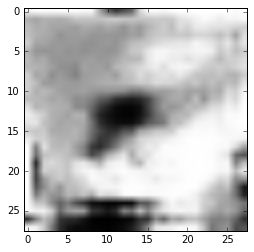

('Estimate:', array([[ 6.03716993]], dtype=float32))
('Iteration:', 21400, 'at', datetime.datetime(2017, 7, 7, 14, 3, 41, 912927))


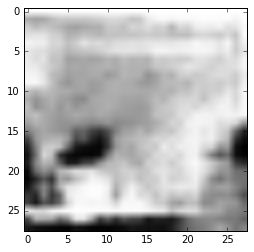

('Estimate:', array([[ 0.3816143]], dtype=float32))
('Iteration:', 21500, 'at', datetime.datetime(2017, 7, 7, 14, 3, 45, 899490))


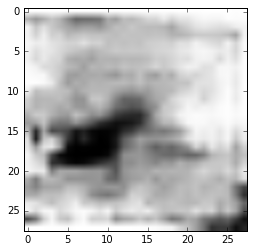

('Estimate:', array([[-4.17595291]], dtype=float32))
('Iteration:', 21600, 'at', datetime.datetime(2017, 7, 7, 14, 3, 49, 926384))


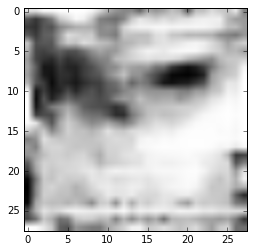

('Estimate:', array([[ 8.17632771]], dtype=float32))
('Iteration:', 21700, 'at', datetime.datetime(2017, 7, 7, 14, 3, 53, 748745))


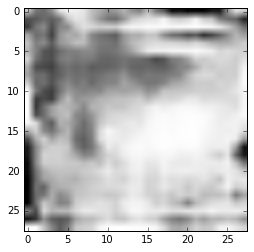

('Estimate:', array([[ 1.34085131]], dtype=float32))
('Iteration:', 21800, 'at', datetime.datetime(2017, 7, 7, 14, 3, 57, 690048))


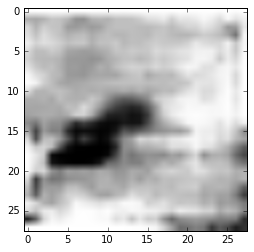

('Estimate:', array([[-1.16042364]], dtype=float32))
('Iteration:', 21900, 'at', datetime.datetime(2017, 7, 7, 14, 4, 1, 589620))


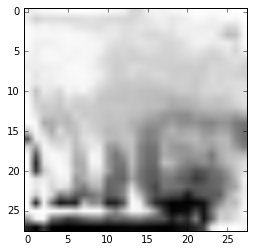

('Estimate:', array([[ 2.53072]], dtype=float32))
('Iteration:', 22000, 'at', datetime.datetime(2017, 7, 7, 14, 4, 6, 550971))


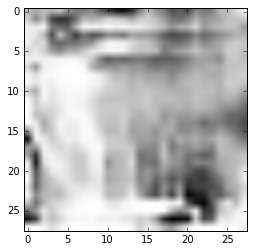

('Estimate:', array([[-2.92992783]], dtype=float32))
('Iteration:', 22100, 'at', datetime.datetime(2017, 7, 7, 14, 4, 10, 326468))


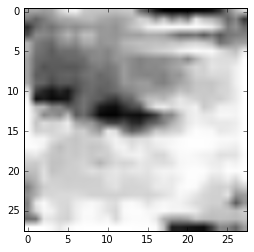

('Estimate:', array([[ 2.18176389]], dtype=float32))
('Iteration:', 22200, 'at', datetime.datetime(2017, 7, 7, 14, 4, 14, 164882))


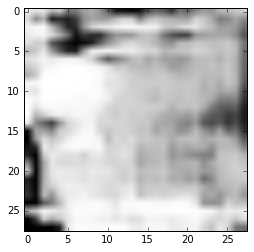

('Estimate:', array([[-6.46939898]], dtype=float32))
('Iteration:', 22300, 'at', datetime.datetime(2017, 7, 7, 14, 4, 18, 87388))


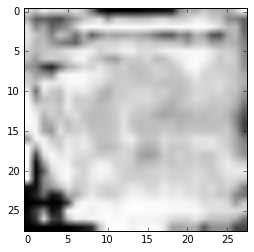

('Estimate:', array([[-10.77684975]], dtype=float32))
('Iteration:', 22400, 'at', datetime.datetime(2017, 7, 7, 14, 4, 22, 11220))


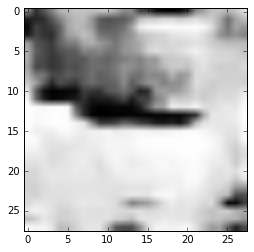

('Estimate:', array([[ 18.15860176]], dtype=float32))
('Iteration:', 22500, 'at', datetime.datetime(2017, 7, 7, 14, 4, 25, 832606))


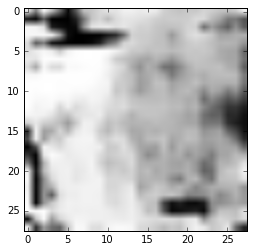

('Estimate:', array([[ 13.15680885]], dtype=float32))
('Iteration:', 22600, 'at', datetime.datetime(2017, 7, 7, 14, 4, 30, 954458))


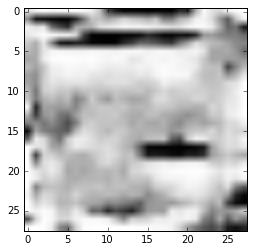

('Estimate:', array([[-9.81197453]], dtype=float32))
('Iteration:', 22700, 'at', datetime.datetime(2017, 7, 7, 14, 4, 34, 850442))


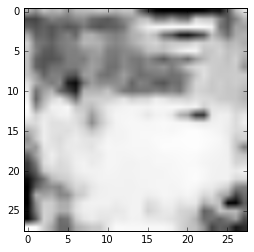

('Estimate:', array([[-4.09339714]], dtype=float32))
('Iteration:', 22800, 'at', datetime.datetime(2017, 7, 7, 14, 4, 38, 799581))


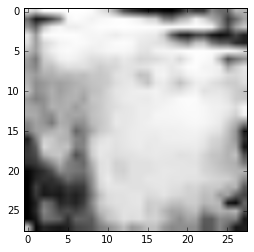

('Estimate:', array([[-8.06452465]], dtype=float32))
('Iteration:', 22900, 'at', datetime.datetime(2017, 7, 7, 14, 4, 43, 953170))


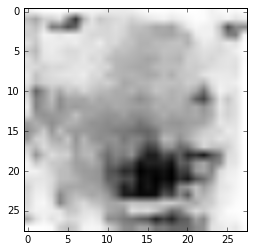

('Estimate:', array([[ 10.56869698]], dtype=float32))
('Iteration:', 23000, 'at', datetime.datetime(2017, 7, 7, 14, 4, 47, 953354))


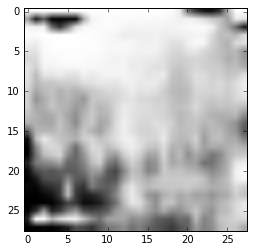

('Estimate:', array([[ 7.64821672]], dtype=float32))
('Iteration:', 23100, 'at', datetime.datetime(2017, 7, 7, 14, 4, 51, 850320))


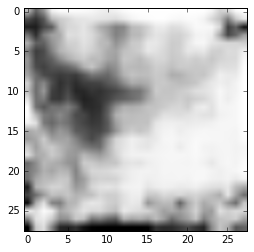

('Estimate:', array([[ 0.23619412]], dtype=float32))
('Iteration:', 23200, 'at', datetime.datetime(2017, 7, 7, 14, 4, 55, 707868))


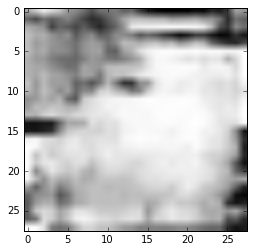

('Estimate:', array([[-1.59321845]], dtype=float32))
('Iteration:', 23300, 'at', datetime.datetime(2017, 7, 7, 14, 4, 59, 456068))


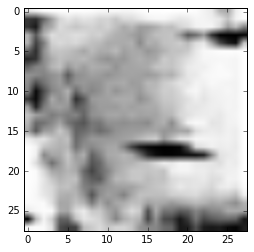

('Estimate:', array([[ 10.32017517]], dtype=float32))
('Iteration:', 23400, 'at', datetime.datetime(2017, 7, 7, 14, 5, 3, 538872))


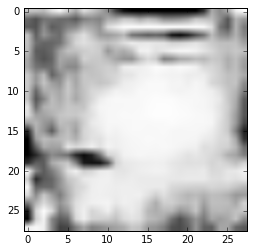

('Estimate:', array([[ 1.6808635]], dtype=float32))
('Iteration:', 23500, 'at', datetime.datetime(2017, 7, 7, 14, 5, 7, 774734))


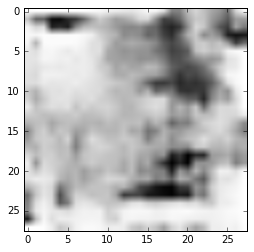

('Estimate:', array([[-1.88141966]], dtype=float32))
('Iteration:', 23600, 'at', datetime.datetime(2017, 7, 7, 14, 5, 11, 658336))


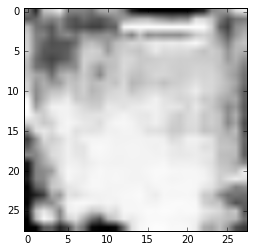

('Estimate:', array([[-5.47708511]], dtype=float32))
('Iteration:', 23700, 'at', datetime.datetime(2017, 7, 7, 14, 5, 15, 544903))


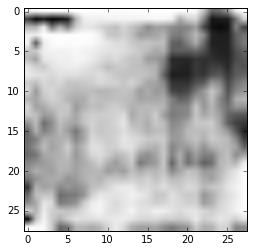

('Estimate:', array([[ 17.95666122]], dtype=float32))
('Iteration:', 23800, 'at', datetime.datetime(2017, 7, 7, 14, 5, 20, 779957))


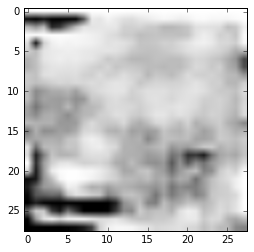

('Estimate:', array([[ 17.55520058]], dtype=float32))
('Iteration:', 23900, 'at', datetime.datetime(2017, 7, 7, 14, 5, 24, 798117))


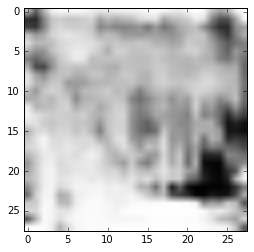

('Estimate:', array([[ 16.66884804]], dtype=float32))
('Iteration:', 24000, 'at', datetime.datetime(2017, 7, 7, 14, 5, 28, 960767))


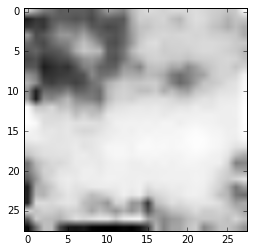

('Estimate:', array([[ 8.52253056]], dtype=float32))
('Iteration:', 24100, 'at', datetime.datetime(2017, 7, 7, 14, 5, 32, 785071))


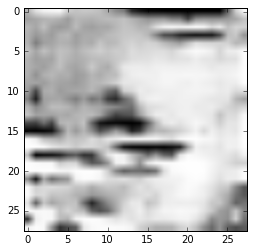

('Estimate:', array([[-16.3732338]], dtype=float32))
('Iteration:', 24200, 'at', datetime.datetime(2017, 7, 7, 14, 5, 36, 928884))


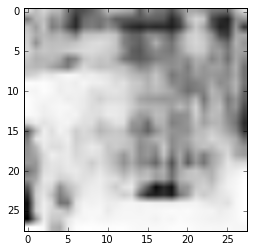

('Estimate:', array([[ 2.66411781]], dtype=float32))
('Iteration:', 24300, 'at', datetime.datetime(2017, 7, 7, 14, 5, 40, 885785))


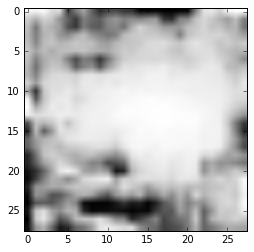

('Estimate:', array([[-4.26699638]], dtype=float32))
('Iteration:', 24400, 'at', datetime.datetime(2017, 7, 7, 14, 5, 44, 755890))


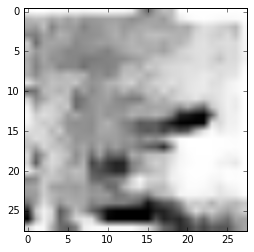

('Estimate:', array([[ 11.30018902]], dtype=float32))
('Iteration:', 24500, 'at', datetime.datetime(2017, 7, 7, 14, 5, 49, 97224))


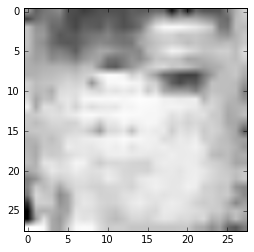

('Estimate:', array([[-9.69197273]], dtype=float32))
('Iteration:', 24600, 'at', datetime.datetime(2017, 7, 7, 14, 5, 52, 758840))


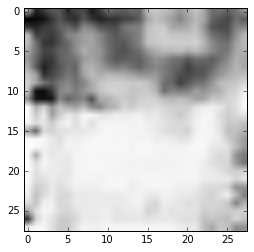

('Estimate:', array([[-0.58733404]], dtype=float32))
('Iteration:', 24700, 'at', datetime.datetime(2017, 7, 7, 14, 5, 57, 475323))


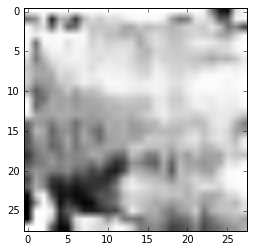

('Estimate:', array([[ 7.68776035]], dtype=float32))
('Iteration:', 24800, 'at', datetime.datetime(2017, 7, 7, 14, 6, 1, 532824))


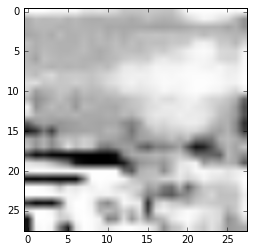

('Estimate:', array([[ 4.80498791]], dtype=float32))
('Iteration:', 24900, 'at', datetime.datetime(2017, 7, 7, 14, 6, 5, 271437))


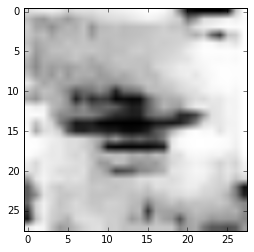

('Estimate:', array([[-3.47305346]], dtype=float32))
('Iteration:', 25000, 'at', datetime.datetime(2017, 7, 7, 14, 6, 9, 372338))


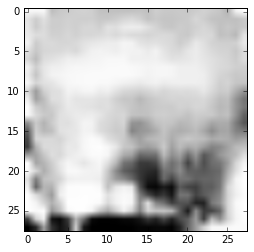

('Estimate:', array([[-21.7813015]], dtype=float32))
('Iteration:', 25100, 'at', datetime.datetime(2017, 7, 7, 14, 6, 13, 280320))


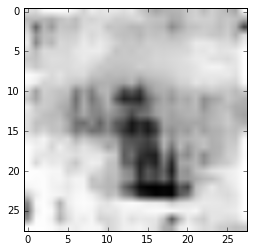

('Estimate:', array([[ 0.86594158]], dtype=float32))
('Iteration:', 25200, 'at', datetime.datetime(2017, 7, 7, 14, 6, 17, 148483))


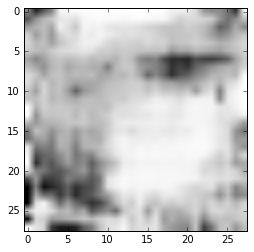

('Estimate:', array([[ 7.3759532]], dtype=float32))
('Iteration:', 25300, 'at', datetime.datetime(2017, 7, 7, 14, 6, 21, 58385))


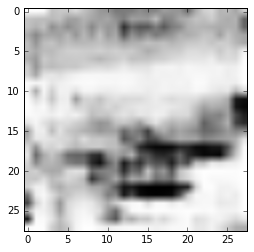

('Estimate:', array([[ 2.66676521]], dtype=float32))
('Iteration:', 25400, 'at', datetime.datetime(2017, 7, 7, 14, 6, 25, 26167))


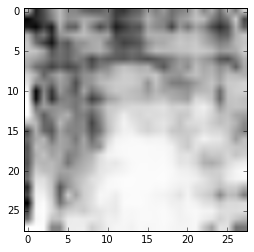

('Estimate:', array([[-0.30963141]], dtype=float32))
('Iteration:', 25500, 'at', datetime.datetime(2017, 7, 7, 14, 6, 29, 110068))


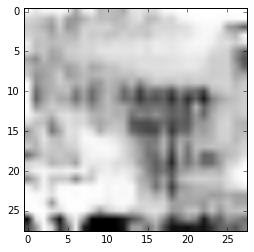

('Estimate:', array([[ 2.85115623]], dtype=float32))
('Iteration:', 25600, 'at', datetime.datetime(2017, 7, 7, 14, 6, 34, 312951))


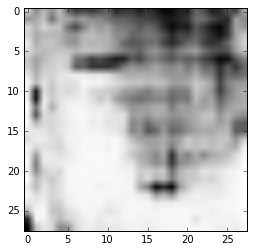

('Estimate:', array([[-1.63734114]], dtype=float32))
('Iteration:', 25700, 'at', datetime.datetime(2017, 7, 7, 14, 6, 38, 258482))


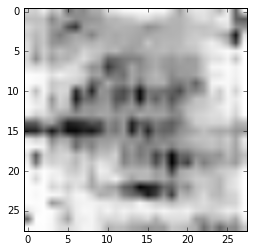

('Estimate:', array([[ 1.82248592]], dtype=float32))
('Iteration:', 25800, 'at', datetime.datetime(2017, 7, 7, 14, 6, 42, 185585))


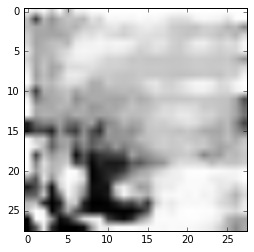

('Estimate:', array([[ 2.97336817]], dtype=float32))
('Iteration:', 25900, 'at', datetime.datetime(2017, 7, 7, 14, 6, 46, 80266))


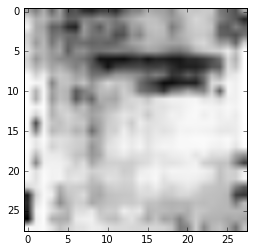

('Estimate:', array([[ 3.76739407]], dtype=float32))
('Iteration:', 26000, 'at', datetime.datetime(2017, 7, 7, 14, 6, 50, 76137))


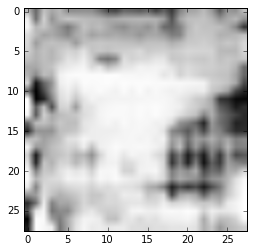

('Estimate:', array([[ 2.7989192]], dtype=float32))
('Iteration:', 26100, 'at', datetime.datetime(2017, 7, 7, 14, 6, 54, 30959))


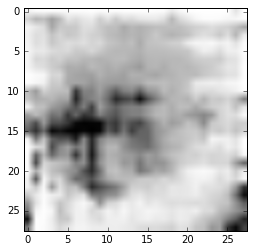

('Estimate:', array([[-0.22048546]], dtype=float32))
('Iteration:', 26200, 'at', datetime.datetime(2017, 7, 7, 14, 6, 57, 922367))


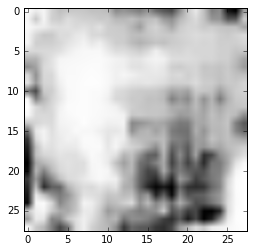

('Estimate:', array([[-5.66911364]], dtype=float32))
('Iteration:', 26300, 'at', datetime.datetime(2017, 7, 7, 14, 7, 2, 569580))


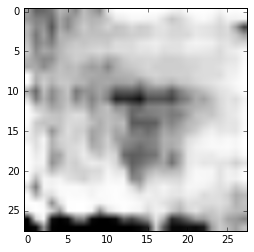

('Estimate:', array([[ 18.02397537]], dtype=float32))
('Iteration:', 26400, 'at', datetime.datetime(2017, 7, 7, 14, 7, 6, 795220))


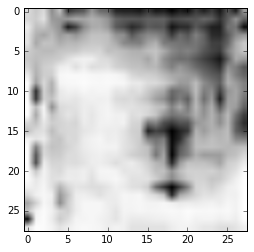

('Estimate:', array([[ 4.53112984]], dtype=float32))
('Iteration:', 26500, 'at', datetime.datetime(2017, 7, 7, 14, 7, 11, 983701))


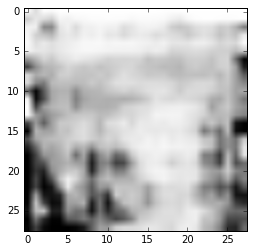

('Estimate:', array([[ 9.08470535]], dtype=float32))
('Iteration:', 26600, 'at', datetime.datetime(2017, 7, 7, 14, 7, 15, 970265))


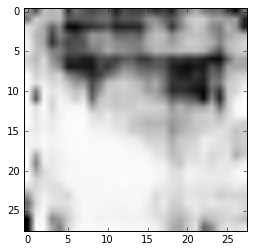

('Estimate:', array([[-0.77968383]], dtype=float32))
('Iteration:', 26700, 'at', datetime.datetime(2017, 7, 7, 14, 7, 20, 62301))


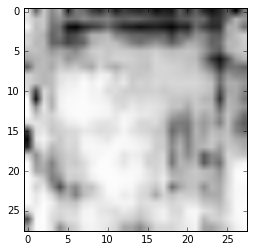

('Estimate:', array([[-11.313797]], dtype=float32))
('Iteration:', 26800, 'at', datetime.datetime(2017, 7, 7, 14, 7, 24, 109088))


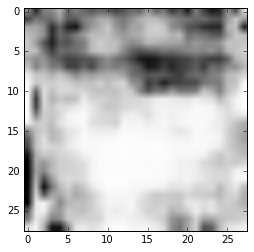

('Estimate:', array([[-4.40891838]], dtype=float32))
('Iteration:', 26900, 'at', datetime.datetime(2017, 7, 7, 14, 7, 28, 379828))


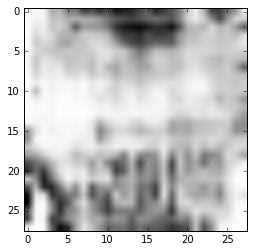

('Estimate:', array([[ 7.91688919]], dtype=float32))
('Iteration:', 27000, 'at', datetime.datetime(2017, 7, 7, 14, 7, 32, 309366))


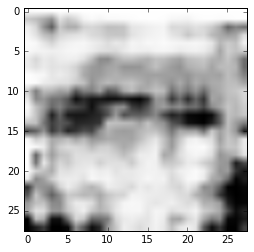

('Estimate:', array([[ 1.3849895]], dtype=float32))
('Iteration:', 27100, 'at', datetime.datetime(2017, 7, 7, 14, 7, 36, 373009))


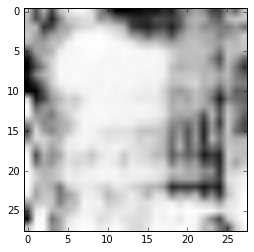

('Estimate:', array([[-15.20477962]], dtype=float32))
('Iteration:', 27200, 'at', datetime.datetime(2017, 7, 7, 14, 7, 40, 646728))


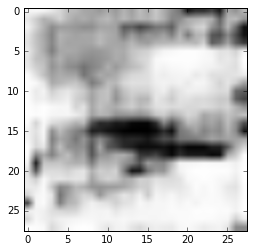

('Estimate:', array([[ 0.53001732]], dtype=float32))
('Iteration:', 27300, 'at', datetime.datetime(2017, 7, 7, 14, 7, 44, 685746))


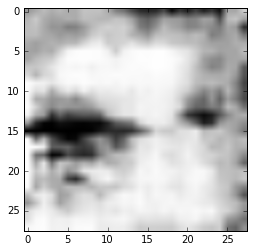

('Estimate:', array([[ 3.28497291]], dtype=float32))
('Iteration:', 27400, 'at', datetime.datetime(2017, 7, 7, 14, 7, 49, 992535))


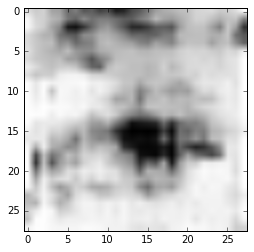

('Estimate:', array([[-0.21600389]], dtype=float32))
('Iteration:', 27500, 'at', datetime.datetime(2017, 7, 7, 14, 7, 53, 894076))


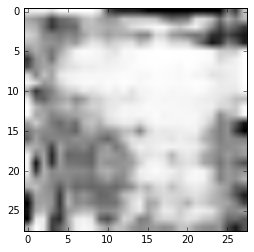

('Estimate:', array([[-31.98971176]], dtype=float32))
('Iteration:', 27600, 'at', datetime.datetime(2017, 7, 7, 14, 7, 57, 891571))


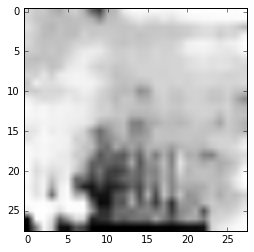

('Estimate:', array([[-0.2762073]], dtype=float32))
('Iteration:', 27700, 'at', datetime.datetime(2017, 7, 7, 14, 8, 1, 994445))


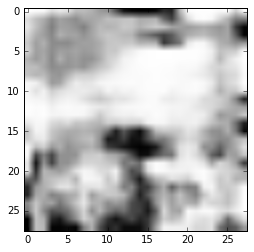

('Estimate:', array([[-2.1553154]], dtype=float32))
('Iteration:', 27800, 'at', datetime.datetime(2017, 7, 7, 14, 8, 6, 85308))


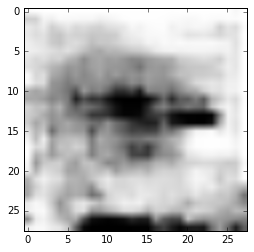

('Estimate:', array([[ 4.28289652]], dtype=float32))
('Iteration:', 27900, 'at', datetime.datetime(2017, 7, 7, 14, 8, 10, 261467))


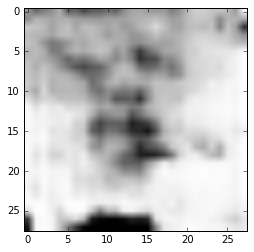

('Estimate:', array([[ 2.21459126]], dtype=float32))
('Iteration:', 28000, 'at', datetime.datetime(2017, 7, 7, 14, 8, 14, 257602))


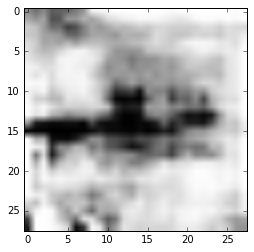

('Estimate:', array([[ 18.02839661]], dtype=float32))
('Iteration:', 28100, 'at', datetime.datetime(2017, 7, 7, 14, 8, 18, 448424))


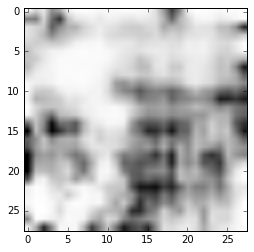

('Estimate:', array([[-10.02112103]], dtype=float32))
('Iteration:', 28200, 'at', datetime.datetime(2017, 7, 7, 14, 8, 23, 52240))


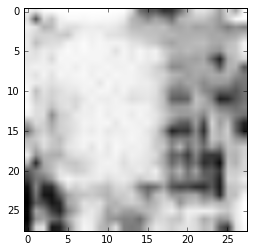

('Estimate:', array([[-6.44268847]], dtype=float32))
('Iteration:', 28300, 'at', datetime.datetime(2017, 7, 7, 14, 8, 28, 368365))


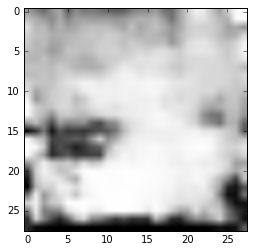

('Estimate:', array([[ 15.56426907]], dtype=float32))
('Iteration:', 28400, 'at', datetime.datetime(2017, 7, 7, 14, 8, 32, 368331))


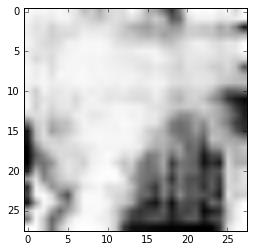

('Estimate:', array([[ 13.93025684]], dtype=float32))
('Iteration:', 28500, 'at', datetime.datetime(2017, 7, 7, 14, 8, 36, 561124))


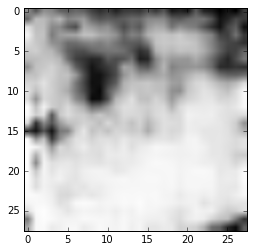

('Estimate:', array([[ 3.87769866]], dtype=float32))
('Iteration:', 28600, 'at', datetime.datetime(2017, 7, 7, 14, 8, 40, 633817))


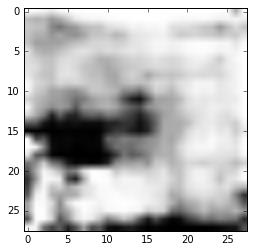

('Estimate:', array([[-0.70658737]], dtype=float32))
('Iteration:', 28700, 'at', datetime.datetime(2017, 7, 7, 14, 8, 44, 578687))


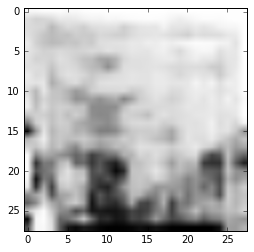

('Estimate:', array([[-2.76208138]], dtype=float32))
('Iteration:', 28800, 'at', datetime.datetime(2017, 7, 7, 14, 8, 48, 834102))


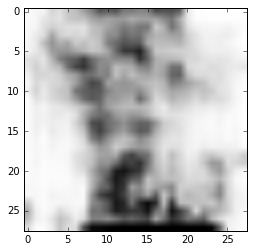

('Estimate:', array([[-5.59196281]], dtype=float32))
('Iteration:', 28900, 'at', datetime.datetime(2017, 7, 7, 14, 8, 52, 683197))


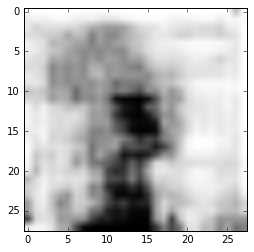

('Estimate:', array([[-2.53531957]], dtype=float32))
('Iteration:', 29000, 'at', datetime.datetime(2017, 7, 7, 14, 8, 56, 806867))


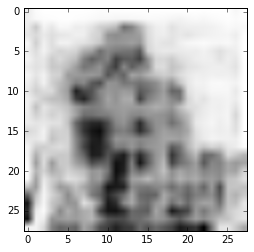

('Estimate:', array([[-5.39810848]], dtype=float32))
('Iteration:', 29100, 'at', datetime.datetime(2017, 7, 7, 14, 9, 0, 759051))


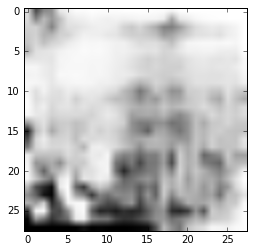

('Estimate:', array([[-1.8544035]], dtype=float32))
('Iteration:', 29200, 'at', datetime.datetime(2017, 7, 7, 14, 9, 6, 41510))


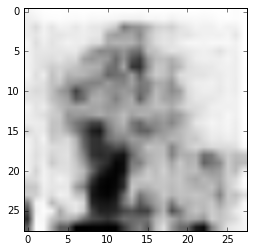

('Estimate:', array([[ 16.91792488]], dtype=float32))
('Iteration:', 29300, 'at', datetime.datetime(2017, 7, 7, 14, 9, 10, 482248))


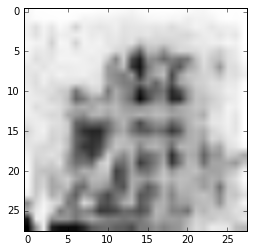

('Estimate:', array([[-3.11655211]], dtype=float32))
('Iteration:', 29400, 'at', datetime.datetime(2017, 7, 7, 14, 9, 14, 928460))


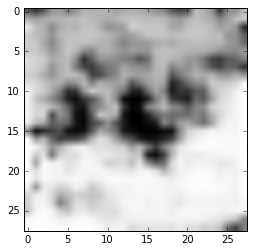

('Estimate:', array([[ 2.5825727]], dtype=float32))
('Iteration:', 29500, 'at', datetime.datetime(2017, 7, 7, 14, 9, 19, 64011))


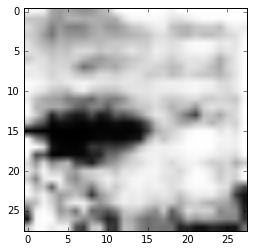

('Estimate:', array([[-4.41275024]], dtype=float32))
('Iteration:', 29600, 'at', datetime.datetime(2017, 7, 7, 14, 9, 23, 239678))


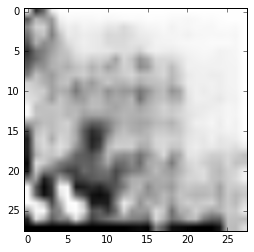

('Estimate:', array([[-14.94961739]], dtype=float32))
('Iteration:', 29700, 'at', datetime.datetime(2017, 7, 7, 14, 9, 27, 820198))


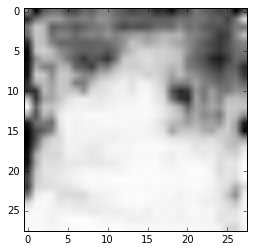

('Estimate:', array([[-4.52961397]], dtype=float32))
('Iteration:', 29800, 'at', datetime.datetime(2017, 7, 7, 14, 9, 32, 16162))


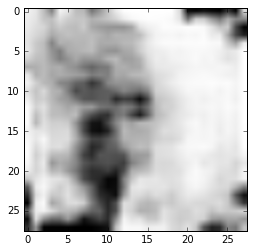

('Estimate:', array([[ 8.15668488]], dtype=float32))
('Iteration:', 29900, 'at', datetime.datetime(2017, 7, 7, 14, 9, 36, 300685))


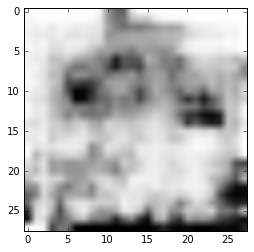

('Estimate:', array([[ 0.87610608]], dtype=float32))
('Iteration:', 30000, 'at', datetime.datetime(2017, 7, 7, 14, 9, 40, 498448))


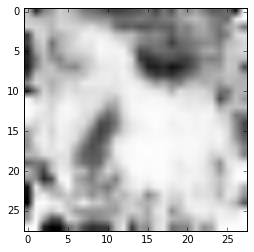

('Estimate:', array([[ 0.87196487]], dtype=float32))
('Iteration:', 30100, 'at', datetime.datetime(2017, 7, 7, 14, 9, 46, 541805))


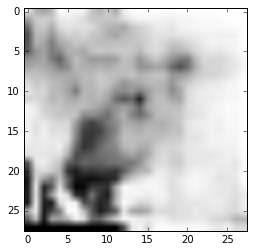

('Estimate:', array([[ 3.98159623]], dtype=float32))
('Iteration:', 30200, 'at', datetime.datetime(2017, 7, 7, 14, 9, 50, 736049))


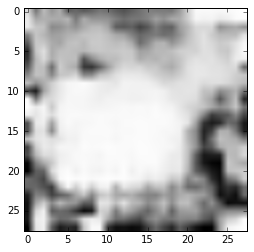

('Estimate:', array([[ 0.53863806]], dtype=float32))
('Iteration:', 30300, 'at', datetime.datetime(2017, 7, 7, 14, 9, 54, 959014))


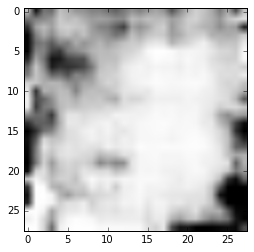

('Estimate:', array([[-0.8170287]], dtype=float32))
('Iteration:', 30400, 'at', datetime.datetime(2017, 7, 7, 14, 9, 59, 89988))


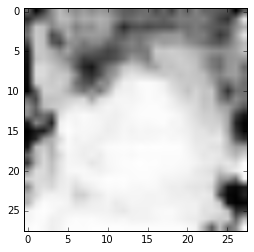

('Estimate:', array([[ 1.82388484]], dtype=float32))
('Iteration:', 30500, 'at', datetime.datetime(2017, 7, 7, 14, 10, 4, 68288))


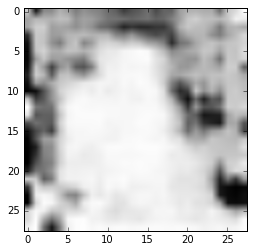

('Estimate:', array([[ 0.96802765]], dtype=float32))
('Iteration:', 30600, 'at', datetime.datetime(2017, 7, 7, 14, 10, 8, 901969))


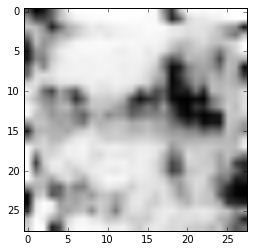

('Estimate:', array([[ 2.07762551]], dtype=float32))
('Iteration:', 30700, 'at', datetime.datetime(2017, 7, 7, 14, 10, 13, 157355))


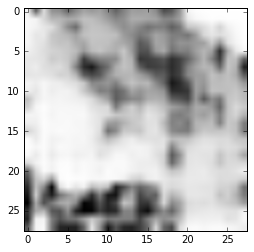

('Estimate:', array([[ 0.53529119]], dtype=float32))
('Iteration:', 30800, 'at', datetime.datetime(2017, 7, 7, 14, 10, 17, 439324))


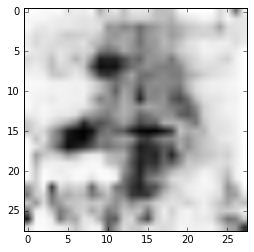

('Estimate:', array([[-3.53375721]], dtype=float32))
('Iteration:', 30900, 'at', datetime.datetime(2017, 7, 7, 14, 10, 21, 809809))


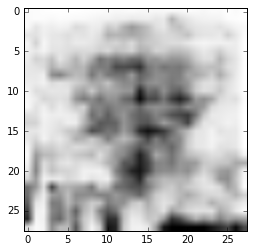

('Estimate:', array([[-10.10689831]], dtype=float32))
('Iteration:', 31000, 'at', datetime.datetime(2017, 7, 7, 14, 10, 27, 223610))


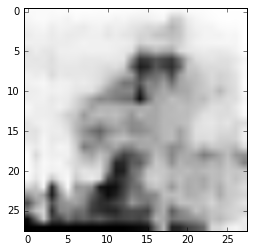

('Estimate:', array([[-2.49813294]], dtype=float32))
('Iteration:', 31100, 'at', datetime.datetime(2017, 7, 7, 14, 10, 31, 622830))


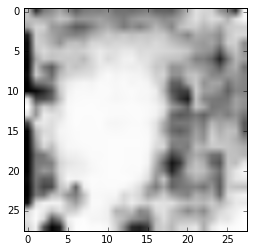

('Estimate:', array([[-6.51283503]], dtype=float32))
('Iteration:', 31200, 'at', datetime.datetime(2017, 7, 7, 14, 10, 35, 964301))


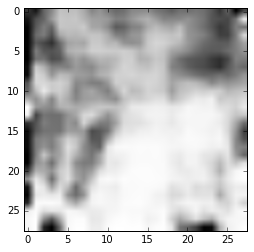

('Estimate:', array([[-2.07558322]], dtype=float32))
('Iteration:', 31300, 'at', datetime.datetime(2017, 7, 7, 14, 10, 40, 427936))


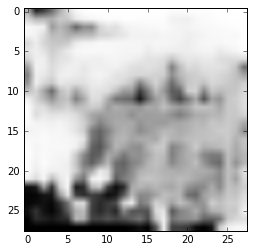

('Estimate:', array([[ 4.87488747]], dtype=float32))
('Iteration:', 31400, 'at', datetime.datetime(2017, 7, 7, 14, 10, 44, 913768))


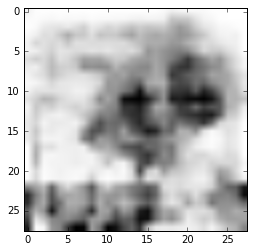

('Estimate:', array([[ 3.40086389]], dtype=float32))
('Iteration:', 31500, 'at', datetime.datetime(2017, 7, 7, 14, 10, 49, 606643))


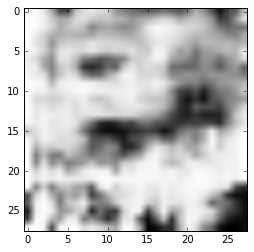

('Estimate:', array([[ 0.33679935]], dtype=float32))
('Iteration:', 31600, 'at', datetime.datetime(2017, 7, 7, 14, 10, 54, 75322))


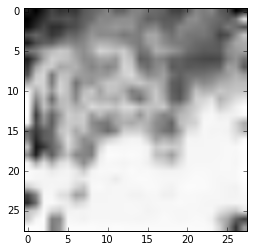

('Estimate:', array([[-19.65484428]], dtype=float32))
('Iteration:', 31700, 'at', datetime.datetime(2017, 7, 7, 14, 10, 58, 451808))


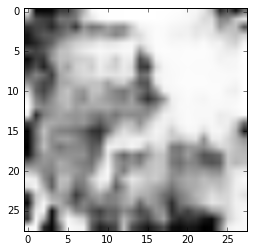

('Estimate:', array([[-6.25723028]], dtype=float32))
('Iteration:', 31800, 'at', datetime.datetime(2017, 7, 7, 14, 11, 2, 729893))


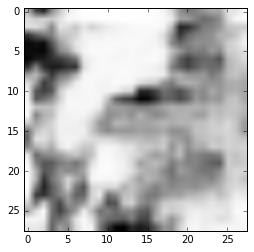

('Estimate:', array([[ 19.76457405]], dtype=float32))
('Iteration:', 31900, 'at', datetime.datetime(2017, 7, 7, 14, 11, 8, 163177))


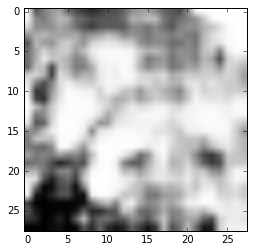

('Estimate:', array([[-4.42196989]], dtype=float32))
('Iteration:', 32000, 'at', datetime.datetime(2017, 7, 7, 14, 11, 12, 386157))


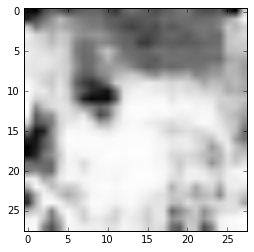

('Estimate:', array([[ 2.56159568]], dtype=float32))
('Iteration:', 32100, 'at', datetime.datetime(2017, 7, 7, 14, 11, 16, 726495))


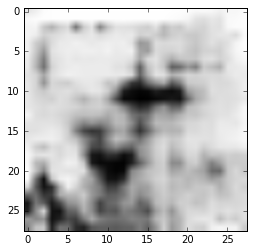

('Estimate:', array([[-16.86298943]], dtype=float32))
('Iteration:', 32200, 'at', datetime.datetime(2017, 7, 7, 14, 11, 20, 957614))


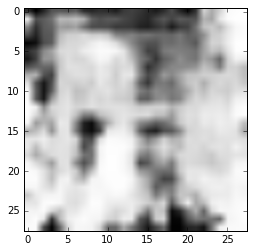

('Estimate:', array([[ 12.0495224]], dtype=float32))
('Iteration:', 32300, 'at', datetime.datetime(2017, 7, 7, 14, 11, 25, 450016))


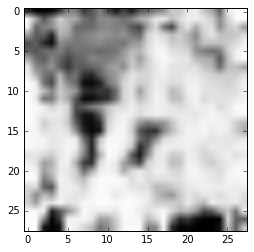

('Estimate:', array([[-1.81161916]], dtype=float32))
('Iteration:', 32400, 'at', datetime.datetime(2017, 7, 7, 14, 11, 30, 178502))


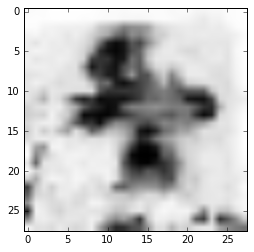

('Estimate:', array([[ 8.86947727]], dtype=float32))
('Iteration:', 32500, 'at', datetime.datetime(2017, 7, 7, 14, 11, 34, 648447))


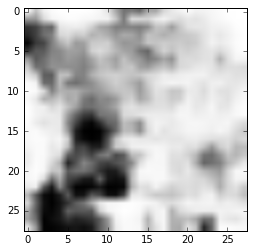

('Estimate:', array([[-9.83364487]], dtype=float32))
('Iteration:', 32600, 'at', datetime.datetime(2017, 7, 7, 14, 11, 39, 45900))


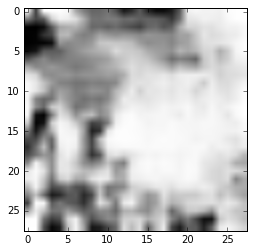

('Estimate:', array([[-7.80208063]], dtype=float32))
('Iteration:', 32700, 'at', datetime.datetime(2017, 7, 7, 14, 11, 43, 377170))


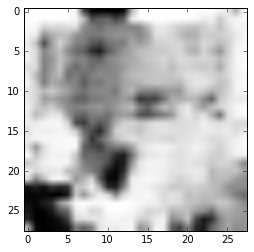

('Estimate:', array([[-5.22170734]], dtype=float32))
('Iteration:', 32800, 'at', datetime.datetime(2017, 7, 7, 14, 11, 48, 682845))


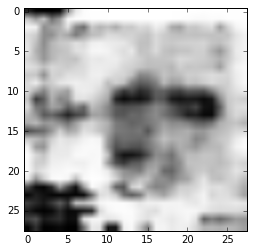

('Estimate:', array([[-14.5424633]], dtype=float32))
('Iteration:', 32900, 'at', datetime.datetime(2017, 7, 7, 14, 11, 53, 89819))


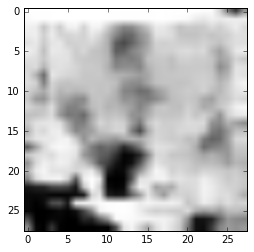

('Estimate:', array([[-3.43081522]], dtype=float32))
('Iteration:', 33000, 'at', datetime.datetime(2017, 7, 7, 14, 11, 57, 350253))


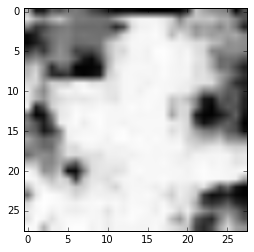

('Estimate:', array([[ 20.86270714]], dtype=float32))
('Iteration:', 33100, 'at', datetime.datetime(2017, 7, 7, 14, 12, 1, 692458))


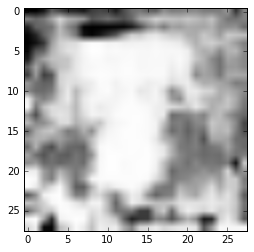

('Estimate:', array([[ 14.8923502]], dtype=float32))
('Iteration:', 33200, 'at', datetime.datetime(2017, 7, 7, 14, 12, 6, 211485))


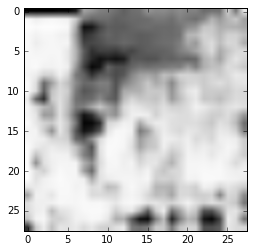

('Estimate:', array([[-35.20855331]], dtype=float32))
('Iteration:', 33300, 'at', datetime.datetime(2017, 7, 7, 14, 12, 10, 951262))


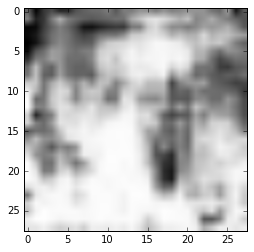

('Estimate:', array([[-8.68749237]], dtype=float32))
('Iteration:', 33400, 'at', datetime.datetime(2017, 7, 7, 14, 12, 15, 418012))


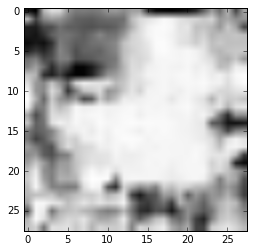

('Estimate:', array([[-4.940485]], dtype=float32))
('Iteration:', 33500, 'at', datetime.datetime(2017, 7, 7, 14, 12, 19, 975736))


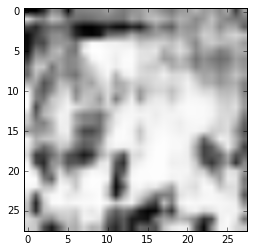

('Estimate:', array([[-28.73754311]], dtype=float32))
('Iteration:', 33600, 'at', datetime.datetime(2017, 7, 7, 14, 12, 24, 345345))


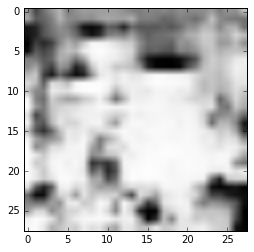

('Estimate:', array([[ 11.8090477]], dtype=float32))
('Iteration:', 33700, 'at', datetime.datetime(2017, 7, 7, 14, 12, 31, 230493))


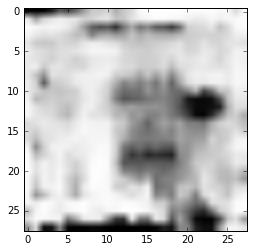

('Estimate:', array([[-1.04761708]], dtype=float32))
('Iteration:', 33800, 'at', datetime.datetime(2017, 7, 7, 14, 12, 35, 707611))


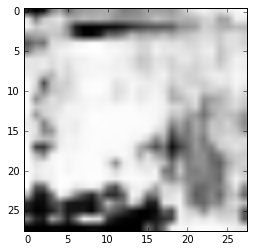

('Estimate:', array([[-7.75870514]], dtype=float32))
('Iteration:', 33900, 'at', datetime.datetime(2017, 7, 7, 14, 12, 40, 271426))


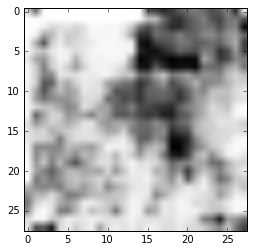

('Estimate:', array([[ 2.75489092]], dtype=float32))
('Iteration:', 34000, 'at', datetime.datetime(2017, 7, 7, 14, 12, 44, 790083))


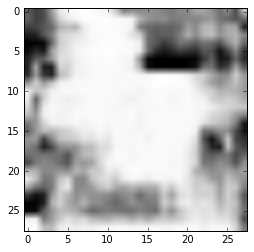

('Estimate:', array([[ 3.13381815]], dtype=float32))
('Iteration:', 34100, 'at', datetime.datetime(2017, 7, 7, 14, 12, 49, 555340))


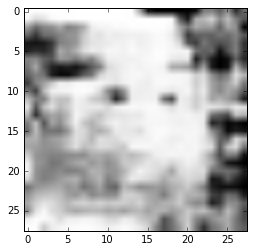

('Estimate:', array([[ 1.62012744]], dtype=float32))
('Iteration:', 34200, 'at', datetime.datetime(2017, 7, 7, 14, 12, 53, 953673))


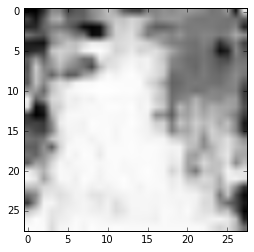

('Estimate:', array([[ 20.98512077]], dtype=float32))
('Iteration:', 34300, 'at', datetime.datetime(2017, 7, 7, 14, 12, 58, 312203))


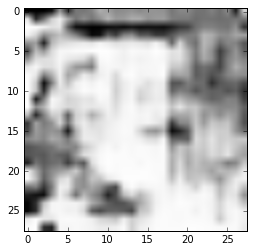

('Estimate:', array([[ 3.07282114]], dtype=float32))
('Iteration:', 34400, 'at', datetime.datetime(2017, 7, 7, 14, 13, 2, 965104))


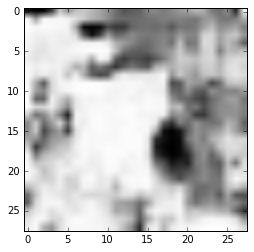

('Estimate:', array([[ 4.46532726]], dtype=float32))
('Iteration:', 34500, 'at', datetime.datetime(2017, 7, 7, 14, 13, 7, 774281))


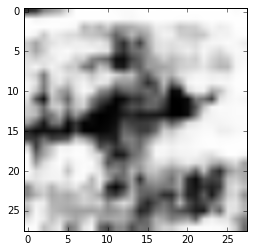

('Estimate:', array([[ 12.41310501]], dtype=float32))
('Iteration:', 34600, 'at', datetime.datetime(2017, 7, 7, 14, 13, 14, 391567))


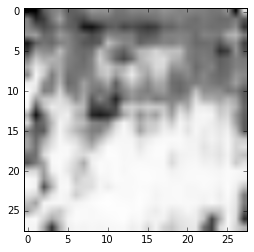

('Estimate:', array([[ 10.25426197]], dtype=float32))
('Iteration:', 34700, 'at', datetime.datetime(2017, 7, 7, 14, 13, 18, 715373))


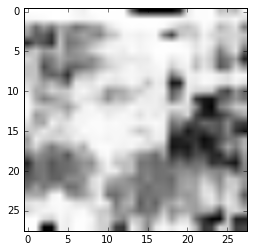

('Estimate:', array([[ 1.36449802]], dtype=float32))
('Iteration:', 34800, 'at', datetime.datetime(2017, 7, 7, 14, 13, 23, 227003))


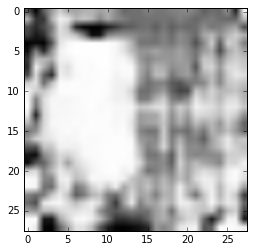

('Estimate:', array([[ 23.29190254]], dtype=float32))
('Iteration:', 34900, 'at', datetime.datetime(2017, 7, 7, 14, 13, 28, 2894))


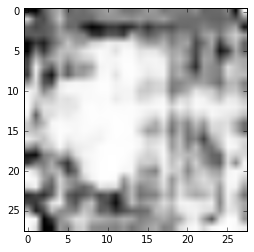

('Estimate:', array([[ 5.01675177]], dtype=float32))
('Iteration:', 35000, 'at', datetime.datetime(2017, 7, 7, 14, 13, 32, 479135))


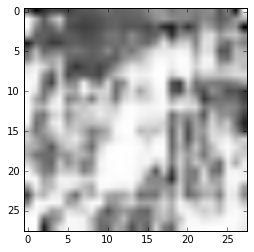

('Estimate:', array([[ 2.69653559]], dtype=float32))
('Iteration:', 35100, 'at', datetime.datetime(2017, 7, 7, 14, 13, 37, 16446))


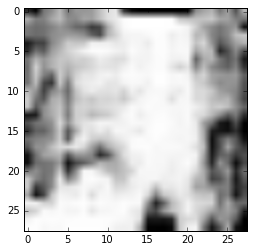

('Estimate:', array([[ 3.41378284]], dtype=float32))
('Iteration:', 35200, 'at', datetime.datetime(2017, 7, 7, 14, 13, 41, 618089))


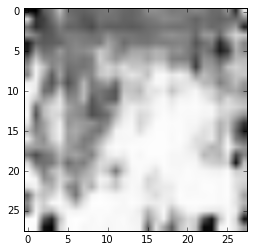

('Estimate:', array([[ 2.15409827]], dtype=float32))
('Iteration:', 35300, 'at', datetime.datetime(2017, 7, 7, 14, 13, 47, 333712))


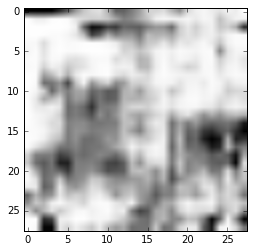

('Estimate:', array([[ 18.81489372]], dtype=float32))
('Iteration:', 35400, 'at', datetime.datetime(2017, 7, 7, 14, 13, 51, 893181))


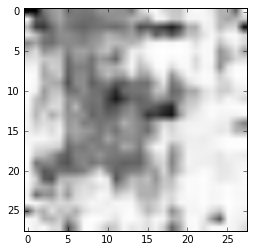

('Estimate:', array([[-0.05587143]], dtype=float32))
('Iteration:', 35500, 'at', datetime.datetime(2017, 7, 7, 14, 13, 58, 256138))


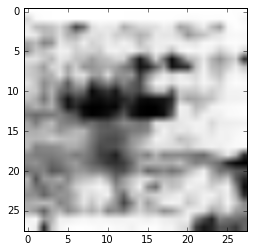

('Estimate:', array([[-9.54339981]], dtype=float32))
('Iteration:', 35600, 'at', datetime.datetime(2017, 7, 7, 14, 14, 2, 841280))


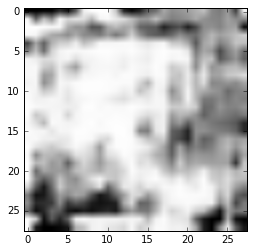

('Estimate:', array([[-2.16838288]], dtype=float32))
('Iteration:', 35700, 'at', datetime.datetime(2017, 7, 7, 14, 14, 7, 650664))


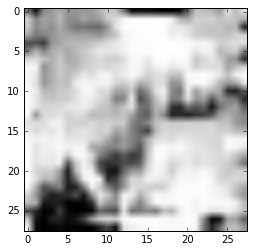

('Estimate:', array([[-39.01798248]], dtype=float32))
('Iteration:', 35800, 'at', datetime.datetime(2017, 7, 7, 14, 14, 12, 76144))


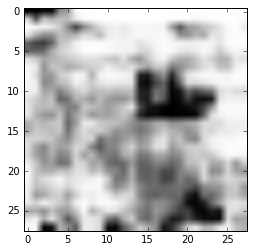

('Estimate:', array([[ 10.76063347]], dtype=float32))
('Iteration:', 35900, 'at', datetime.datetime(2017, 7, 7, 14, 14, 16, 632368))


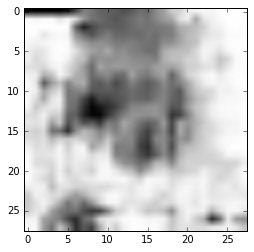

('Estimate:', array([[ 4.57495546]], dtype=float32))
('Iteration:', 36000, 'at', datetime.datetime(2017, 7, 7, 14, 14, 21, 386846))


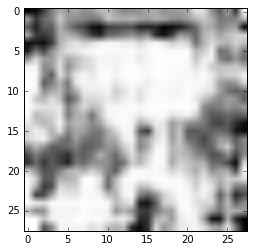

('Estimate:', array([[ 16.71008682]], dtype=float32))
('Iteration:', 36100, 'at', datetime.datetime(2017, 7, 7, 14, 14, 26, 37988))


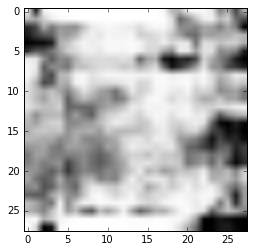

('Estimate:', array([[-4.10680389]], dtype=float32))
('Iteration:', 36200, 'at', datetime.datetime(2017, 7, 7, 14, 14, 30, 822993))


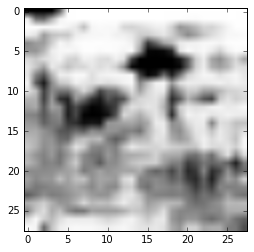

('Estimate:', array([[-8.78976727]], dtype=float32))
('Iteration:', 36300, 'at', datetime.datetime(2017, 7, 7, 14, 14, 35, 520666))


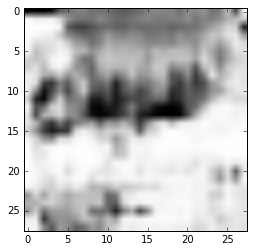

('Estimate:', array([[ 10.73700714]], dtype=float32))
('Iteration:', 36400, 'at', datetime.datetime(2017, 7, 7, 14, 14, 41, 377037))


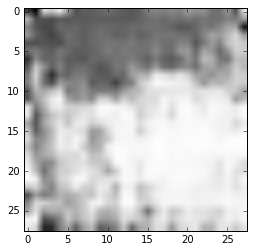

('Estimate:', array([[-6.56401682]], dtype=float32))
('Iteration:', 36500, 'at', datetime.datetime(2017, 7, 7, 14, 14, 46, 38935))


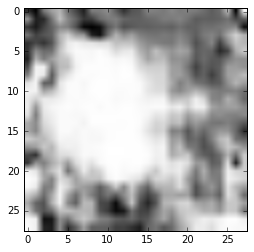

('Estimate:', array([[ 10.61110497]], dtype=float32))
('Iteration:', 36600, 'at', datetime.datetime(2017, 7, 7, 14, 14, 51, 10281))


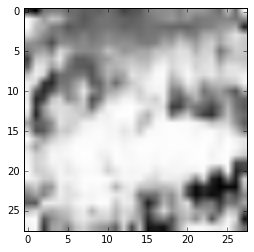

('Estimate:', array([[ 4.22110558]], dtype=float32))
('Iteration:', 36700, 'at', datetime.datetime(2017, 7, 7, 14, 14, 55, 616599))


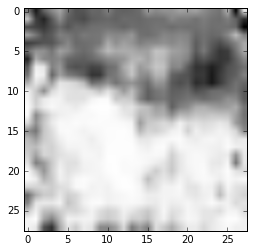

('Estimate:', array([[-7.26275444]], dtype=float32))
('Iteration:', 36800, 'at', datetime.datetime(2017, 7, 7, 14, 15, 0, 267572))


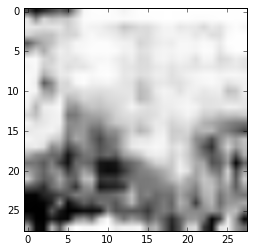

('Estimate:', array([[-5.24841738]], dtype=float32))
('Iteration:', 36900, 'at', datetime.datetime(2017, 7, 7, 14, 15, 4, 858318))


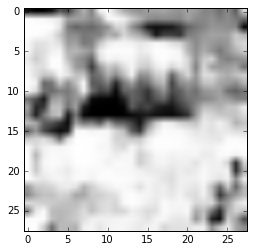

('Estimate:', array([[ 1.45874822]], dtype=float32))
('Iteration:', 37000, 'at', datetime.datetime(2017, 7, 7, 14, 15, 9, 984247))


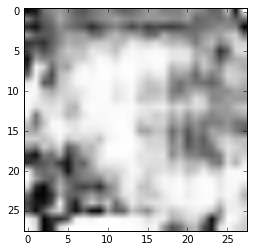

('Estimate:', array([[ 2.97929692]], dtype=float32))
('Iteration:', 37100, 'at', datetime.datetime(2017, 7, 7, 14, 15, 14, 614159))


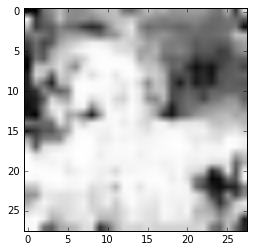

('Estimate:', array([[ 1.95682704]], dtype=float32))
('Iteration:', 37200, 'at', datetime.datetime(2017, 7, 7, 14, 15, 19, 134377))


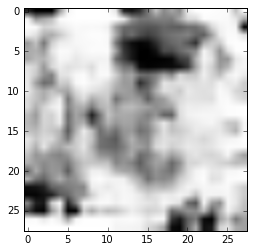

('Estimate:', array([[ 3.38591409]], dtype=float32))
('Iteration:', 37300, 'at', datetime.datetime(2017, 7, 7, 14, 15, 25, 160843))


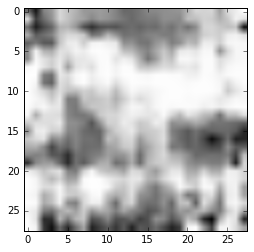

('Estimate:', array([[-0.28096643]], dtype=float32))
('Iteration:', 37400, 'at', datetime.datetime(2017, 7, 7, 14, 15, 30, 247130))


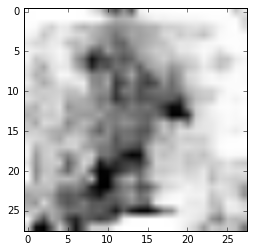

('Estimate:', array([[-1.94019198]], dtype=float32))
('Iteration:', 37500, 'at', datetime.datetime(2017, 7, 7, 14, 15, 34, 960405))


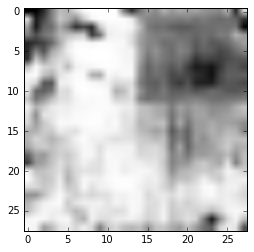

('Estimate:', array([[ 8.27945805]], dtype=float32))
('Iteration:', 37600, 'at', datetime.datetime(2017, 7, 7, 14, 15, 39, 476403))


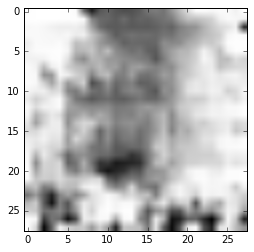

('Estimate:', array([[ 2.63817239]], dtype=float32))
('Iteration:', 37700, 'at', datetime.datetime(2017, 7, 7, 14, 15, 44, 67700))


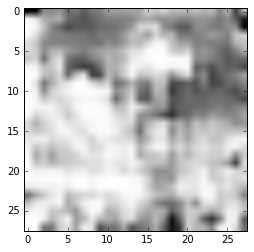

('Estimate:', array([[ 9.64951611]], dtype=float32))
('Iteration:', 37800, 'at', datetime.datetime(2017, 7, 7, 14, 15, 49, 4652))


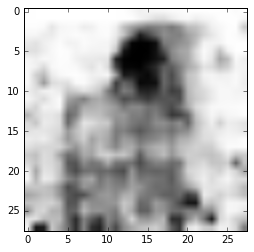

('Estimate:', array([[-17.12893486]], dtype=float32))
('Iteration:', 37900, 'at', datetime.datetime(2017, 7, 7, 14, 15, 53, 935549))


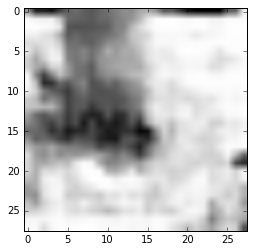

('Estimate:', array([[ 31.67272568]], dtype=float32))
('Iteration:', 38000, 'at', datetime.datetime(2017, 7, 7, 14, 15, 58, 561487))


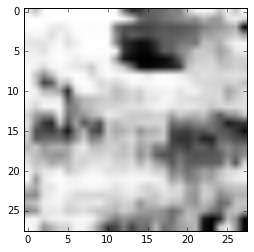

('Estimate:', array([[ 10.37708759]], dtype=float32))
('Iteration:', 38100, 'at', datetime.datetime(2017, 7, 7, 14, 16, 3, 200204))


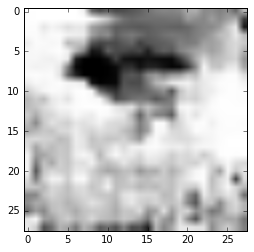

('Estimate:', array([[ 8.57513714]], dtype=float32))
('Iteration:', 38200, 'at', datetime.datetime(2017, 7, 7, 14, 16, 9, 832782))


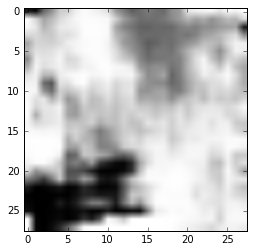

('Estimate:', array([[ 9.17148399]], dtype=float32))
('Iteration:', 38300, 'at', datetime.datetime(2017, 7, 7, 14, 16, 14, 342731))


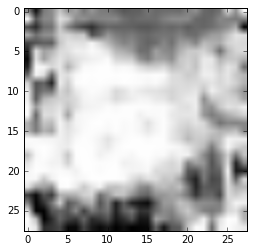

('Estimate:', array([[ 1.07915807]], dtype=float32))
('Iteration:', 38400, 'at', datetime.datetime(2017, 7, 7, 14, 16, 19, 49797))


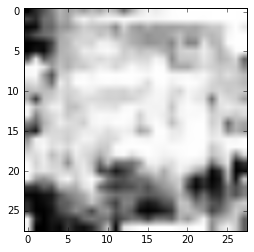

('Estimate:', array([[ 6.49577379]], dtype=float32))
('Iteration:', 38500, 'at', datetime.datetime(2017, 7, 7, 14, 16, 24, 684153))


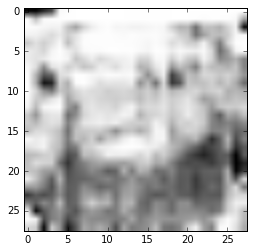

('Estimate:', array([[-0.78288692]], dtype=float32))
('Iteration:', 38600, 'at', datetime.datetime(2017, 7, 7, 14, 16, 29, 735107))


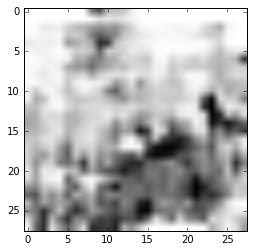

('Estimate:', array([[-2.96435452]], dtype=float32))
('Iteration:', 38700, 'at', datetime.datetime(2017, 7, 7, 14, 16, 34, 390082))


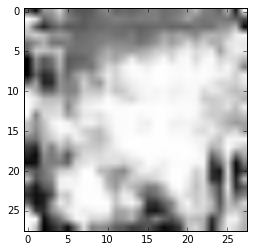

('Estimate:', array([[ 5.10335159]], dtype=float32))
('Iteration:', 38800, 'at', datetime.datetime(2017, 7, 7, 14, 16, 39, 182919))


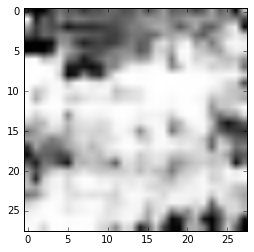

('Estimate:', array([[ 33.61600113]], dtype=float32))
('Iteration:', 38900, 'at', datetime.datetime(2017, 7, 7, 14, 16, 43, 989699))


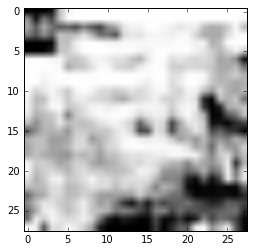

('Estimate:', array([[-2.35680604]], dtype=float32))
('Iteration:', 39000, 'at', datetime.datetime(2017, 7, 7, 14, 16, 48, 997646))


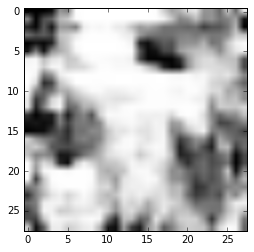

('Estimate:', array([[ 14.39392185]], dtype=float32))
('Iteration:', 39100, 'at', datetime.datetime(2017, 7, 7, 14, 16, 55, 32403))


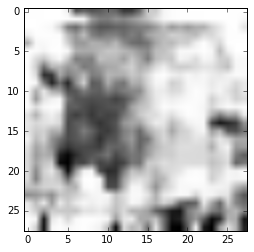

('Estimate:', array([[ 3.04072332]], dtype=float32))
('Iteration:', 39200, 'at', datetime.datetime(2017, 7, 7, 14, 16, 59, 622903))


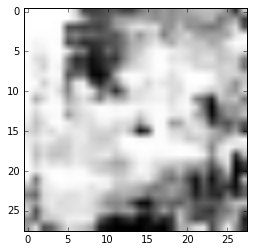

('Estimate:', array([[-5.7829504]], dtype=float32))
('Iteration:', 39300, 'at', datetime.datetime(2017, 7, 7, 14, 17, 4, 260281))


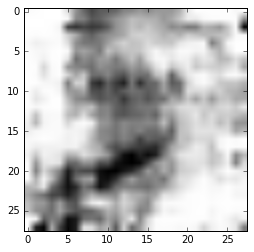

('Estimate:', array([[ 6.7170949]], dtype=float32))
('Iteration:', 39400, 'at', datetime.datetime(2017, 7, 7, 14, 17, 9, 290544))


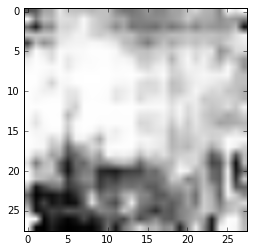

('Estimate:', array([[ 7.32790279]], dtype=float32))
('Iteration:', 39500, 'at', datetime.datetime(2017, 7, 7, 14, 17, 14, 114657))


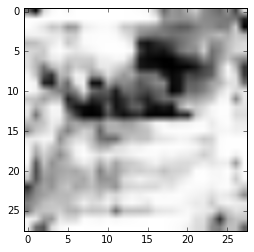

('Estimate:', array([[-24.93789482]], dtype=float32))
('Iteration:', 39600, 'at', datetime.datetime(2017, 7, 7, 14, 17, 18, 841776))


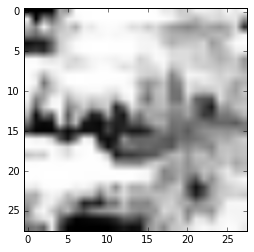

('Estimate:', array([[ 5.79242468]], dtype=float32))
('Iteration:', 39700, 'at', datetime.datetime(2017, 7, 7, 14, 17, 23, 648237))


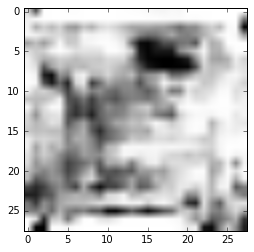

('Estimate:', array([[ 12.01202011]], dtype=float32))
('Iteration:', 39800, 'at', datetime.datetime(2017, 7, 7, 14, 17, 28, 855480))


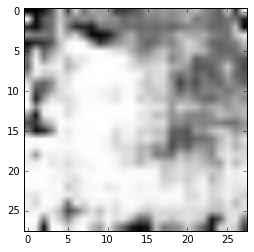

('Estimate:', array([[-32.647686]], dtype=float32))
('Iteration:', 39900, 'at', datetime.datetime(2017, 7, 7, 14, 17, 33, 598019))


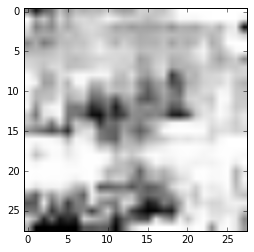

('Estimate:', array([[-22.96198273]], dtype=float32))
('Iteration:', 40000, 'at', datetime.datetime(2017, 7, 7, 14, 17, 40, 160932))


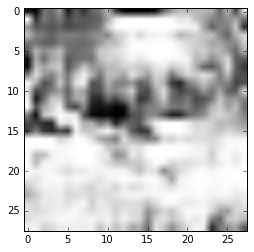

('Estimate:', array([[ 7.36641026]], dtype=float32))
('Iteration:', 40100, 'at', datetime.datetime(2017, 7, 7, 14, 17, 44, 963102))


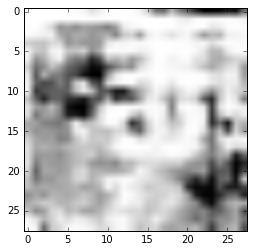

('Estimate:', array([[-3.83490109]], dtype=float32))
('Iteration:', 40200, 'at', datetime.datetime(2017, 7, 7, 14, 17, 50, 164079))


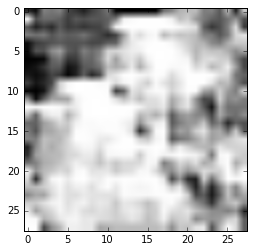

('Estimate:', array([[ 1.51649189]], dtype=float32))
('Iteration:', 40300, 'at', datetime.datetime(2017, 7, 7, 14, 17, 55, 39118))


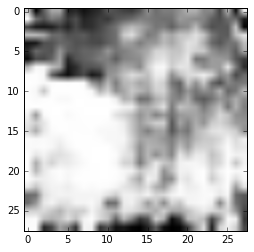

('Estimate:', array([[ 12.51205254]], dtype=float32))
('Iteration:', 40400, 'at', datetime.datetime(2017, 7, 7, 14, 17, 59, 851469))


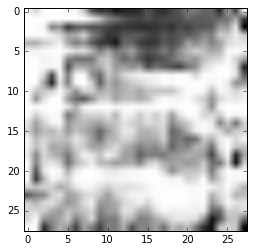

('Estimate:', array([[-4.73500586]], dtype=float32))
('Iteration:', 40500, 'at', datetime.datetime(2017, 7, 7, 14, 18, 4, 745816))


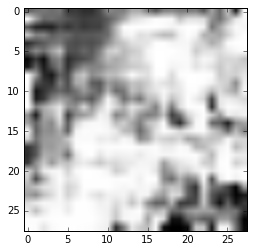

('Estimate:', array([[ 31.38436127]], dtype=float32))
('Iteration:', 40600, 'at', datetime.datetime(2017, 7, 7, 14, 18, 10, 43800))


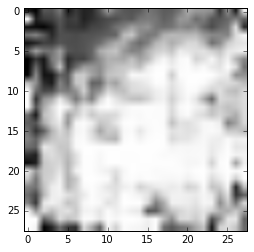

('Estimate:', array([[-6.71082592]], dtype=float32))
('Iteration:', 40700, 'at', datetime.datetime(2017, 7, 7, 14, 18, 15, 856217))


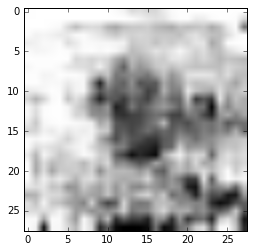

('Estimate:', array([[ 4.41390467]], dtype=float32))
('Iteration:', 40800, 'at', datetime.datetime(2017, 7, 7, 14, 18, 20, 939295))


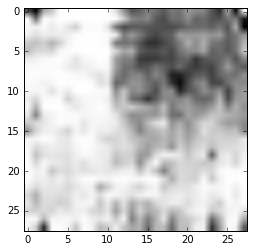

('Estimate:', array([[ 9.85734463]], dtype=float32))
('Iteration:', 40900, 'at', datetime.datetime(2017, 7, 7, 14, 18, 27, 438667))


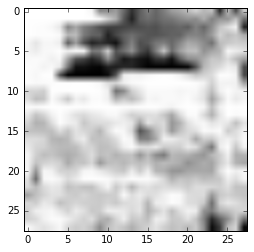

('Estimate:', array([[ 6.74553204]], dtype=float32))
('Iteration:', 41000, 'at', datetime.datetime(2017, 7, 7, 14, 18, 32, 344328))


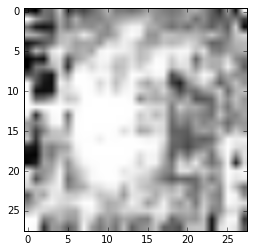

('Estimate:', array([[-9.63509464]], dtype=float32))
('Iteration:', 41100, 'at', datetime.datetime(2017, 7, 7, 14, 18, 37, 172472))


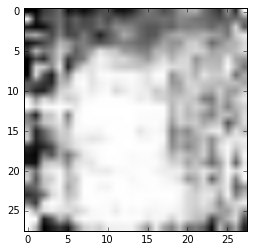

('Estimate:', array([[ 4.97939444]], dtype=float32))
('Iteration:', 41200, 'at', datetime.datetime(2017, 7, 7, 14, 18, 42, 93674))


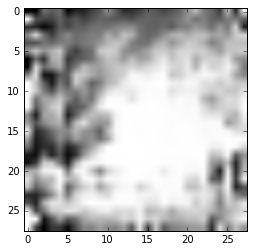

('Estimate:', array([[ 14.41639423]], dtype=float32))
('Iteration:', 41300, 'at', datetime.datetime(2017, 7, 7, 14, 18, 47, 173941))


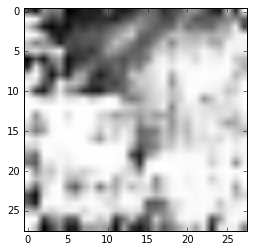

('Estimate:', array([[-7.03505278]], dtype=float32))
('Iteration:', 41400, 'at', datetime.datetime(2017, 7, 7, 14, 18, 52, 110821))


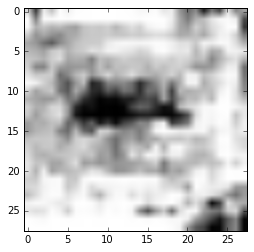

('Estimate:', array([[ 18.55107689]], dtype=float32))
('Iteration:', 41500, 'at', datetime.datetime(2017, 7, 7, 14, 18, 57, 66713))


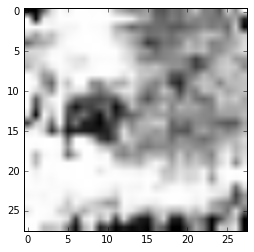

('Estimate:', array([[ 3.11465931]], dtype=float32))
('Iteration:', 41600, 'at', datetime.datetime(2017, 7, 7, 14, 19, 1, 999809))


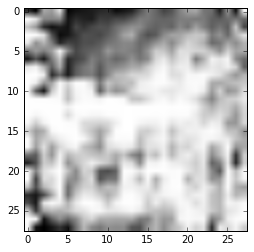

('Estimate:', array([[ 2.8344214]], dtype=float32))
('Iteration:', 41700, 'at', datetime.datetime(2017, 7, 7, 14, 19, 7, 84802))


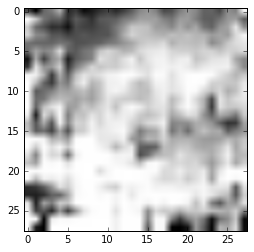

('Estimate:', array([[ 1.79593396]], dtype=float32))
('Iteration:', 41800, 'at', datetime.datetime(2017, 7, 7, 14, 19, 14, 147282))


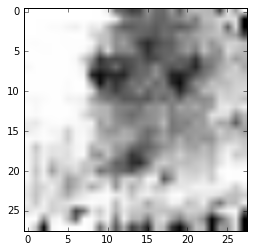

('Estimate:', array([[ 9.38293552]], dtype=float32))
('Iteration:', 41900, 'at', datetime.datetime(2017, 7, 7, 14, 19, 19, 121263))


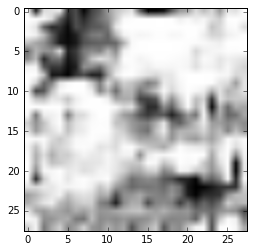

('Estimate:', array([[-31.88310623]], dtype=float32))
('Iteration:', 42000, 'at', datetime.datetime(2017, 7, 7, 14, 19, 24, 36729))


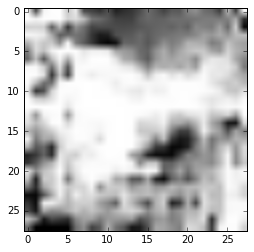

('Estimate:', array([[ 4.37708521]], dtype=float32))
('Iteration:', 42100, 'at', datetime.datetime(2017, 7, 7, 14, 19, 29, 294985))


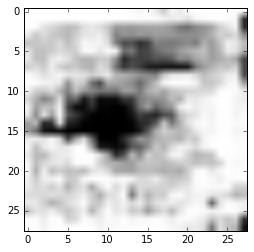

('Estimate:', array([[-6.86832142]], dtype=float32))
('Iteration:', 42200, 'at', datetime.datetime(2017, 7, 7, 14, 19, 34, 277071))


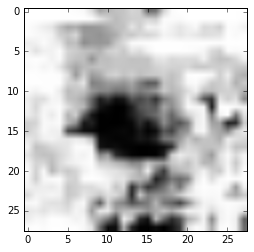

('Estimate:', array([[ 2.15964556]], dtype=float32))
('Iteration:', 42300, 'at', datetime.datetime(2017, 7, 7, 14, 19, 39, 361213))


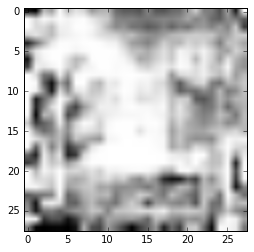

('Estimate:', array([[-7.33333349]], dtype=float32))
('Iteration:', 42400, 'at', datetime.datetime(2017, 7, 7, 14, 19, 44, 150765))


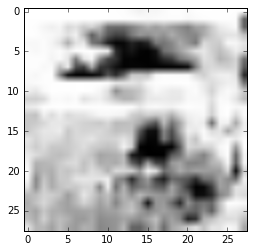

('Estimate:', array([[ 4.41477251]], dtype=float32))
('Iteration:', 42500, 'at', datetime.datetime(2017, 7, 7, 14, 19, 49, 605440))


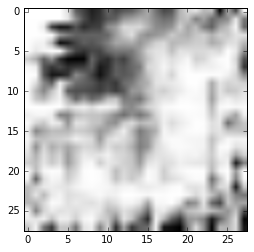

('Estimate:', array([[-7.44669247]], dtype=float32))
('Iteration:', 42600, 'at', datetime.datetime(2017, 7, 7, 14, 19, 54, 464899))


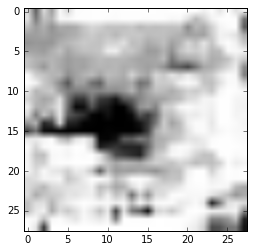

('Estimate:', array([[ 14.8883543]], dtype=float32))
('Iteration:', 42700, 'at', datetime.datetime(2017, 7, 7, 14, 20, 0, 838824))


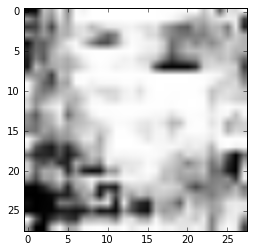

('Estimate:', array([[ 4.15877581]], dtype=float32))
('Iteration:', 42800, 'at', datetime.datetime(2017, 7, 7, 14, 20, 5, 908801))


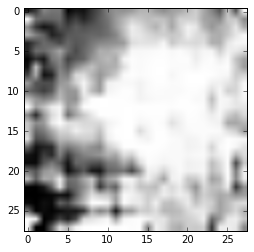

('Estimate:', array([[-8.45695305]], dtype=float32))
('Iteration:', 42900, 'at', datetime.datetime(2017, 7, 7, 14, 20, 10, 926709))


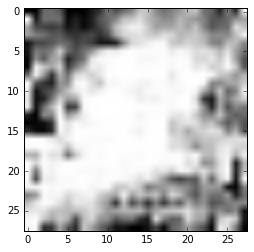

('Estimate:', array([[ 16.82423019]], dtype=float32))
('Iteration:', 43000, 'at', datetime.datetime(2017, 7, 7, 14, 20, 15, 850628))


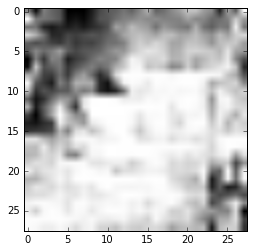

('Estimate:', array([[ 1.22031617]], dtype=float32))
('Iteration:', 43100, 'at', datetime.datetime(2017, 7, 7, 14, 20, 20, 871694))


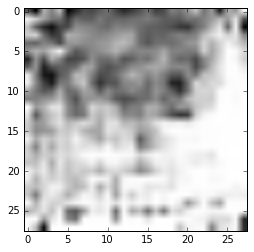

('Estimate:', array([[ 1.73391938]], dtype=float32))
('Iteration:', 43200, 'at', datetime.datetime(2017, 7, 7, 14, 20, 25, 928628))


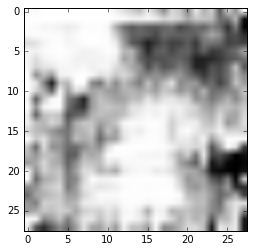

('Estimate:', array([[ 8.60955429]], dtype=float32))
('Iteration:', 43300, 'at', datetime.datetime(2017, 7, 7, 14, 20, 31, 120415))


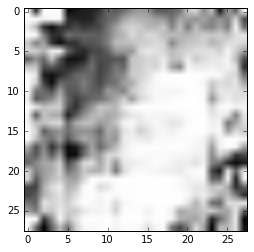

('Estimate:', array([[ 3.15820837]], dtype=float32))
('Iteration:', 43400, 'at', datetime.datetime(2017, 7, 7, 14, 20, 36, 166233))


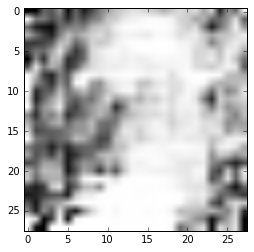

('Estimate:', array([[ 7.08904123]], dtype=float32))
('Iteration:', 43500, 'at', datetime.datetime(2017, 7, 7, 14, 20, 41, 235356))


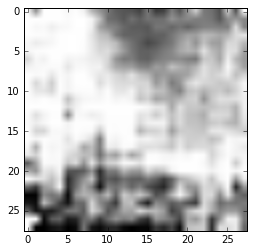

('Estimate:', array([[-2.48752689]], dtype=float32))
('Iteration:', 43600, 'at', datetime.datetime(2017, 7, 7, 14, 20, 47, 350823))


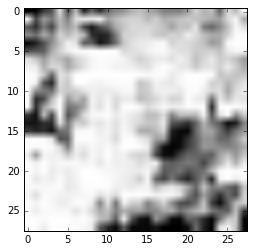

('Estimate:', array([[ 1.29856014]], dtype=float32))
('Iteration:', 43700, 'at', datetime.datetime(2017, 7, 7, 14, 20, 52, 198801))


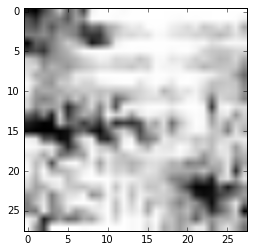

('Estimate:', array([[-10.80459118]], dtype=float32))
('Iteration:', 43800, 'at', datetime.datetime(2017, 7, 7, 14, 20, 57, 131258))


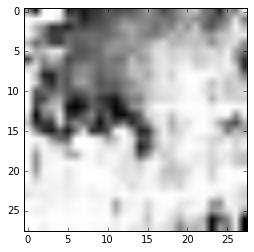

('Estimate:', array([[ 4.32754087]], dtype=float32))
('Iteration:', 43900, 'at', datetime.datetime(2017, 7, 7, 14, 21, 2, 94228))


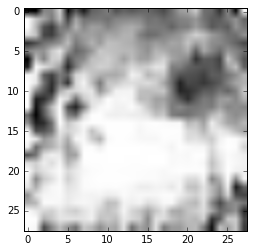

('Estimate:', array([[-1.72744536]], dtype=float32))
('Iteration:', 44000, 'at', datetime.datetime(2017, 7, 7, 14, 21, 7, 294003))


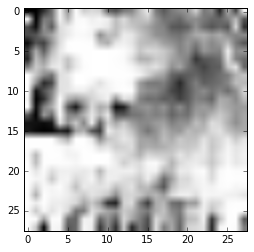

('Estimate:', array([[-0.54515243]], dtype=float32))
('Iteration:', 44100, 'at', datetime.datetime(2017, 7, 7, 14, 21, 12, 327921))


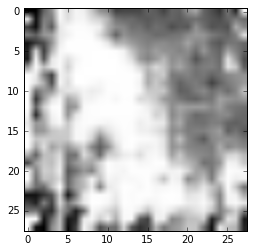

('Estimate:', array([[ 2.54121232]], dtype=float32))
('Iteration:', 44200, 'at', datetime.datetime(2017, 7, 7, 14, 21, 17, 429075))


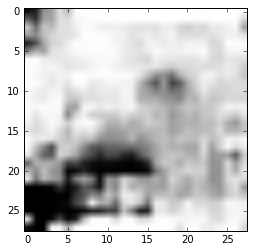

('Estimate:', array([[-0.80858576]], dtype=float32))
('Iteration:', 44300, 'at', datetime.datetime(2017, 7, 7, 14, 21, 22, 333095))


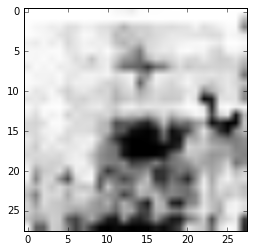

('Estimate:', array([[-0.68588179]], dtype=float32))
('Iteration:', 44400, 'at', datetime.datetime(2017, 7, 7, 14, 21, 27, 406346))


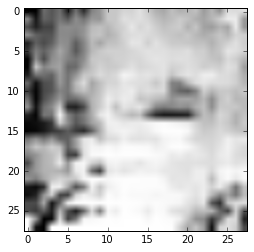

('Estimate:', array([[ 2.47416425]], dtype=float32))
('Iteration:', 44500, 'at', datetime.datetime(2017, 7, 7, 14, 21, 33, 814907))


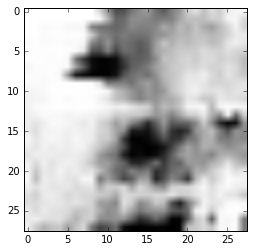

('Estimate:', array([[ 6.14943886]], dtype=float32))
('Iteration:', 44600, 'at', datetime.datetime(2017, 7, 7, 14, 21, 38, 835656))


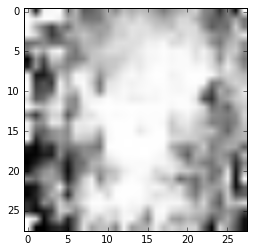

('Estimate:', array([[-0.33982134]], dtype=float32))
('Iteration:', 44700, 'at', datetime.datetime(2017, 7, 7, 14, 21, 43, 717224))


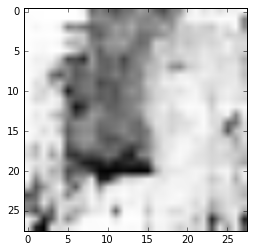

('Estimate:', array([[ 18.52871323]], dtype=float32))
('Iteration:', 44800, 'at', datetime.datetime(2017, 7, 7, 14, 21, 48, 891607))


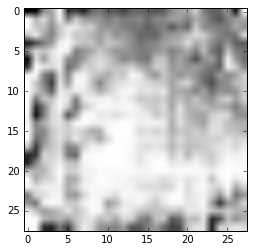

('Estimate:', array([[ 2.13521886]], dtype=float32))
('Iteration:', 44900, 'at', datetime.datetime(2017, 7, 7, 14, 21, 53, 667790))


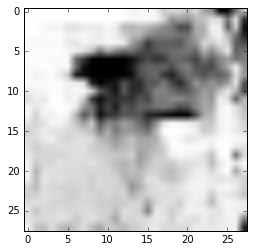

('Estimate:', array([[ 5.36385965]], dtype=float32))
('Iteration:', 45000, 'at', datetime.datetime(2017, 7, 7, 14, 21, 58, 722177))


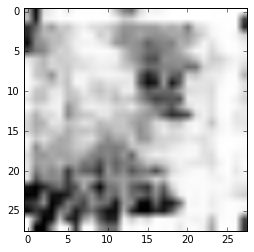

('Estimate:', array([[-1.13473713]], dtype=float32))
('Iteration:', 45100, 'at', datetime.datetime(2017, 7, 7, 14, 22, 3, 609967))


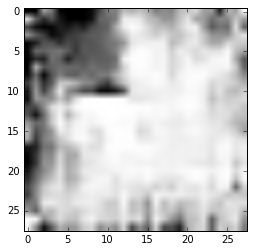

('Estimate:', array([[ 7.55768108]], dtype=float32))
('Iteration:', 45200, 'at', datetime.datetime(2017, 7, 7, 14, 22, 9, 120678))


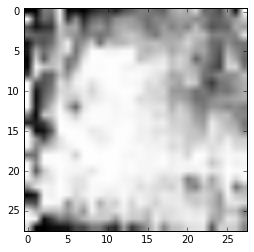

('Estimate:', array([[-11.46645069]], dtype=float32))
('Iteration:', 45300, 'at', datetime.datetime(2017, 7, 7, 14, 22, 14, 22428))


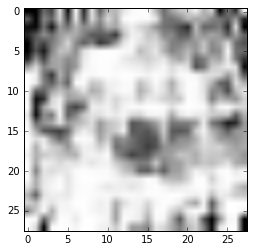

('Estimate:', array([[-0.1823529]], dtype=float32))
('Iteration:', 45400, 'at', datetime.datetime(2017, 7, 7, 14, 22, 20, 869552))


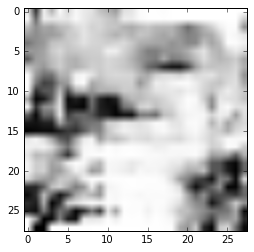

('Estimate:', array([[ 8.12539673]], dtype=float32))
('Iteration:', 45500, 'at', datetime.datetime(2017, 7, 7, 14, 22, 26, 84080))


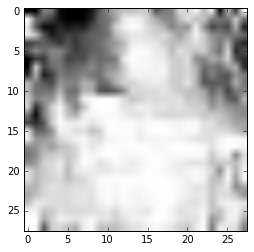

('Estimate:', array([[ 4.97566319]], dtype=float32))
('Iteration:', 45600, 'at', datetime.datetime(2017, 7, 7, 14, 22, 31, 430517))


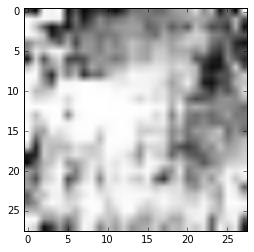

('Estimate:', array([[-5.46487665]], dtype=float32))
('Iteration:', 45700, 'at', datetime.datetime(2017, 7, 7, 14, 22, 36, 436594))


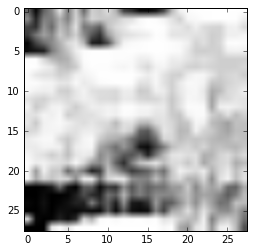

('Estimate:', array([[ 22.7625351]], dtype=float32))
('Iteration:', 45800, 'at', datetime.datetime(2017, 7, 7, 14, 22, 41, 243879))


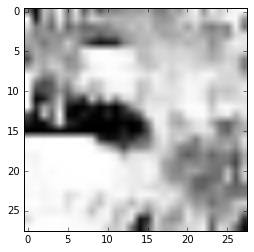

('Estimate:', array([[ 8.24348259]], dtype=float32))
('Iteration:', 45900, 'at', datetime.datetime(2017, 7, 7, 14, 22, 46, 467866))


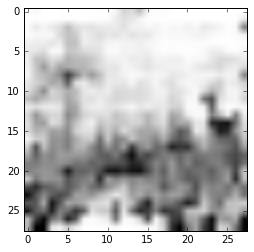

('Estimate:', array([[ 4.03415442]], dtype=float32))
('Iteration:', 46000, 'at', datetime.datetime(2017, 7, 7, 14, 22, 51, 703622))


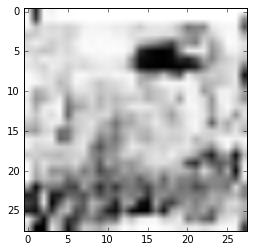

('Estimate:', array([[ 2.00542378]], dtype=float32))
('Iteration:', 46100, 'at', datetime.datetime(2017, 7, 7, 14, 22, 56, 941234))


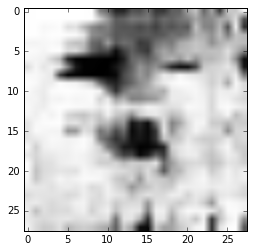

('Estimate:', array([[ 4.11654663]], dtype=float32))
('Iteration:', 46200, 'at', datetime.datetime(2017, 7, 7, 14, 23, 2, 88857))


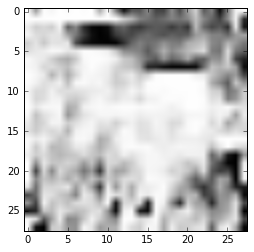

('Estimate:', array([[ 7.61255455]], dtype=float32))
('Iteration:', 46300, 'at', datetime.datetime(2017, 7, 7, 14, 23, 8, 582731))


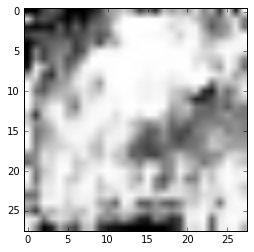

('Estimate:', array([[ 2.83993673]], dtype=float32))
('Iteration:', 46400, 'at', datetime.datetime(2017, 7, 7, 14, 23, 13, 504342))


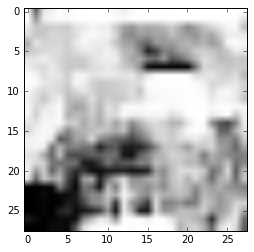

('Estimate:', array([[-0.70420086]], dtype=float32))
('Iteration:', 46500, 'at', datetime.datetime(2017, 7, 7, 14, 23, 18, 705863))


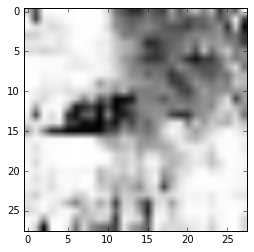

('Estimate:', array([[ 3.56966591]], dtype=float32))
('Iteration:', 46600, 'at', datetime.datetime(2017, 7, 7, 14, 23, 23, 982468))


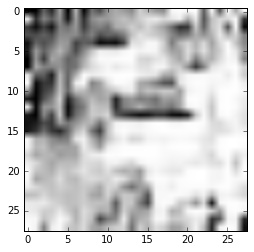

('Estimate:', array([[-1.26326776]], dtype=float32))
('Iteration:', 46700, 'at', datetime.datetime(2017, 7, 7, 14, 23, 29, 624697))


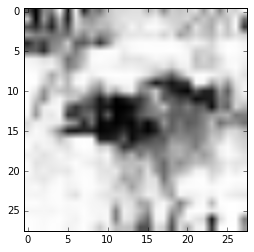

('Estimate:', array([[-1.64159608]], dtype=float32))
('Iteration:', 46800, 'at', datetime.datetime(2017, 7, 7, 14, 23, 34, 954527))


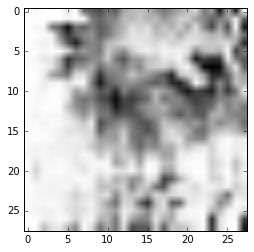

('Estimate:', array([[ 6.82559061]], dtype=float32))
('Iteration:', 46900, 'at', datetime.datetime(2017, 7, 7, 14, 23, 41, 310636))


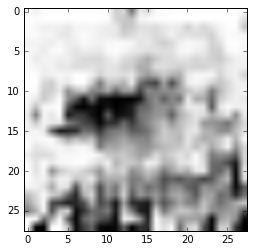

('Estimate:', array([[ 3.13464999]], dtype=float32))
('Iteration:', 47000, 'at', datetime.datetime(2017, 7, 7, 14, 23, 46, 745098))


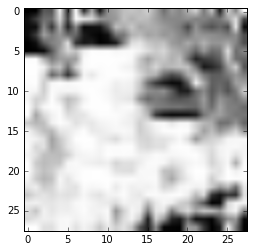

('Estimate:', array([[ 14.24808693]], dtype=float32))
('Iteration:', 47100, 'at', datetime.datetime(2017, 7, 7, 14, 23, 52, 217840))


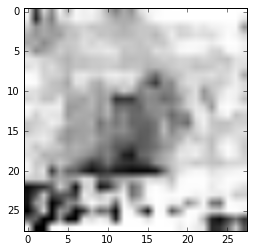

('Estimate:', array([[-4.56860876]], dtype=float32))
('Iteration:', 47200, 'at', datetime.datetime(2017, 7, 7, 14, 23, 58, 762765))


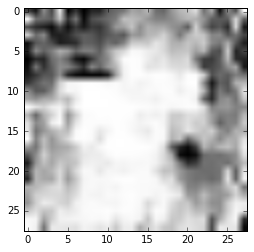

('Estimate:', array([[ 5.15166998]], dtype=float32))
('Iteration:', 47300, 'at', datetime.datetime(2017, 7, 7, 14, 24, 3, 907924))


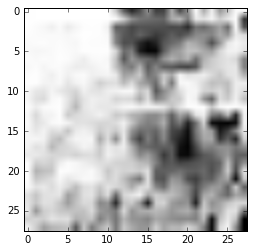

('Estimate:', array([[ 3.2084024]], dtype=float32))
('Iteration:', 47400, 'at', datetime.datetime(2017, 7, 7, 14, 24, 9, 513788))


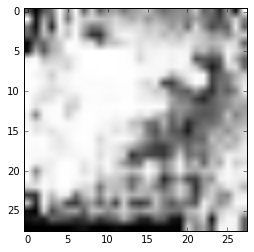

('Estimate:', array([[ 8.91778278]], dtype=float32))
('Iteration:', 47500, 'at', datetime.datetime(2017, 7, 7, 14, 24, 14, 708050))


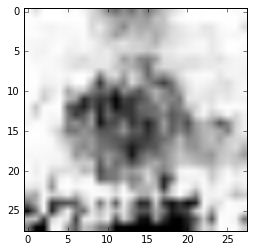

('Estimate:', array([[ 9.23474884]], dtype=float32))
('Iteration:', 47600, 'at', datetime.datetime(2017, 7, 7, 14, 24, 19, 810648))


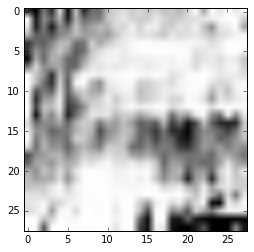

('Estimate:', array([[ 8.68766785]], dtype=float32))
('Iteration:', 47700, 'at', datetime.datetime(2017, 7, 7, 14, 24, 25, 308002))


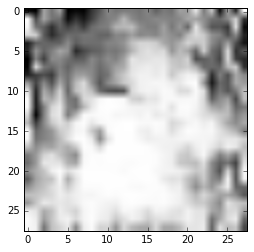

('Estimate:', array([[ 6.72500658]], dtype=float32))
('Iteration:', 47800, 'at', datetime.datetime(2017, 7, 7, 14, 24, 30, 930720))


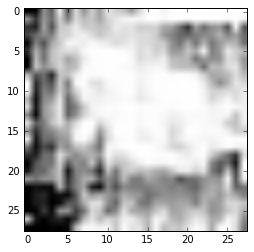

('Estimate:', array([[ 0.96392417]], dtype=float32))
('Iteration:', 47900, 'at', datetime.datetime(2017, 7, 7, 14, 24, 36, 133669))


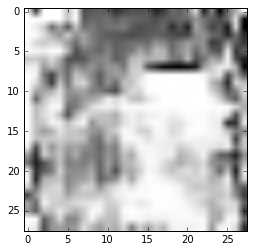

('Estimate:', array([[ 12.73244953]], dtype=float32))
('Iteration:', 48000, 'at', datetime.datetime(2017, 7, 7, 14, 24, 41, 402412))


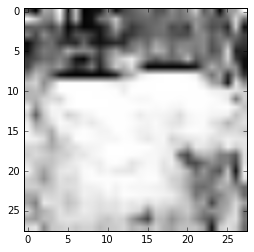

('Estimate:', array([[ 13.52000618]], dtype=float32))
('Iteration:', 48100, 'at', datetime.datetime(2017, 7, 7, 14, 24, 48, 203578))


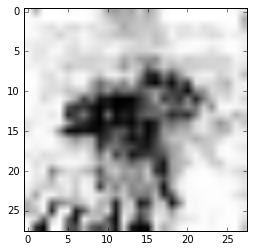

('Estimate:', array([[ 13.729146]], dtype=float32))
('Iteration:', 48200, 'at', datetime.datetime(2017, 7, 7, 14, 24, 53, 573217))


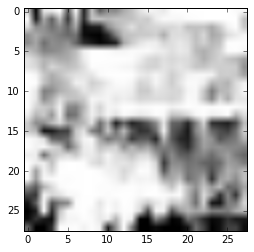

('Estimate:', array([[ 0.7665801]], dtype=float32))
('Iteration:', 48300, 'at', datetime.datetime(2017, 7, 7, 14, 24, 58, 590833))


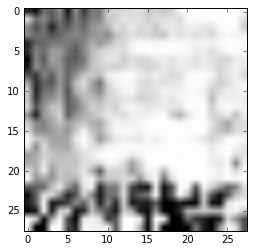

('Estimate:', array([[-5.06143141]], dtype=float32))
('Iteration:', 48400, 'at', datetime.datetime(2017, 7, 7, 14, 25, 3, 835539))


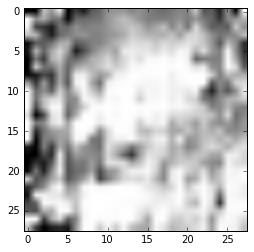

('Estimate:', array([[-3.16849947]], dtype=float32))
('Iteration:', 48500, 'at', datetime.datetime(2017, 7, 7, 14, 25, 9, 366007))


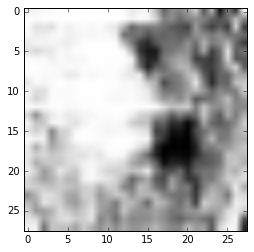

('Estimate:', array([[ 8.47925758]], dtype=float32))
('Iteration:', 48600, 'at', datetime.datetime(2017, 7, 7, 14, 25, 14, 633487))


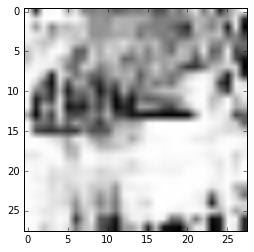

('Estimate:', array([[-4.64181614]], dtype=float32))
('Iteration:', 48700, 'at', datetime.datetime(2017, 7, 7, 14, 25, 19, 874175))


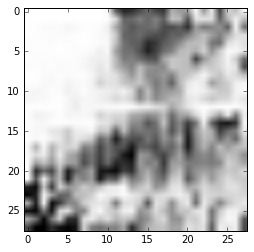

('Estimate:', array([[ 14.13170242]], dtype=float32))
('Iteration:', 48800, 'at', datetime.datetime(2017, 7, 7, 14, 25, 25, 191031))


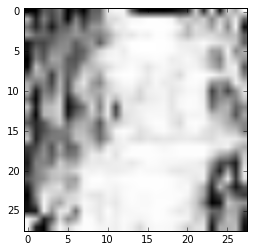

('Estimate:', array([[ 2.6441958]], dtype=float32))
('Iteration:', 48900, 'at', datetime.datetime(2017, 7, 7, 14, 25, 30, 789650))


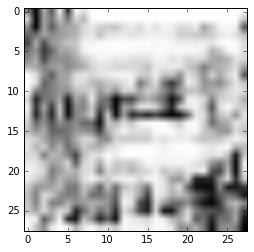

('Estimate:', array([[-7.91567183]], dtype=float32))
('Iteration:', 49000, 'at', datetime.datetime(2017, 7, 7, 14, 25, 37, 618158))


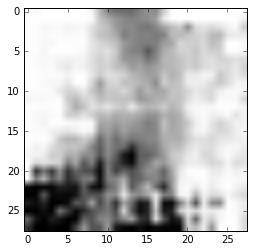

('Estimate:', array([[-0.02995999]], dtype=float32))
('Iteration:', 49100, 'at', datetime.datetime(2017, 7, 7, 14, 25, 42, 798388))


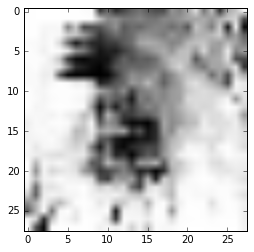

('Estimate:', array([[-0.28203878]], dtype=float32))
('Iteration:', 49200, 'at', datetime.datetime(2017, 7, 7, 14, 25, 48, 261286))


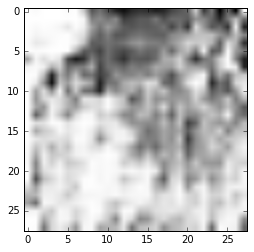

('Estimate:', array([[-3.4343884]], dtype=float32))
('Iteration:', 49300, 'at', datetime.datetime(2017, 7, 7, 14, 25, 53, 854936))


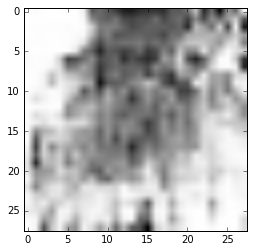

('Estimate:', array([[-3.22247124]], dtype=float32))
('Iteration:', 49400, 'at', datetime.datetime(2017, 7, 7, 14, 25, 59, 26412))


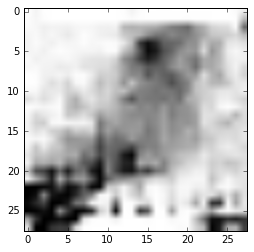

('Estimate:', array([[ 10.87818813]], dtype=float32))
('Iteration:', 49500, 'at', datetime.datetime(2017, 7, 7, 14, 26, 4, 263475))


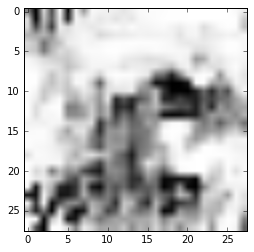

('Estimate:', array([[ 5.95007229]], dtype=float32))
('Iteration:', 49600, 'at', datetime.datetime(2017, 7, 7, 14, 26, 9, 996411))


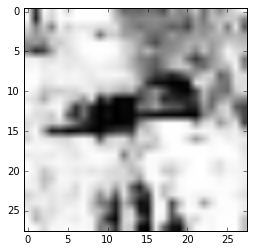

('Estimate:', array([[-7.02753305]], dtype=float32))
('Iteration:', 49700, 'at', datetime.datetime(2017, 7, 7, 14, 26, 15, 281499))


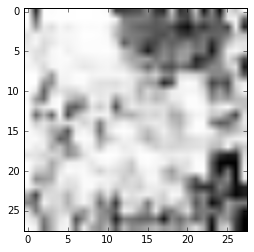

('Estimate:', array([[-8.30862808]], dtype=float32))
('Iteration:', 49800, 'at', datetime.datetime(2017, 7, 7, 14, 26, 20, 759560))


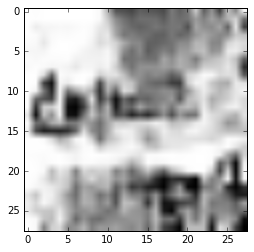

('Estimate:', array([[ 2.94665217]], dtype=float32))
('Iteration:', 49900, 'at', datetime.datetime(2017, 7, 7, 14, 26, 27, 903051))


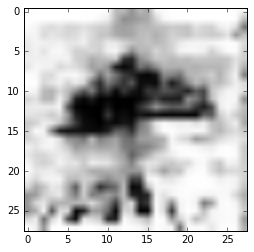

('Estimate:', array([[-8.26103497]], dtype=float32))
('Iteration:', 50000, 'at', datetime.datetime(2017, 7, 7, 14, 26, 33, 409662))


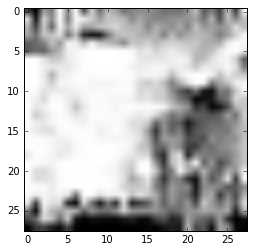

('Estimate:', array([[ 14.08773518]], dtype=float32))
('Iteration:', 50100, 'at', datetime.datetime(2017, 7, 7, 14, 26, 38, 873674))


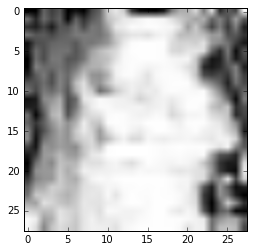

('Estimate:', array([[ 9.55215168]], dtype=float32))
('Iteration:', 50200, 'at', datetime.datetime(2017, 7, 7, 14, 26, 44, 284635))


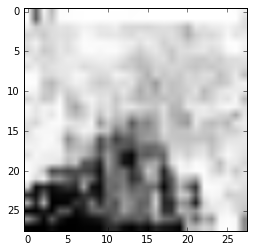

('Estimate:', array([[ 8.26489639]], dtype=float32))
('Iteration:', 50300, 'at', datetime.datetime(2017, 7, 7, 14, 26, 50, 64649))


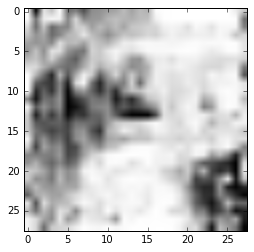

('Estimate:', array([[ 6.78261328]], dtype=float32))
('Iteration:', 50400, 'at', datetime.datetime(2017, 7, 7, 14, 26, 55, 284210))


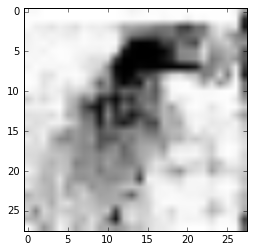

('Estimate:', array([[-7.41449165]], dtype=float32))
('Iteration:', 50500, 'at', datetime.datetime(2017, 7, 7, 14, 27, 0, 714172))


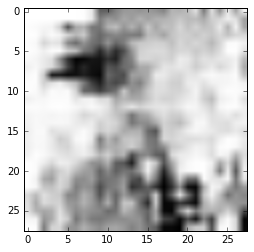

('Estimate:', array([[ 6.68260765]], dtype=float32))
('Iteration:', 50600, 'at', datetime.datetime(2017, 7, 7, 14, 27, 6, 172613))


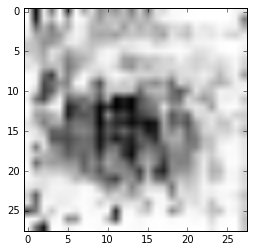

('Estimate:', array([[-1.13955092]], dtype=float32))
('Iteration:', 50700, 'at', datetime.datetime(2017, 7, 7, 14, 27, 11, 645853))


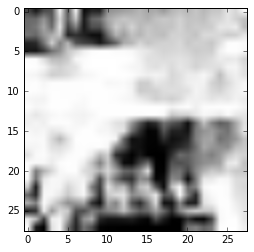

('Estimate:', array([[ 23.41601562]], dtype=float32))
('Iteration:', 50800, 'at', datetime.datetime(2017, 7, 7, 14, 27, 18, 418631))


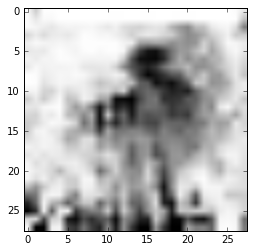

('Estimate:', array([[ 13.3986454]], dtype=float32))
('Iteration:', 50900, 'at', datetime.datetime(2017, 7, 7, 14, 27, 23, 676079))


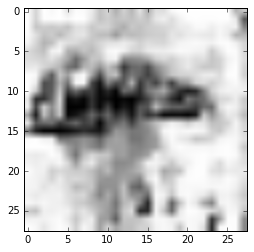

('Estimate:', array([[ 9.42494965]], dtype=float32))
('Iteration:', 51000, 'at', datetime.datetime(2017, 7, 7, 14, 27, 29, 599825))


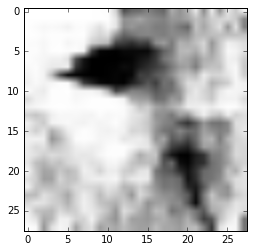

('Estimate:', array([[ 2.50887752]], dtype=float32))
('Iteration:', 51100, 'at', datetime.datetime(2017, 7, 7, 14, 27, 35, 72405))


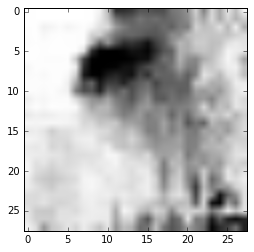

('Estimate:', array([[ 0.00466882]], dtype=float32))
('Iteration:', 51200, 'at', datetime.datetime(2017, 7, 7, 14, 27, 40, 595477))


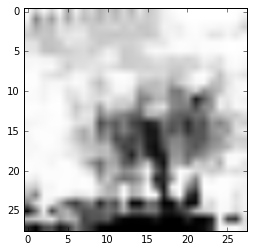

('Estimate:', array([[ 13.07400608]], dtype=float32))
('Iteration:', 51300, 'at', datetime.datetime(2017, 7, 7, 14, 27, 45, 988014))


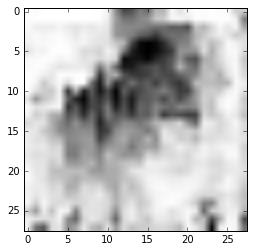

('Estimate:', array([[-6.38857889]], dtype=float32))
('Iteration:', 51400, 'at', datetime.datetime(2017, 7, 7, 14, 27, 51, 819266))


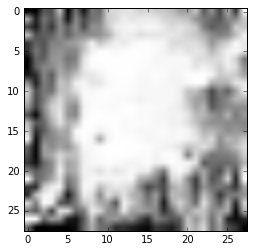

('Estimate:', array([[-7.34338808]], dtype=float32))
('Iteration:', 51500, 'at', datetime.datetime(2017, 7, 7, 14, 27, 57, 101512))


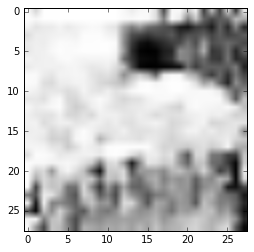

('Estimate:', array([[ 6.27033329]], dtype=float32))
('Iteration:', 51600, 'at', datetime.datetime(2017, 7, 7, 14, 28, 2, 527715))


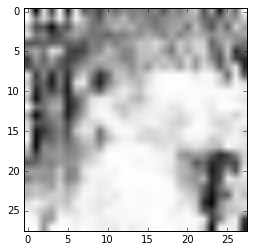

('Estimate:', array([[-0.65605581]], dtype=float32))
('Iteration:', 51700, 'at', datetime.datetime(2017, 7, 7, 14, 28, 9, 464069))


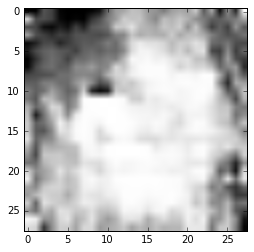

('Estimate:', array([[ 1.2156297]], dtype=float32))
('Iteration:', 51800, 'at', datetime.datetime(2017, 7, 7, 14, 28, 14, 942745))


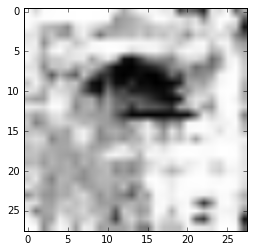

('Estimate:', array([[-12.97864151]], dtype=float32))
('Iteration:', 51900, 'at', datetime.datetime(2017, 7, 7, 14, 28, 20, 267826))


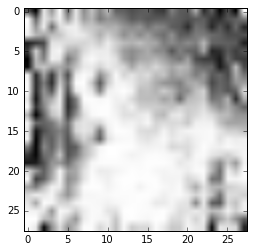

('Estimate:', array([[-0.84606123]], dtype=float32))
('Iteration:', 52000, 'at', datetime.datetime(2017, 7, 7, 14, 28, 26, 19984))


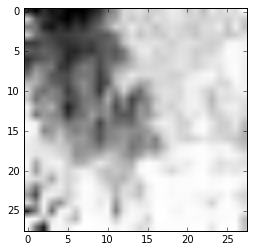

('Estimate:', array([[ 14.51744556]], dtype=float32))
('Iteration:', 52100, 'at', datetime.datetime(2017, 7, 7, 14, 28, 31, 888737))


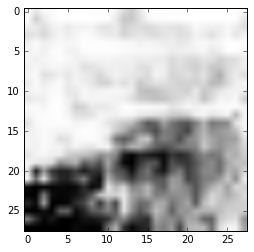

('Estimate:', array([[ 7.26656961]], dtype=float32))
('Iteration:', 52200, 'at', datetime.datetime(2017, 7, 7, 14, 28, 37, 184774))


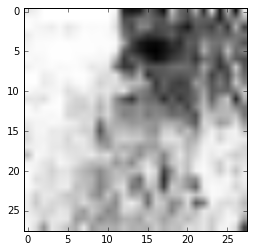

('Estimate:', array([[ 17.35660553]], dtype=float32))
('Iteration:', 52300, 'at', datetime.datetime(2017, 7, 7, 14, 28, 42, 719284))


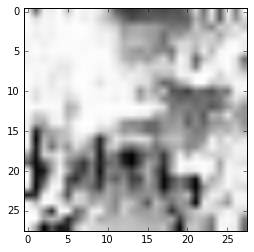

('Estimate:', array([[-1.36680496]], dtype=float32))
('Iteration:', 52400, 'at', datetime.datetime(2017, 7, 7, 14, 28, 48, 534870))


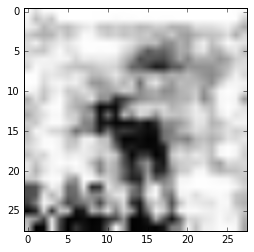

('Estimate:', array([[-19.55150032]], dtype=float32))
('Iteration:', 52500, 'at', datetime.datetime(2017, 7, 7, 14, 28, 53, 921483))


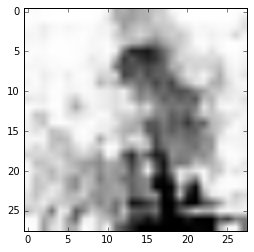

('Estimate:', array([[ 8.51417732]], dtype=float32))
('Iteration:', 52600, 'at', datetime.datetime(2017, 7, 7, 14, 29, 0, 813618))


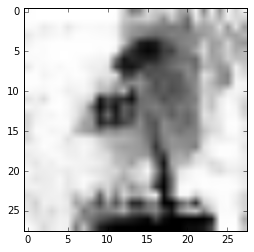

('Estimate:', array([[ 8.9676075]], dtype=float32))
('Iteration:', 52700, 'at', datetime.datetime(2017, 7, 7, 14, 29, 6, 446500))


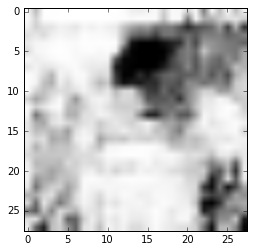

('Estimate:', array([[ 9.77203083]], dtype=float32))
('Iteration:', 52800, 'at', datetime.datetime(2017, 7, 7, 14, 29, 12, 283984))


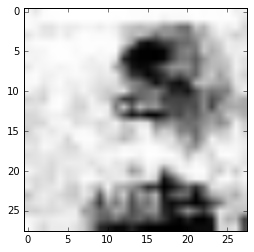

('Estimate:', array([[ 1.08693767]], dtype=float32))
('Iteration:', 52900, 'at', datetime.datetime(2017, 7, 7, 14, 29, 17, 855422))


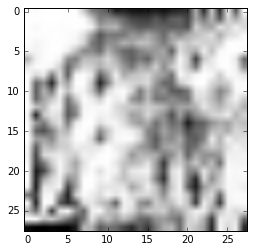

('Estimate:', array([[-10.42780972]], dtype=float32))
('Iteration:', 53000, 'at', datetime.datetime(2017, 7, 7, 14, 29, 23, 211907))


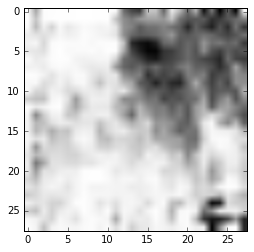

('Estimate:', array([[ 11.22531414]], dtype=float32))
('Iteration:', 53100, 'at', datetime.datetime(2017, 7, 7, 14, 29, 29, 493029))


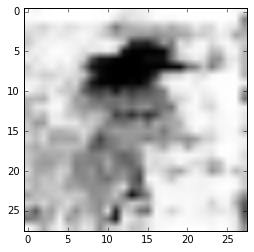

('Estimate:', array([[-29.51388931]], dtype=float32))
('Iteration:', 53200, 'at', datetime.datetime(2017, 7, 7, 14, 29, 35, 870027))


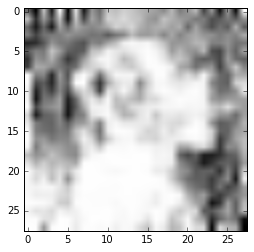

('Estimate:', array([[ 0.51677001]], dtype=float32))
('Iteration:', 53300, 'at', datetime.datetime(2017, 7, 7, 14, 29, 41, 402926))


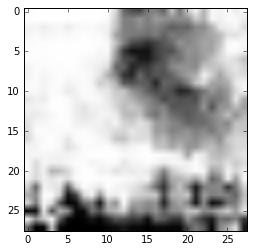

('Estimate:', array([[ 11.36433697]], dtype=float32))
('Iteration:', 53400, 'at', datetime.datetime(2017, 7, 7, 14, 29, 47, 392336))


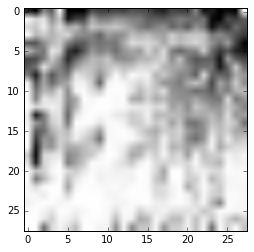

('Estimate:', array([[ 52.37554932]], dtype=float32))
('Iteration:', 53500, 'at', datetime.datetime(2017, 7, 7, 14, 29, 55, 510680))


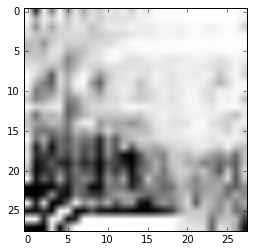

('Estimate:', array([[ 16.75010872]], dtype=float32))
('Iteration:', 53600, 'at', datetime.datetime(2017, 7, 7, 14, 30, 1, 76085))


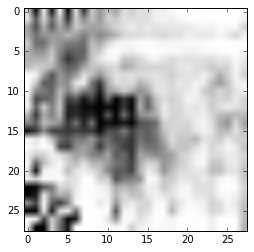

('Estimate:', array([[-0.06608219]], dtype=float32))
('Iteration:', 53700, 'at', datetime.datetime(2017, 7, 7, 14, 30, 8, 224350))


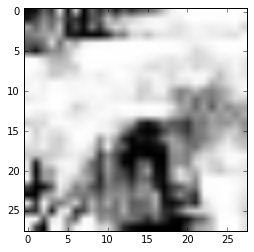

('Estimate:', array([[ 7.70528507]], dtype=float32))
('Iteration:', 53800, 'at', datetime.datetime(2017, 7, 7, 14, 30, 13, 880447))


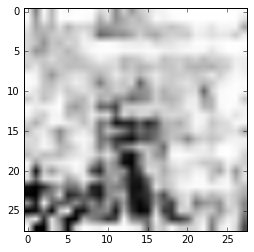

('Estimate:', array([[-17.01236534]], dtype=float32))
('Iteration:', 53900, 'at', datetime.datetime(2017, 7, 7, 14, 30, 21, 170659))


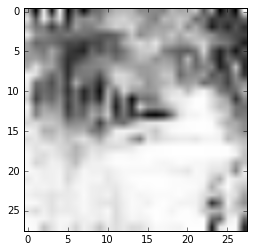

('Estimate:', array([[ 15.47029018]], dtype=float32))
('Iteration:', 54000, 'at', datetime.datetime(2017, 7, 7, 14, 30, 27, 466181))


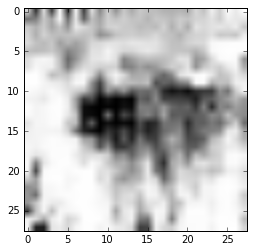

('Estimate:', array([[ 19.69805717]], dtype=float32))
('Iteration:', 54100, 'at', datetime.datetime(2017, 7, 7, 14, 30, 33, 243048))


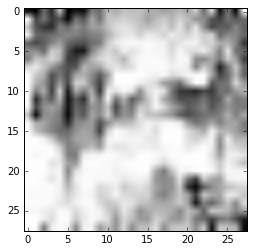

('Estimate:', array([[-11.90699005]], dtype=float32))
('Iteration:', 54200, 'at', datetime.datetime(2017, 7, 7, 14, 30, 39, 26618))


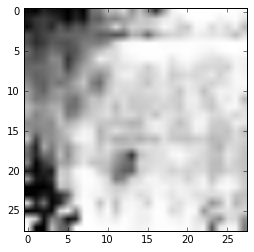

('Estimate:', array([[-0.87688303]], dtype=float32))
('Iteration:', 54300, 'at', datetime.datetime(2017, 7, 7, 14, 30, 44, 858939))


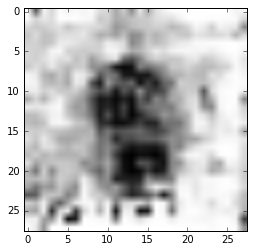

('Estimate:', array([[-5.26677179]], dtype=float32))
('Iteration:', 54400, 'at', datetime.datetime(2017, 7, 7, 14, 30, 53, 543498))


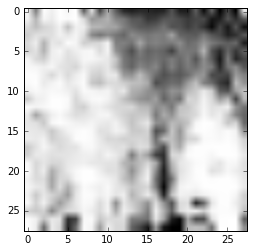

('Estimate:', array([[ 6.13622856]], dtype=float32))
('Iteration:', 54500, 'at', datetime.datetime(2017, 7, 7, 14, 30, 59, 254280))


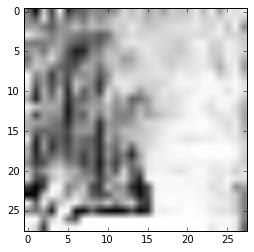

('Estimate:', array([[ 3.82948852]], dtype=float32))
('Iteration:', 54600, 'at', datetime.datetime(2017, 7, 7, 14, 31, 4, 994121))


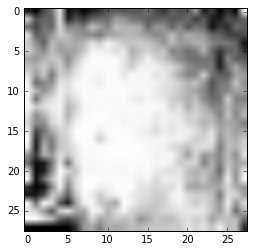

('Estimate:', array([[-3.12798357]], dtype=float32))
('Iteration:', 54700, 'at', datetime.datetime(2017, 7, 7, 14, 31, 11, 79802))


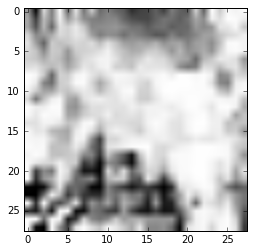

('Estimate:', array([[ 2.82025838]], dtype=float32))
('Iteration:', 54800, 'at', datetime.datetime(2017, 7, 7, 14, 31, 16, 852959))


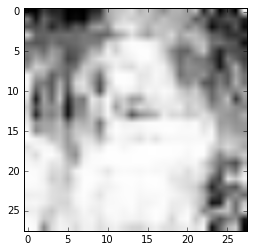

('Estimate:', array([[ 8.62846661]], dtype=float32))
('Iteration:', 54900, 'at', datetime.datetime(2017, 7, 7, 14, 31, 22, 568664))


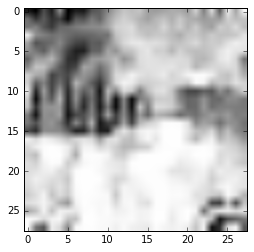

('Estimate:', array([[ 0.88464171]], dtype=float32))
('Iteration:', 55000, 'at', datetime.datetime(2017, 7, 7, 14, 31, 28, 411137))


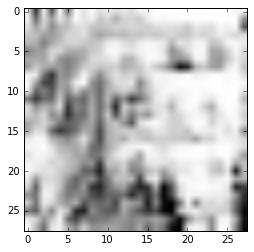

('Estimate:', array([[-9.69570255]], dtype=float32))
('Iteration:', 55100, 'at', datetime.datetime(2017, 7, 7, 14, 31, 33, 976051))


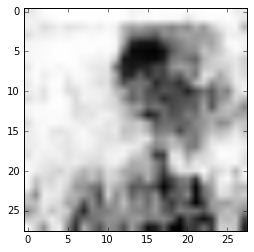

('Estimate:', array([[ 7.78685045]], dtype=float32))
('Iteration:', 55200, 'at', datetime.datetime(2017, 7, 7, 14, 31, 39, 756746))


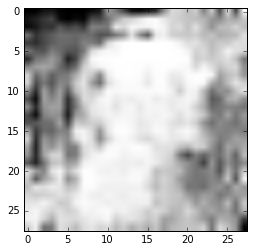

('Estimate:', array([[ 13.23111629]], dtype=float32))
('Iteration:', 55300, 'at', datetime.datetime(2017, 7, 7, 14, 31, 47, 75308))


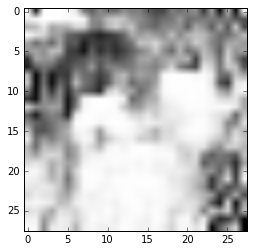

('Estimate:', array([[ 0.16704012]], dtype=float32))
('Iteration:', 55400, 'at', datetime.datetime(2017, 7, 7, 14, 31, 53, 152819))


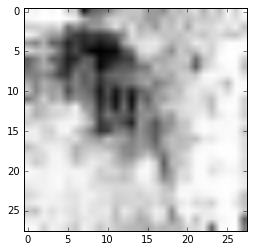

('Estimate:', array([[-6.48713636]], dtype=float32))
('Iteration:', 55500, 'at', datetime.datetime(2017, 7, 7, 14, 31, 58, 998782))


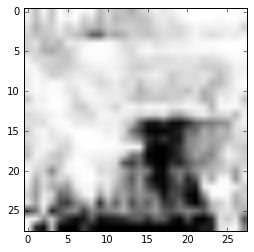

('Estimate:', array([[-0.00892339]], dtype=float32))
('Iteration:', 55600, 'at', datetime.datetime(2017, 7, 7, 14, 32, 4, 525438))


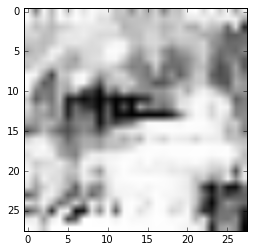

('Estimate:', array([[ 3.83118534]], dtype=float32))
('Iteration:', 55700, 'at', datetime.datetime(2017, 7, 7, 14, 32, 10, 704540))


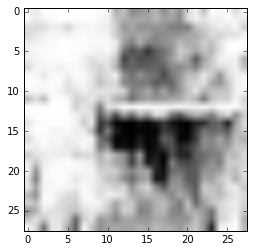

('Estimate:', array([[ 1.49632645]], dtype=float32))
('Iteration:', 55800, 'at', datetime.datetime(2017, 7, 7, 14, 32, 16, 443206))


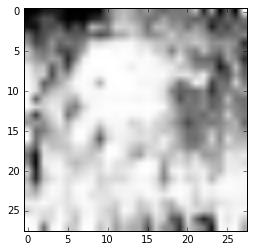

('Estimate:', array([[-0.30941802]], dtype=float32))
('Iteration:', 55900, 'at', datetime.datetime(2017, 7, 7, 14, 32, 22, 123360))


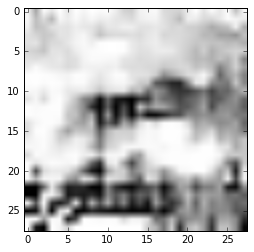

('Estimate:', array([[ 11.64212704]], dtype=float32))
('Iteration:', 56000, 'at', datetime.datetime(2017, 7, 7, 14, 32, 28, 54810))


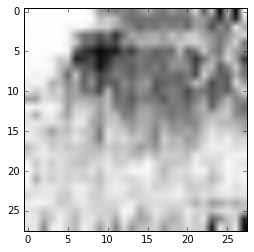

('Estimate:', array([[ 0.90449017]], dtype=float32))
('Iteration:', 56100, 'at', datetime.datetime(2017, 7, 7, 14, 32, 33, 982695))


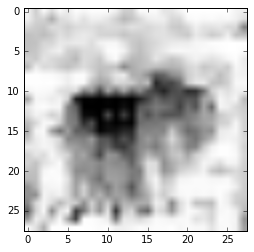

('Estimate:', array([[-10.07468128]], dtype=float32))
('Iteration:', 56200, 'at', datetime.datetime(2017, 7, 7, 14, 32, 41, 369738))


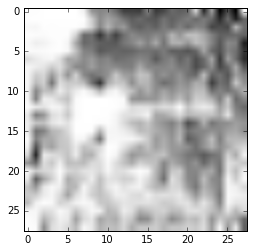

('Estimate:', array([[-9.90082455]], dtype=float32))
('Iteration:', 56300, 'at', datetime.datetime(2017, 7, 7, 14, 32, 47, 454386))


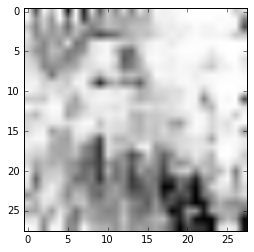

('Estimate:', array([[ 2.61858821]], dtype=float32))
('Iteration:', 56400, 'at', datetime.datetime(2017, 7, 7, 14, 32, 52, 958302))


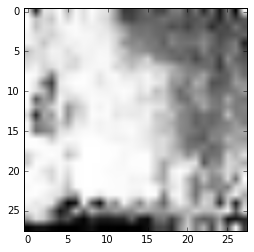

('Estimate:', array([[ 5.43244696]], dtype=float32))
('Iteration:', 56500, 'at', datetime.datetime(2017, 7, 7, 14, 32, 58, 756494))


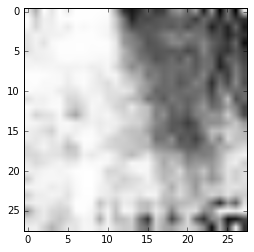

('Estimate:', array([[ 3.4800396]], dtype=float32))
('Iteration:', 56600, 'at', datetime.datetime(2017, 7, 7, 14, 33, 4, 418071))


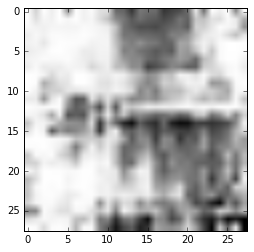

('Estimate:', array([[-0.88092411]], dtype=float32))
('Iteration:', 56700, 'at', datetime.datetime(2017, 7, 7, 14, 33, 10, 442588))


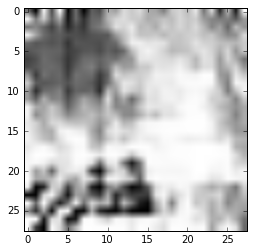

('Estimate:', array([[ 5.92969799]], dtype=float32))
('Iteration:', 56800, 'at', datetime.datetime(2017, 7, 7, 14, 33, 16, 371313))


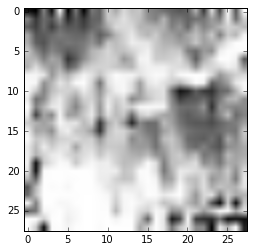

('Estimate:', array([[ 1.05718875]], dtype=float32))
('Iteration:', 56900, 'at', datetime.datetime(2017, 7, 7, 14, 33, 23, 34300))


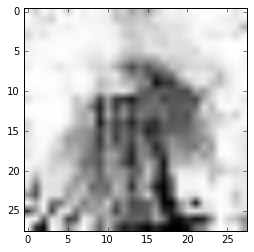

('Estimate:', array([[ 10.79685497]], dtype=float32))
('Iteration:', 57000, 'at', datetime.datetime(2017, 7, 7, 14, 33, 29, 263656))


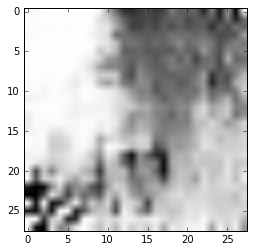

('Estimate:', array([[-1.17381048]], dtype=float32))
('Iteration:', 57100, 'at', datetime.datetime(2017, 7, 7, 14, 33, 36, 598638))


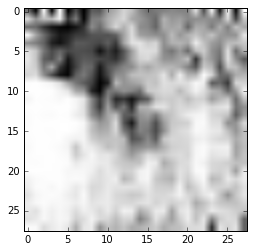

('Estimate:', array([[ 2.78814507]], dtype=float32))
('Iteration:', 57200, 'at', datetime.datetime(2017, 7, 7, 14, 33, 42, 833307))


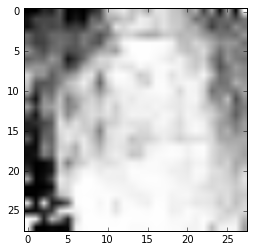

('Estimate:', array([[ 7.66816854]], dtype=float32))
('Iteration:', 57300, 'at', datetime.datetime(2017, 7, 7, 14, 33, 49, 67284))


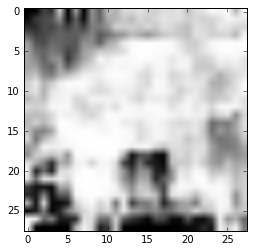

('Estimate:', array([[ 17.69944572]], dtype=float32))
('Iteration:', 57400, 'at', datetime.datetime(2017, 7, 7, 14, 33, 54, 687863))


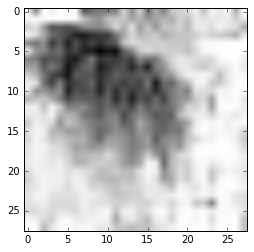

('Estimate:', array([[ 13.9685812]], dtype=float32))
('Iteration:', 57500, 'at', datetime.datetime(2017, 7, 7, 14, 34, 0, 621002))


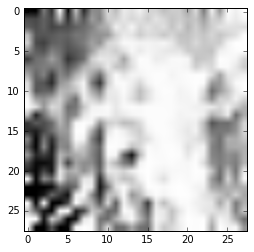

('Estimate:', array([[-1.3736223]], dtype=float32))
('Iteration:', 57600, 'at', datetime.datetime(2017, 7, 7, 14, 34, 6, 615769))


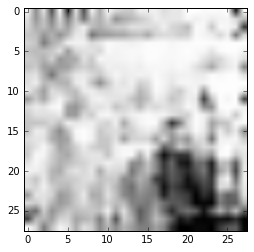

('Estimate:', array([[-10.27721405]], dtype=float32))
('Iteration:', 57700, 'at', datetime.datetime(2017, 7, 7, 14, 34, 12, 584428))


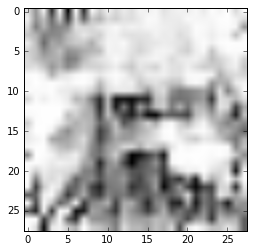

('Estimate:', array([[ 5.53701115]], dtype=float32))
('Iteration:', 57800, 'at', datetime.datetime(2017, 7, 7, 14, 34, 18, 517716))


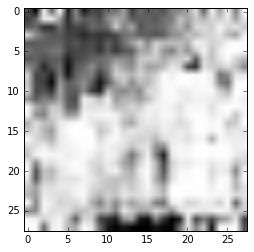

('Estimate:', array([[ 6.41509056]], dtype=float32))
('Iteration:', 57900, 'at', datetime.datetime(2017, 7, 7, 14, 34, 24, 776592))


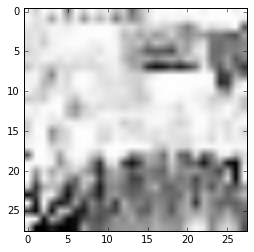

('Estimate:', array([[ 2.7258296]], dtype=float32))
('Iteration:', 58000, 'at', datetime.datetime(2017, 7, 7, 14, 34, 32, 143038))


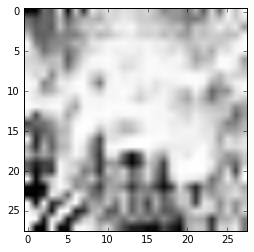

('Estimate:', array([[ 0.70115221]], dtype=float32))
('Iteration:', 58100, 'at', datetime.datetime(2017, 7, 7, 14, 34, 38, 49226))


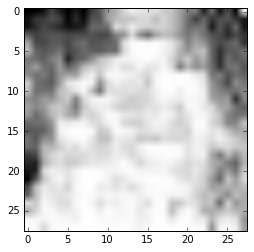

('Estimate:', array([[ 9.67043114]], dtype=float32))
('Iteration:', 58200, 'at', datetime.datetime(2017, 7, 7, 14, 34, 44, 636931))


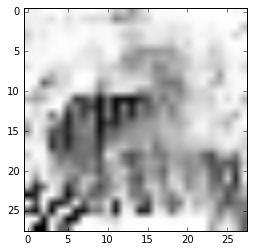

('Estimate:', array([[ 10.25585461]], dtype=float32))
('Iteration:', 58300, 'at', datetime.datetime(2017, 7, 7, 14, 34, 50, 896564))


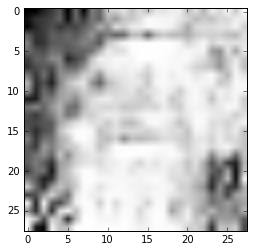

('Estimate:', array([[ 9.86730671]], dtype=float32))
('Iteration:', 58400, 'at', datetime.datetime(2017, 7, 7, 14, 34, 56, 849588))


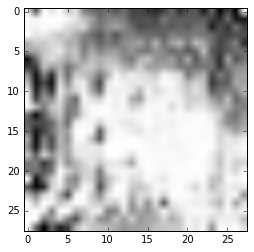

('Estimate:', array([[ 3.92304516]], dtype=float32))
('Iteration:', 58500, 'at', datetime.datetime(2017, 7, 7, 14, 35, 2, 505969))


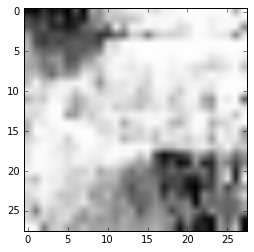

('Estimate:', array([[ 4.96713686]], dtype=float32))
('Iteration:', 58600, 'at', datetime.datetime(2017, 7, 7, 14, 35, 8, 594587))


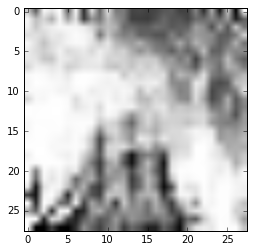

('Estimate:', array([[ 10.30441666]], dtype=float32))
('Iteration:', 58700, 'at', datetime.datetime(2017, 7, 7, 14, 35, 15, 214795))


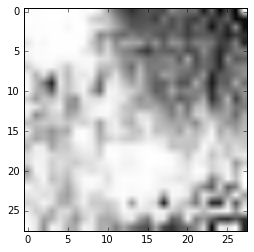

('Estimate:', array([[ 1.45499027]], dtype=float32))
('Iteration:', 58800, 'at', datetime.datetime(2017, 7, 7, 14, 35, 21, 652968))


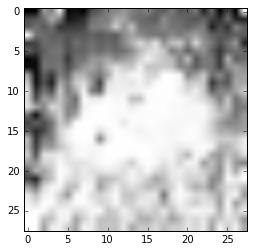

('Estimate:', array([[ 0.42196801]], dtype=float32))
('Iteration:', 58900, 'at', datetime.datetime(2017, 7, 7, 14, 35, 29, 475645))


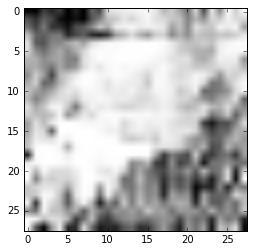

('Estimate:', array([[ 8.50809669]], dtype=float32))
('Iteration:', 59000, 'at', datetime.datetime(2017, 7, 7, 14, 35, 35, 219063))


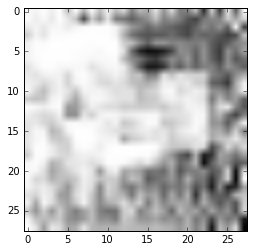

('Estimate:', array([[ 5.09656382]], dtype=float32))
('Iteration:', 59100, 'at', datetime.datetime(2017, 7, 7, 14, 35, 41, 53314))


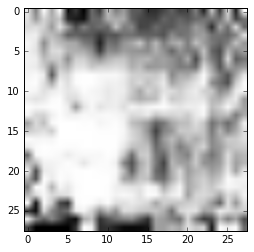

('Estimate:', array([[ 11.34115505]], dtype=float32))
('Iteration:', 59200, 'at', datetime.datetime(2017, 7, 7, 14, 35, 47, 243923))


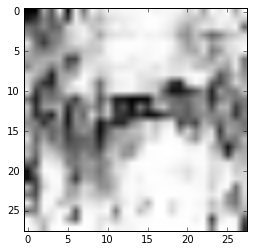

('Estimate:', array([[ 2.14845753]], dtype=float32))
('Iteration:', 59300, 'at', datetime.datetime(2017, 7, 7, 14, 35, 53, 721084))


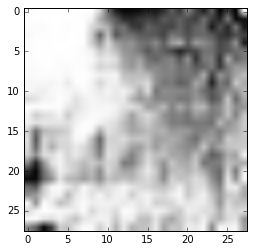

('Estimate:', array([[ 15.79152966]], dtype=float32))
('Iteration:', 59400, 'at', datetime.datetime(2017, 7, 7, 14, 35, 59, 838209))


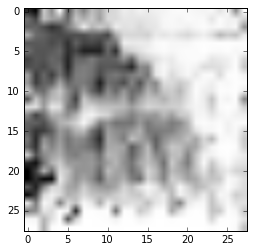

('Estimate:', array([[ 3.04256415]], dtype=float32))
('Iteration:', 59500, 'at', datetime.datetime(2017, 7, 7, 14, 36, 6, 427140))


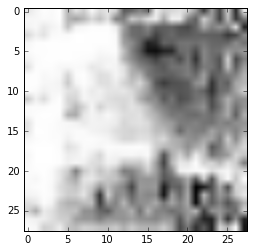

('Estimate:', array([[ 12.16245079]], dtype=float32))
('Iteration:', 59600, 'at', datetime.datetime(2017, 7, 7, 14, 36, 12, 399008))


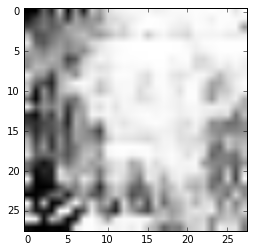

('Estimate:', array([[ 5.55877495]], dtype=float32))
('Iteration:', 59700, 'at', datetime.datetime(2017, 7, 7, 14, 36, 18, 248969))


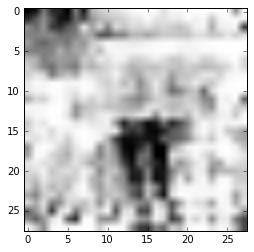

('Estimate:', array([[-15.52154636]], dtype=float32))
('Iteration:', 59800, 'at', datetime.datetime(2017, 7, 7, 14, 36, 25, 667346))


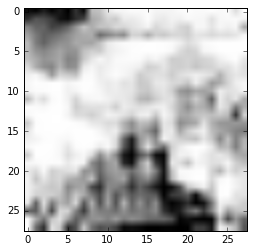

('Estimate:', array([[-2.94064665]], dtype=float32))
('Iteration:', 59900, 'at', datetime.datetime(2017, 7, 7, 14, 36, 31, 962488))


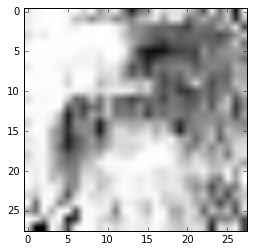

('Estimate:', array([[ 18.39095879]], dtype=float32))
('Iteration:', 60000, 'at', datetime.datetime(2017, 7, 7, 14, 36, 38, 900601))


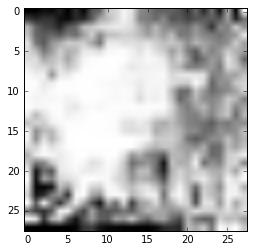

('Estimate:', array([[-8.23390102]], dtype=float32))
('Iteration:', 60100, 'at', datetime.datetime(2017, 7, 7, 14, 36, 44, 734292))


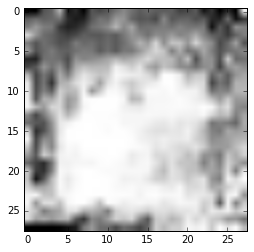

('Estimate:', array([[ 7.11422348]], dtype=float32))
('Iteration:', 60200, 'at', datetime.datetime(2017, 7, 7, 14, 36, 51, 458399))


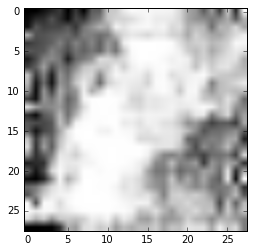

('Estimate:', array([[ 13.42555904]], dtype=float32))
('Iteration:', 60300, 'at', datetime.datetime(2017, 7, 7, 14, 36, 58, 206571))


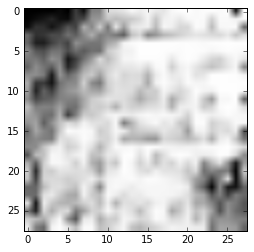

('Estimate:', array([[-1.27435434]], dtype=float32))
('Iteration:', 60400, 'at', datetime.datetime(2017, 7, 7, 14, 37, 4, 325555))


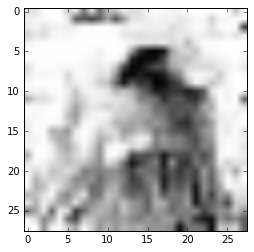

('Estimate:', array([[ 11.74274254]], dtype=float32))
('Iteration:', 60500, 'at', datetime.datetime(2017, 7, 7, 14, 37, 11, 136769))


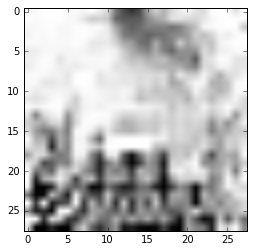

('Estimate:', array([[ 17.08898735]], dtype=float32))
('Iteration:', 60600, 'at', datetime.datetime(2017, 7, 7, 14, 37, 17, 523406))


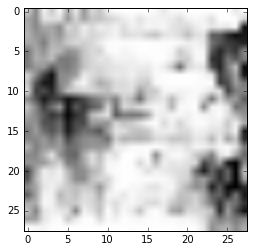

('Estimate:', array([[ 3.72603679]], dtype=float32))
('Iteration:', 60700, 'at', datetime.datetime(2017, 7, 7, 14, 37, 24, 799886))


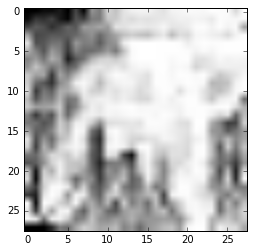

('Estimate:', array([[ 21.59840012]], dtype=float32))
('Iteration:', 60800, 'at', datetime.datetime(2017, 7, 7, 14, 37, 31, 68880))


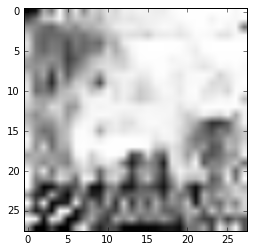

('Estimate:', array([[ 11.16141605]], dtype=float32))
('Iteration:', 60900, 'at', datetime.datetime(2017, 7, 7, 14, 37, 36, 951620))


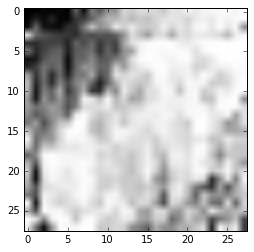

('Estimate:', array([[ 11.8338623]], dtype=float32))
('Iteration:', 61000, 'at', datetime.datetime(2017, 7, 7, 14, 37, 42, 984669))


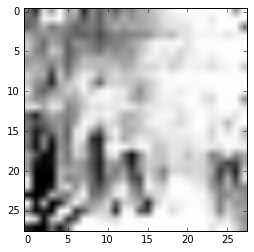

('Estimate:', array([[ 20.36609459]], dtype=float32))
('Iteration:', 61100, 'at', datetime.datetime(2017, 7, 7, 14, 37, 49, 441371))


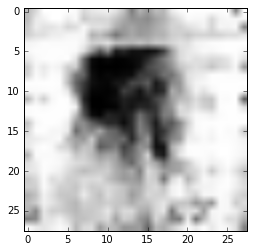

('Estimate:', array([[ 12.03066158]], dtype=float32))
('Iteration:', 61200, 'at', datetime.datetime(2017, 7, 7, 14, 37, 56, 654480))


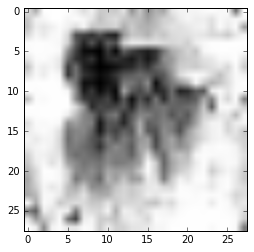

('Estimate:', array([[ 15.04756451]], dtype=float32))
('Iteration:', 61300, 'at', datetime.datetime(2017, 7, 7, 14, 38, 2, 680225))


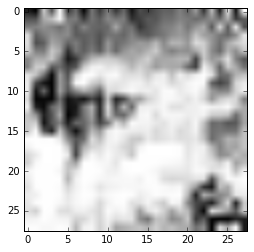

('Estimate:', array([[-1.39849019]], dtype=float32))
('Iteration:', 61400, 'at', datetime.datetime(2017, 7, 7, 14, 38, 8, 988221))


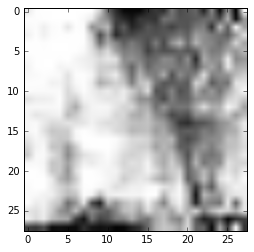

('Estimate:', array([[ 10.33053112]], dtype=float32))
('Iteration:', 61500, 'at', datetime.datetime(2017, 7, 7, 14, 38, 14, 993005))


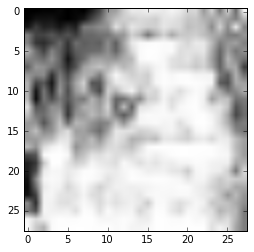

('Estimate:', array([[ 8.7045002]], dtype=float32))
('Iteration:', 61600, 'at', datetime.datetime(2017, 7, 7, 14, 38, 22, 152860))


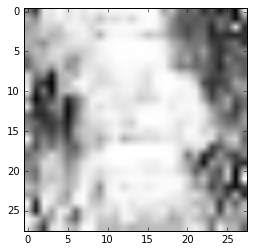

('Estimate:', array([[ 5.13422108]], dtype=float32))
('Iteration:', 61700, 'at', datetime.datetime(2017, 7, 7, 14, 38, 28, 181886))


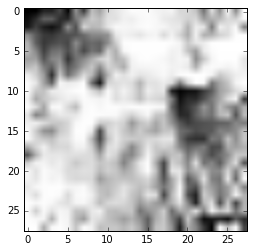

('Estimate:', array([[-1.84058201]], dtype=float32))
('Iteration:', 61800, 'at', datetime.datetime(2017, 7, 7, 14, 38, 34, 244307))


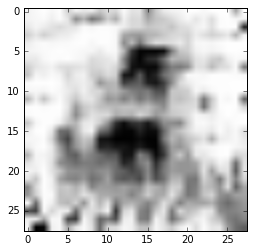

('Estimate:', array([[-9.93089199]], dtype=float32))
('Iteration:', 61900, 'at', datetime.datetime(2017, 7, 7, 14, 38, 41, 867671))


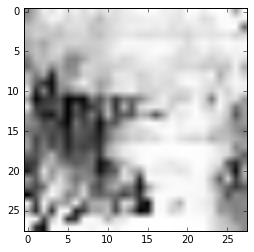

('Estimate:', array([[ 9.29559994]], dtype=float32))
('Iteration:', 62000, 'at', datetime.datetime(2017, 7, 7, 14, 38, 48, 286570))


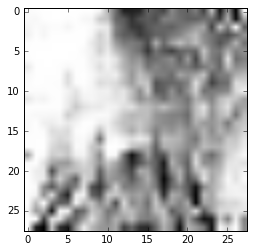

('Estimate:', array([[ 2.27383137]], dtype=float32))
('Iteration:', 62100, 'at', datetime.datetime(2017, 7, 7, 14, 38, 54, 526550))


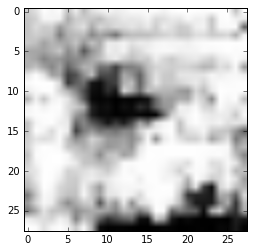

('Estimate:', array([[-5.76851559]], dtype=float32))
('Iteration:', 62200, 'at', datetime.datetime(2017, 7, 7, 14, 39, 0, 795404))


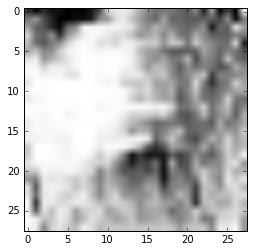

('Estimate:', array([[ 21.5298233]], dtype=float32))
('Iteration:', 62300, 'at', datetime.datetime(2017, 7, 7, 14, 39, 7, 151792))


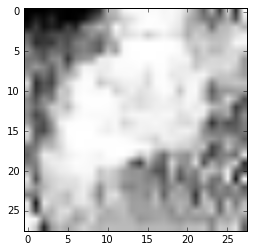

('Estimate:', array([[ 12.54447556]], dtype=float32))
('Iteration:', 62400, 'at', datetime.datetime(2017, 7, 7, 14, 39, 13, 687327))


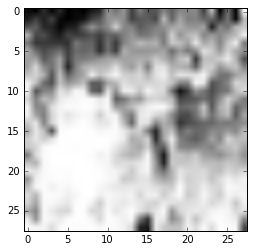

('Estimate:', array([[ 17.54470062]], dtype=float32))
('Iteration:', 62500, 'at', datetime.datetime(2017, 7, 7, 14, 39, 21, 229206))


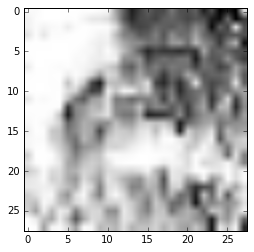

('Estimate:', array([[ 10.86033916]], dtype=float32))
('Iteration:', 62600, 'at', datetime.datetime(2017, 7, 7, 14, 39, 27, 529828))


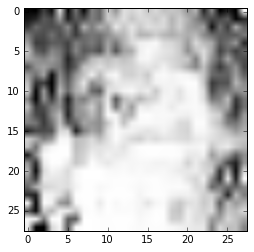

('Estimate:', array([[ 11.55116272]], dtype=float32))
('Iteration:', 62700, 'at', datetime.datetime(2017, 7, 7, 14, 39, 33, 608012))


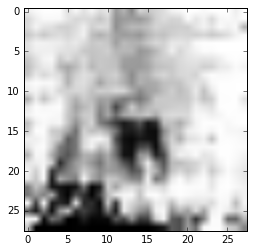

('Estimate:', array([[-3.28214741]], dtype=float32))
('Iteration:', 62800, 'at', datetime.datetime(2017, 7, 7, 14, 39, 39, 647339))


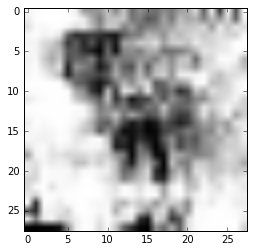

('Estimate:', array([[ 10.88656998]], dtype=float32))
('Iteration:', 62900, 'at', datetime.datetime(2017, 7, 7, 14, 39, 45, 941508))


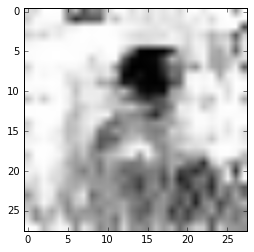

('Estimate:', array([[ 6.60163164]], dtype=float32))
('Iteration:', 63000, 'at', datetime.datetime(2017, 7, 7, 14, 39, 52, 143253))


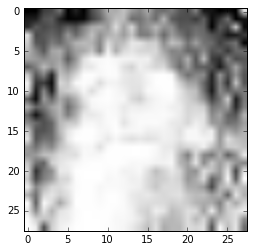

('Estimate:', array([[ 15.56279755]], dtype=float32))
('Iteration:', 63100, 'at', datetime.datetime(2017, 7, 7, 14, 39, 58, 311791))


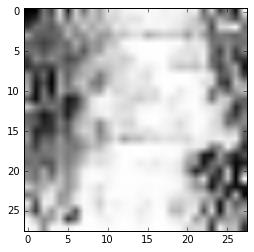

('Estimate:', array([[ 9.53664207]], dtype=float32))
('Iteration:', 63200, 'at', datetime.datetime(2017, 7, 7, 14, 40, 4, 386596))


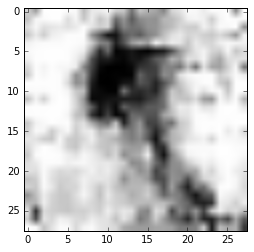

('Estimate:', array([[ 3.87506342]], dtype=float32))
('Iteration:', 63300, 'at', datetime.datetime(2017, 7, 7, 14, 40, 10, 987352))


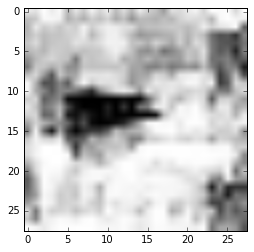

('Estimate:', array([[-6.11142683]], dtype=float32))
('Iteration:', 63400, 'at', datetime.datetime(2017, 7, 7, 14, 40, 19, 344842))


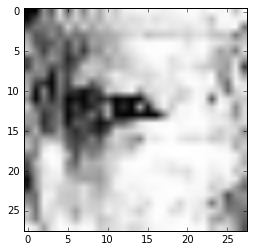

('Estimate:', array([[ 8.84508514]], dtype=float32))
('Iteration:', 63500, 'at', datetime.datetime(2017, 7, 7, 14, 40, 25, 504652))


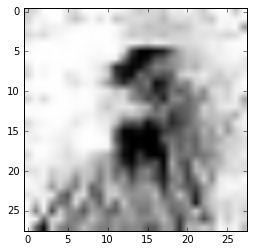

('Estimate:', array([[ 14.53138638]], dtype=float32))
('Iteration:', 63600, 'at', datetime.datetime(2017, 7, 7, 14, 40, 32, 126176))


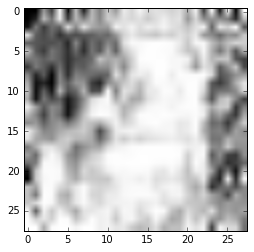

('Estimate:', array([[ 0.0429824]], dtype=float32))
('Iteration:', 63700, 'at', datetime.datetime(2017, 7, 7, 14, 40, 38, 154101))


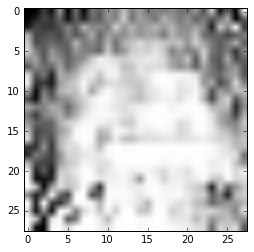

('Estimate:', array([[ 7.1274333]], dtype=float32))
('Iteration:', 63800, 'at', datetime.datetime(2017, 7, 7, 14, 40, 44, 167849))


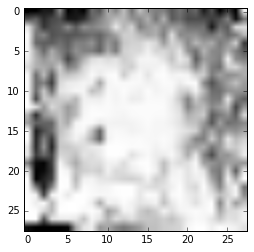

('Estimate:', array([[-1.71350861]], dtype=float32))
('Iteration:', 63900, 'at', datetime.datetime(2017, 7, 7, 14, 40, 50, 674896))


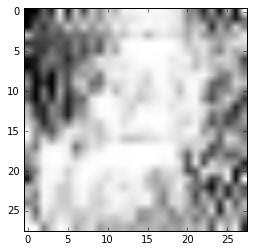

('Estimate:', array([[ 5.88831472]], dtype=float32))
('Iteration:', 64000, 'at', datetime.datetime(2017, 7, 7, 14, 40, 56, 734183))


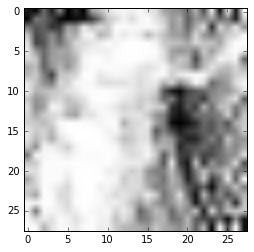

('Estimate:', array([[ 17.25757217]], dtype=float32))
('Iteration:', 64100, 'at', datetime.datetime(2017, 7, 7, 14, 41, 3, 40675))


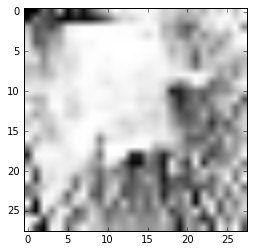

('Estimate:', array([[ 13.05016422]], dtype=float32))
('Iteration:', 64200, 'at', datetime.datetime(2017, 7, 7, 14, 41, 9, 541952))


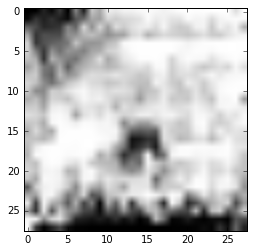

('Estimate:', array([[ 5.47222757]], dtype=float32))
('Iteration:', 64300, 'at', datetime.datetime(2017, 7, 7, 14, 41, 17, 123103))


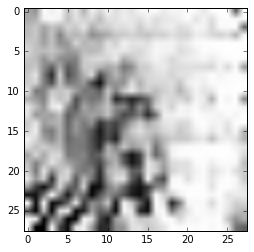

('Estimate:', array([[ 12.21754074]], dtype=float32))
('Iteration:', 64400, 'at', datetime.datetime(2017, 7, 7, 14, 41, 23, 237101))


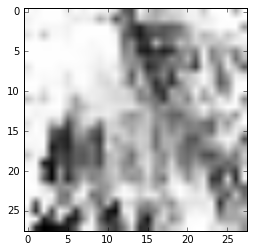

('Estimate:', array([[ 4.36613941]], dtype=float32))
('Iteration:', 64500, 'at', datetime.datetime(2017, 7, 7, 14, 41, 30, 14882))


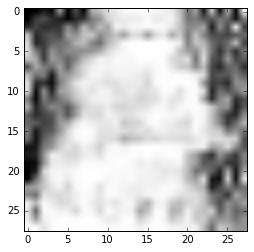

('Estimate:', array([[ 11.65650558]], dtype=float32))
('Iteration:', 64600, 'at', datetime.datetime(2017, 7, 7, 14, 41, 36, 244693))


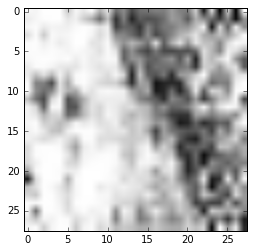

('Estimate:', array([[ 4.47669363]], dtype=float32))
('Iteration:', 64700, 'at', datetime.datetime(2017, 7, 7, 14, 41, 42, 305921))


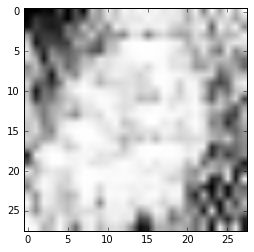

('Estimate:', array([[-2.46542525]], dtype=float32))
('Iteration:', 64800, 'at', datetime.datetime(2017, 7, 7, 14, 41, 49, 230633))


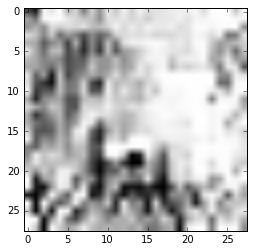

('Estimate:', array([[-1.68114853]], dtype=float32))
('Iteration:', 64900, 'at', datetime.datetime(2017, 7, 7, 14, 41, 55, 326314))


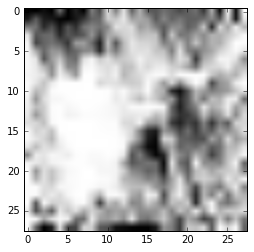

('Estimate:', array([[ 6.47707987]], dtype=float32))
('Iteration:', 65000, 'at', datetime.datetime(2017, 7, 7, 14, 42, 1, 586486))


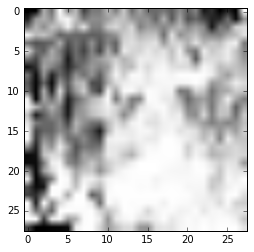

('Estimate:', array([[ 8.66689777]], dtype=float32))
('Iteration:', 65100, 'at', datetime.datetime(2017, 7, 7, 14, 42, 7, 982896))


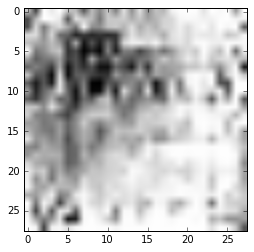

('Estimate:', array([[ 7.85445881]], dtype=float32))
('Iteration:', 65200, 'at', datetime.datetime(2017, 7, 7, 14, 42, 16, 741293))


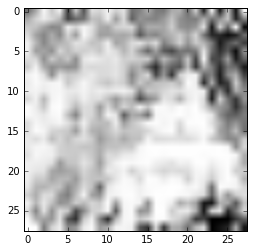

('Estimate:', array([[-2.49438405]], dtype=float32))
('Iteration:', 65300, 'at', datetime.datetime(2017, 7, 7, 14, 42, 23, 441085))


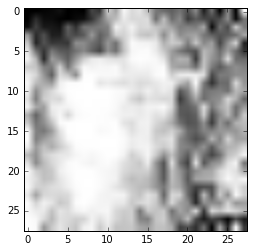

('Estimate:', array([[ 14.86895466]], dtype=float32))
('Iteration:', 65400, 'at', datetime.datetime(2017, 7, 7, 14, 42, 31, 336855))


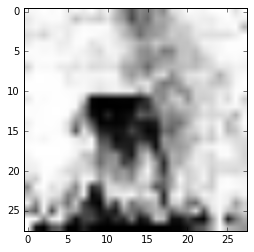

('Estimate:', array([[ 10.11535072]], dtype=float32))
('Iteration:', 65500, 'at', datetime.datetime(2017, 7, 7, 14, 42, 37, 821314))


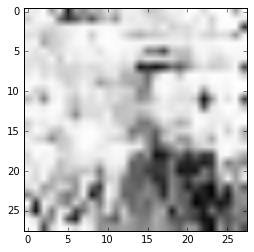

('Estimate:', array([[-10.54866982]], dtype=float32))
('Iteration:', 65600, 'at', datetime.datetime(2017, 7, 7, 14, 42, 44, 147249))


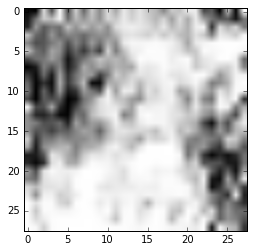

('Estimate:', array([[ 8.15136528]], dtype=float32))
('Iteration:', 65700, 'at', datetime.datetime(2017, 7, 7, 14, 42, 50, 994187))


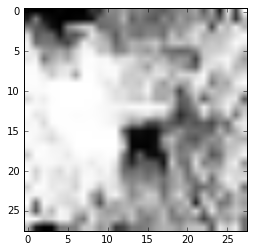

('Estimate:', array([[ 9.24312115]], dtype=float32))
('Iteration:', 65800, 'at', datetime.datetime(2017, 7, 7, 14, 42, 57, 149268))


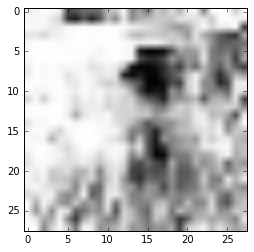

('Estimate:', array([[ 11.61978054]], dtype=float32))
('Iteration:', 65900, 'at', datetime.datetime(2017, 7, 7, 14, 43, 3, 447527))


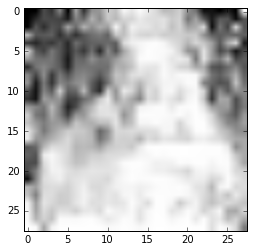

('Estimate:', array([[ 14.36411285]], dtype=float32))
('Iteration:', 66000, 'at', datetime.datetime(2017, 7, 7, 14, 43, 10, 141195))


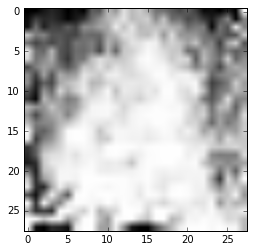

('Estimate:', array([[ 5.36963224]], dtype=float32))
('Iteration:', 66100, 'at', datetime.datetime(2017, 7, 7, 14, 43, 17, 822793))


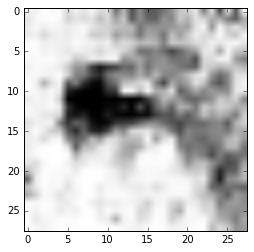

('Estimate:', array([[ 10.82710552]], dtype=float32))
('Iteration:', 66200, 'at', datetime.datetime(2017, 7, 7, 14, 43, 24, 13910))


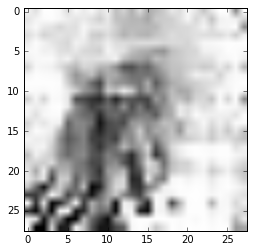

('Estimate:', array([[ 15.88165379]], dtype=float32))
('Iteration:', 66300, 'at', datetime.datetime(2017, 7, 7, 14, 43, 30, 309618))


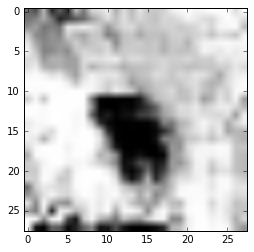

('Estimate:', array([[-2.12122631]], dtype=float32))
('Iteration:', 66400, 'at', datetime.datetime(2017, 7, 7, 14, 43, 36, 405018))


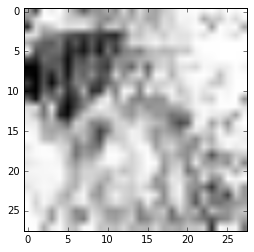

('Estimate:', array([[ 5.33787012]], dtype=float32))
('Iteration:', 66500, 'at', datetime.datetime(2017, 7, 7, 14, 43, 42, 734070))


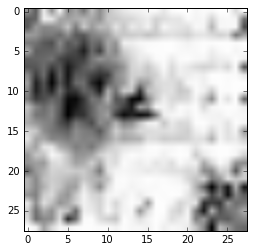

('Estimate:', array([[ 2.63860464]], dtype=float32))
('Iteration:', 66600, 'at', datetime.datetime(2017, 7, 7, 14, 43, 49, 114344))


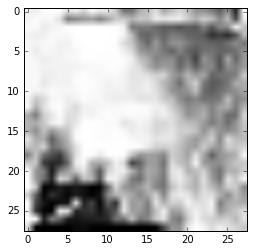

('Estimate:', array([[-1.44235456]], dtype=float32))
('Iteration:', 66700, 'at', datetime.datetime(2017, 7, 7, 14, 43, 55, 498935))


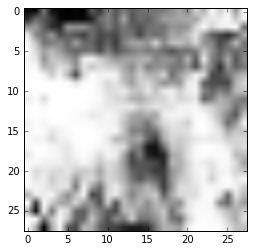

('Estimate:', array([[ 17.7117672]], dtype=float32))
('Iteration:', 66800, 'at', datetime.datetime(2017, 7, 7, 14, 44, 1, 822706))


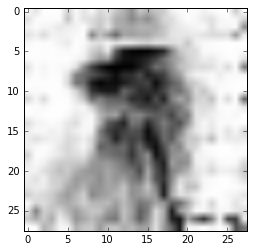

('Estimate:', array([[ 11.61488533]], dtype=float32))
('Iteration:', 66900, 'at', datetime.datetime(2017, 7, 7, 14, 44, 8, 623277))


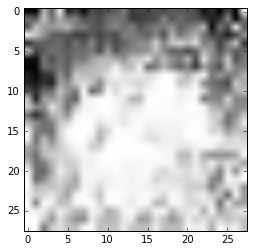

('Estimate:', array([[ 10.45886326]], dtype=float32))
('Iteration:', 67000, 'at', datetime.datetime(2017, 7, 7, 14, 44, 17, 221338))


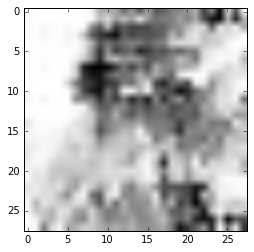

('Estimate:', array([[ 4.51793003]], dtype=float32))
('Iteration:', 67100, 'at', datetime.datetime(2017, 7, 7, 14, 44, 23, 418724))


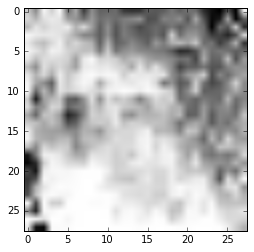

('Estimate:', array([[ 23.53341484]], dtype=float32))
('Iteration:', 67200, 'at', datetime.datetime(2017, 7, 7, 14, 44, 30, 517214))


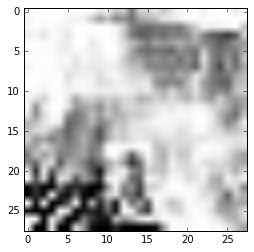

('Estimate:', array([[-0.05777744]], dtype=float32))
('Iteration:', 67300, 'at', datetime.datetime(2017, 7, 7, 14, 44, 37, 176483))


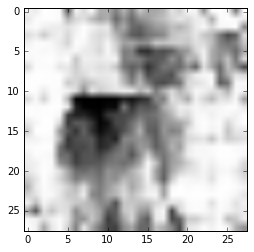

('Estimate:', array([[ 10.12107086]], dtype=float32))
('Iteration:', 67400, 'at', datetime.datetime(2017, 7, 7, 14, 44, 43, 408087))


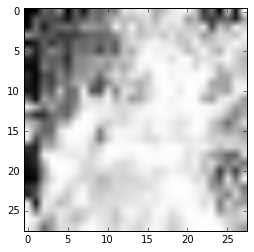

('Estimate:', array([[-11.3566637]], dtype=float32))
('Iteration:', 67500, 'at', datetime.datetime(2017, 7, 7, 14, 44, 50, 324005))


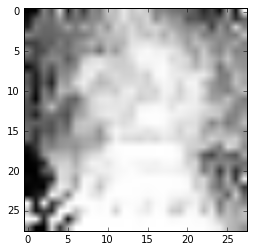

('Estimate:', array([[ 3.9305985]], dtype=float32))
('Iteration:', 67600, 'at', datetime.datetime(2017, 7, 7, 14, 44, 56, 681306))


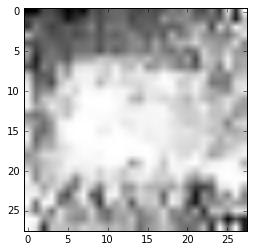

('Estimate:', array([[ 13.93148994]], dtype=float32))
('Iteration:', 67700, 'at', datetime.datetime(2017, 7, 7, 14, 45, 3, 153682))


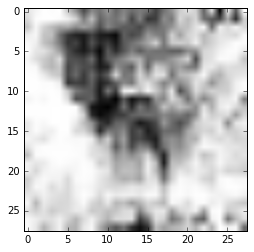

('Estimate:', array([[ 9.96089458]], dtype=float32))
('Iteration:', 67800, 'at', datetime.datetime(2017, 7, 7, 14, 45, 10, 325836))


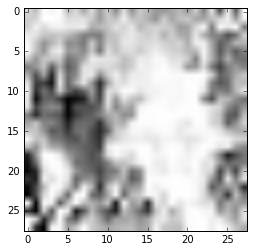

('Estimate:', array([[-10.1939888]], dtype=float32))
('Iteration:', 67900, 'at', datetime.datetime(2017, 7, 7, 14, 45, 18, 308088))


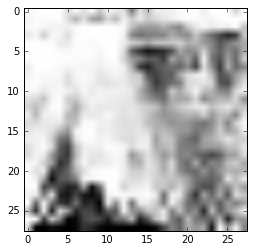

('Estimate:', array([[ 4.96897078]], dtype=float32))
('Iteration:', 68000, 'at', datetime.datetime(2017, 7, 7, 14, 45, 24, 767302))


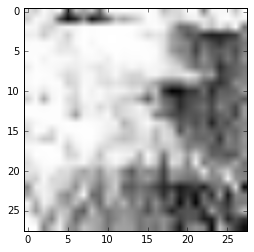

('Estimate:', array([[ 8.78423882]], dtype=float32))
('Iteration:', 68100, 'at', datetime.datetime(2017, 7, 7, 14, 45, 31, 680147))


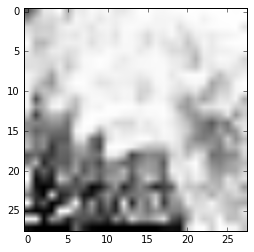

('Estimate:', array([[ 5.38889551]], dtype=float32))
('Iteration:', 68200, 'at', datetime.datetime(2017, 7, 7, 14, 45, 38, 107822))


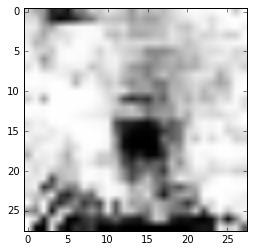

('Estimate:', array([[-5.33892441]], dtype=float32))
('Iteration:', 68300, 'at', datetime.datetime(2017, 7, 7, 14, 45, 44, 555876))


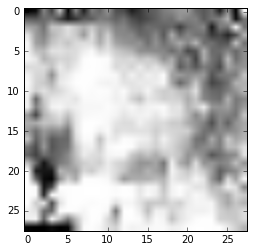

('Estimate:', array([[ 6.97525787]], dtype=float32))
('Iteration:', 68400, 'at', datetime.datetime(2017, 7, 7, 14, 45, 51, 762514))


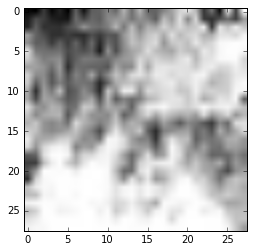

('Estimate:', array([[ 17.51074791]], dtype=float32))
('Iteration:', 68500, 'at', datetime.datetime(2017, 7, 7, 14, 45, 58, 895628))


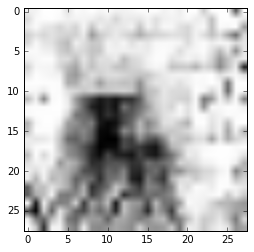

('Estimate:', array([[-19.94520187]], dtype=float32))
('Iteration:', 68600, 'at', datetime.datetime(2017, 7, 7, 14, 46, 6, 164164))


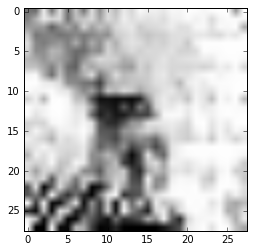

('Estimate:', array([[-1.54606247]], dtype=float32))
('Iteration:', 68700, 'at', datetime.datetime(2017, 7, 7, 14, 46, 13, 195825))


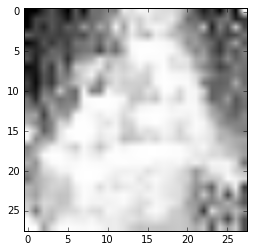

('Estimate:', array([[ 11.11175346]], dtype=float32))
('Iteration:', 68800, 'at', datetime.datetime(2017, 7, 7, 14, 46, 22, 113516))


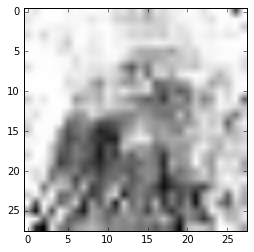

('Estimate:', array([[ 9.59938431]], dtype=float32))
('Iteration:', 68900, 'at', datetime.datetime(2017, 7, 7, 14, 46, 28, 744110))


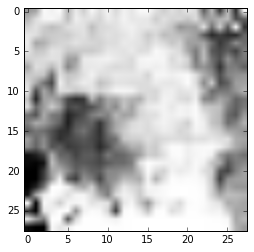

('Estimate:', array([[-6.15851116]], dtype=float32))
('Iteration:', 69000, 'at', datetime.datetime(2017, 7, 7, 14, 46, 35, 204411))


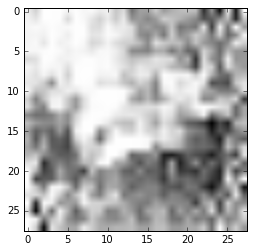

('Estimate:', array([[ 10.8263998]], dtype=float32))
('Iteration:', 69100, 'at', datetime.datetime(2017, 7, 7, 14, 46, 41, 603426))


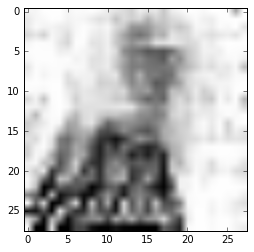

('Estimate:', array([[ 9.70197487]], dtype=float32))
('Iteration:', 69200, 'at', datetime.datetime(2017, 7, 7, 14, 46, 48, 199701))


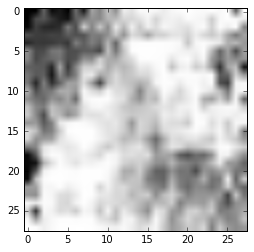

('Estimate:', array([[ 1.3220706]], dtype=float32))
('Iteration:', 69300, 'at', datetime.datetime(2017, 7, 7, 14, 46, 54, 572164))


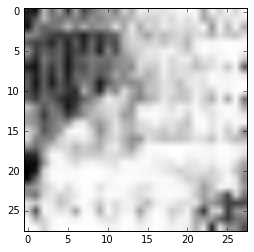

('Estimate:', array([[-1.54265118]], dtype=float32))
('Iteration:', 69400, 'at', datetime.datetime(2017, 7, 7, 14, 47, 1, 470662))


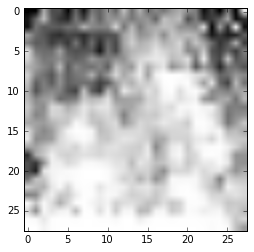

('Estimate:', array([[ 14.96785927]], dtype=float32))
('Iteration:', 69500, 'at', datetime.datetime(2017, 7, 7, 14, 47, 9, 76219))


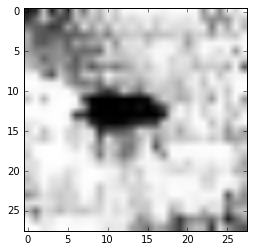

('Estimate:', array([[-11.67149734]], dtype=float32))
('Iteration:', 69600, 'at', datetime.datetime(2017, 7, 7, 14, 47, 15, 989516))


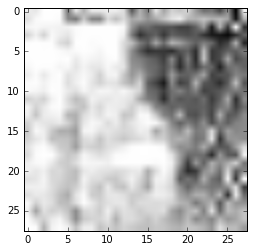

('Estimate:', array([[ 7.39009809]], dtype=float32))
('Iteration:', 69700, 'at', datetime.datetime(2017, 7, 7, 14, 47, 23, 947317))


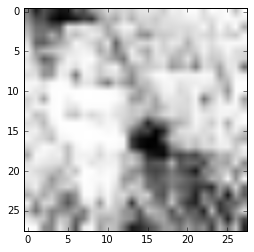

('Estimate:', array([[-4.9358263]], dtype=float32))
('Iteration:', 69800, 'at', datetime.datetime(2017, 7, 7, 14, 47, 30, 958410))


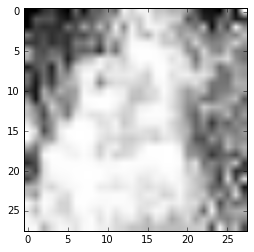

('Estimate:', array([[ 0.16348553]], dtype=float32))
('Iteration:', 69900, 'at', datetime.datetime(2017, 7, 7, 14, 47, 37, 806723))


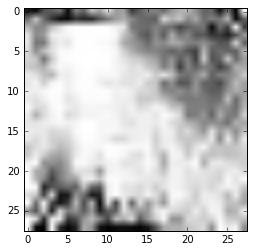

('Estimate:', array([[ 8.78905964]], dtype=float32))
('Iteration:', 70000, 'at', datetime.datetime(2017, 7, 7, 14, 47, 44, 483937))


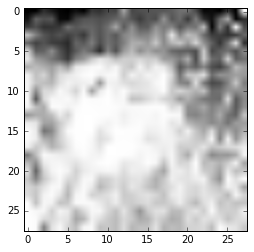

('Estimate:', array([[ 13.17018318]], dtype=float32))
('Iteration:', 70100, 'at', datetime.datetime(2017, 7, 7, 14, 47, 51, 319403))


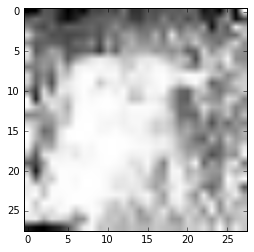

('Estimate:', array([[ 14.51671886]], dtype=float32))
('Iteration:', 70200, 'at', datetime.datetime(2017, 7, 7, 14, 47, 58, 537001))


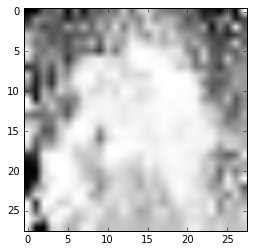

('Estimate:', array([[-13.21879482]], dtype=float32))
('Iteration:', 70300, 'at', datetime.datetime(2017, 7, 7, 14, 48, 5, 176741))


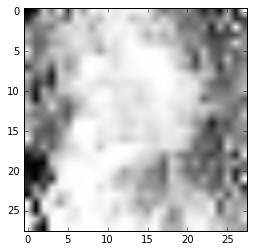

('Estimate:', array([[ 15.37126541]], dtype=float32))
('Iteration:', 70400, 'at', datetime.datetime(2017, 7, 7, 14, 48, 12, 537036))


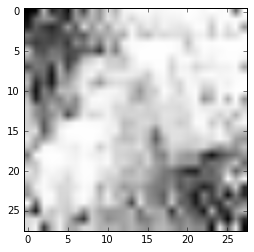

('Estimate:', array([[ 4.45782328]], dtype=float32))
('Iteration:', 70500, 'at', datetime.datetime(2017, 7, 7, 14, 48, 19, 7652))


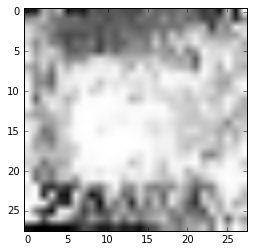

('Estimate:', array([[ 0.37016544]], dtype=float32))
('Iteration:', 70600, 'at', datetime.datetime(2017, 7, 7, 14, 48, 26, 433252))


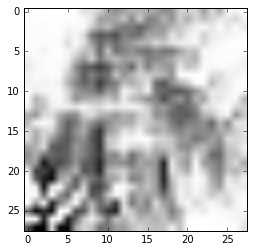

('Estimate:', array([[ 23.46042633]], dtype=float32))
('Iteration:', 70700, 'at', datetime.datetime(2017, 7, 7, 14, 48, 33, 185900))


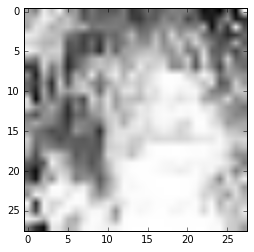

('Estimate:', array([[ 6.65725946]], dtype=float32))
('Iteration:', 70800, 'at', datetime.datetime(2017, 7, 7, 14, 48, 39, 610935))


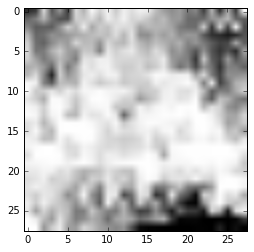

('Estimate:', array([[ 16.11099434]], dtype=float32))
('Iteration:', 70900, 'at', datetime.datetime(2017, 7, 7, 14, 48, 48, 309611))


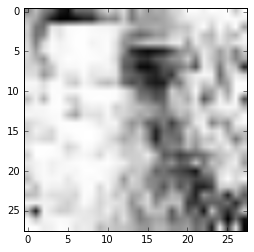

('Estimate:', array([[ 7.92751932]], dtype=float32))
('Iteration:', 71000, 'at', datetime.datetime(2017, 7, 7, 14, 48, 54, 966620))


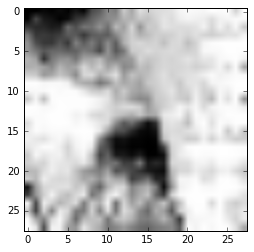

('Estimate:', array([[ 3.28376055]], dtype=float32))
('Iteration:', 71100, 'at', datetime.datetime(2017, 7, 7, 14, 49, 1, 747290))


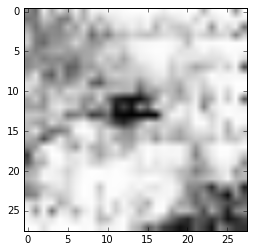

('Estimate:', array([[-27.54661942]], dtype=float32))
('Iteration:', 71200, 'at', datetime.datetime(2017, 7, 7, 14, 49, 8, 787468))


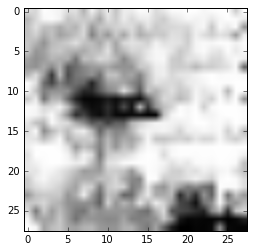

('Estimate:', array([[-20.09478188]], dtype=float32))
('Iteration:', 71300, 'at', datetime.datetime(2017, 7, 7, 14, 49, 16, 191093))


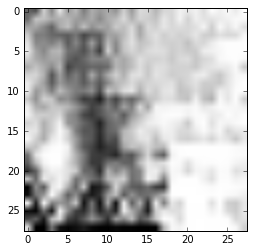

('Estimate:', array([[ 6.78241682]], dtype=float32))
('Iteration:', 71400, 'at', datetime.datetime(2017, 7, 7, 14, 49, 23, 55651))


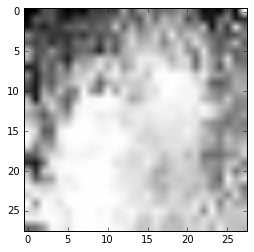

('Estimate:', array([[ 1.65093207]], dtype=float32))
('Iteration:', 71500, 'at', datetime.datetime(2017, 7, 7, 14, 49, 31, 381596))


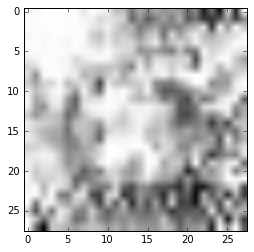

('Estimate:', array([[-1.74770439]], dtype=float32))
('Iteration:', 71600, 'at', datetime.datetime(2017, 7, 7, 14, 49, 38, 321620))


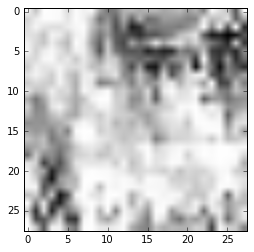

('Estimate:', array([[-0.49924302]], dtype=float32))
('Iteration:', 71700, 'at', datetime.datetime(2017, 7, 7, 14, 49, 45, 25667))


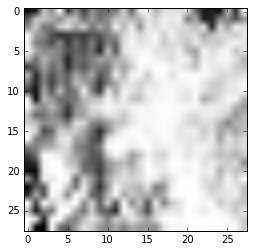

('Estimate:', array([[-12.49799156]], dtype=float32))
('Iteration:', 71800, 'at', datetime.datetime(2017, 7, 7, 14, 49, 52, 81466))


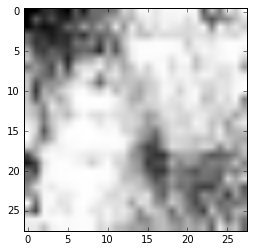

('Estimate:', array([[ 7.14995623]], dtype=float32))
('Iteration:', 71900, 'at', datetime.datetime(2017, 7, 7, 14, 49, 58, 781178))


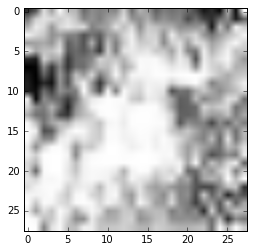

('Estimate:', array([[-1.19035721]], dtype=float32))
('Iteration:', 72000, 'at', datetime.datetime(2017, 7, 7, 14, 50, 5, 501508))


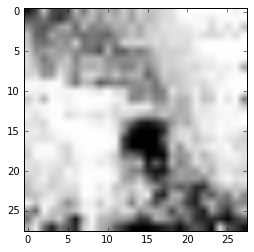

('Estimate:', array([[-0.7690255]], dtype=float32))
('Iteration:', 72100, 'at', datetime.datetime(2017, 7, 7, 14, 50, 12, 820338))


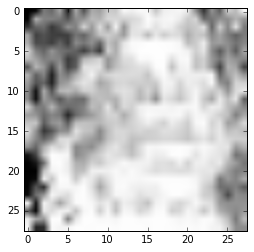

('Estimate:', array([[ 13.00358772]], dtype=float32))
('Iteration:', 72200, 'at', datetime.datetime(2017, 7, 7, 14, 50, 19, 374082))


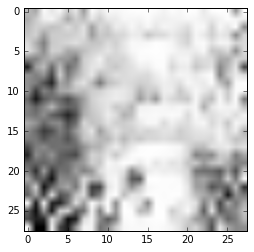

('Estimate:', array([[-11.40919113]], dtype=float32))
('Iteration:', 72300, 'at', datetime.datetime(2017, 7, 7, 14, 50, 26, 312488))


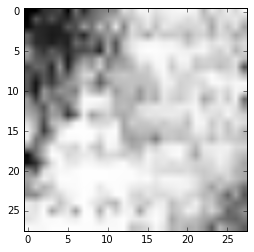

('Estimate:', array([[ 1.49322391]], dtype=float32))
('Iteration:', 72400, 'at', datetime.datetime(2017, 7, 7, 14, 50, 34, 491604))


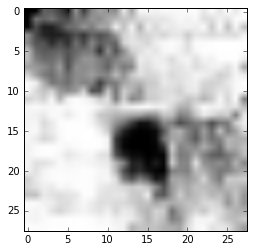

('Estimate:', array([[ 24.57509995]], dtype=float32))
('Iteration:', 72500, 'at', datetime.datetime(2017, 7, 7, 14, 50, 41, 167321))


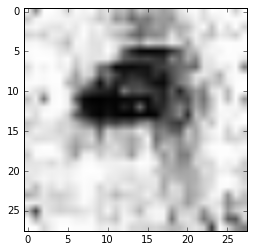

('Estimate:', array([[ 4.31670713]], dtype=float32))
('Iteration:', 72600, 'at', datetime.datetime(2017, 7, 7, 14, 50, 48, 3522))


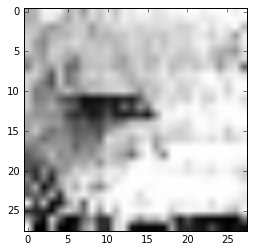

('Estimate:', array([[ 9.32456684]], dtype=float32))
('Iteration:', 72700, 'at', datetime.datetime(2017, 7, 7, 14, 50, 54, 633999))


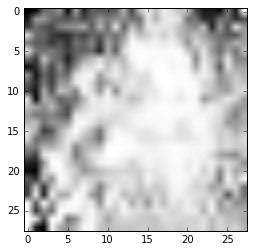

('Estimate:', array([[-1.78701484]], dtype=float32))
('Iteration:', 72800, 'at', datetime.datetime(2017, 7, 7, 14, 51, 1, 327752))


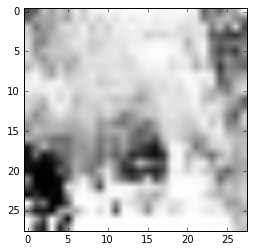

('Estimate:', array([[-3.73640776]], dtype=float32))
('Iteration:', 72900, 'at', datetime.datetime(2017, 7, 7, 14, 51, 8, 9153))


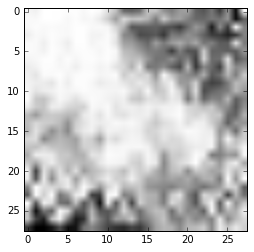

('Estimate:', array([[-7.76482773]], dtype=float32))
('Iteration:', 73000, 'at', datetime.datetime(2017, 7, 7, 14, 51, 14, 586183))


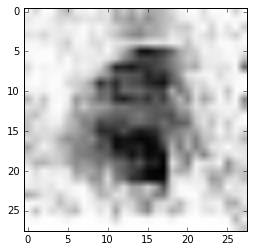

('Estimate:', array([[ 15.73522472]], dtype=float32))
('Iteration:', 73100, 'at', datetime.datetime(2017, 7, 7, 14, 51, 21, 294069))


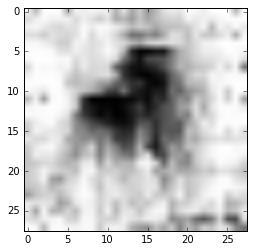

('Estimate:', array([[ 0.88891095]], dtype=float32))
('Iteration:', 73200, 'at', datetime.datetime(2017, 7, 7, 14, 51, 28, 63729))


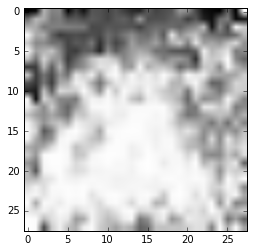

('Estimate:', array([[-4.85930872]], dtype=float32))
('Iteration:', 73300, 'at', datetime.datetime(2017, 7, 7, 14, 51, 35, 949934))


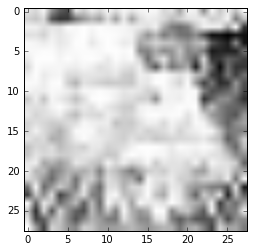

('Estimate:', array([[-0.66607791]], dtype=float32))
('Iteration:', 73400, 'at', datetime.datetime(2017, 7, 7, 14, 51, 42, 905765))


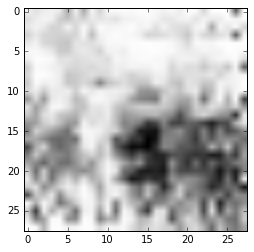

('Estimate:', array([[-3.43408561]], dtype=float32))
('Iteration:', 73500, 'at', datetime.datetime(2017, 7, 7, 14, 51, 49, 670282))


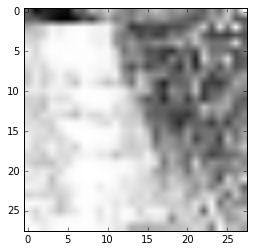

('Estimate:', array([[ 21.19241142]], dtype=float32))
('Iteration:', 73600, 'at', datetime.datetime(2017, 7, 7, 14, 51, 56, 357013))


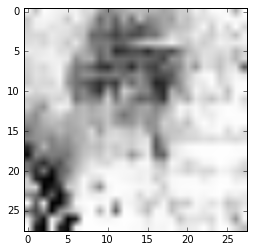

('Estimate:', array([[ 10.47441959]], dtype=float32))
('Iteration:', 73700, 'at', datetime.datetime(2017, 7, 7, 14, 52, 3, 220082))


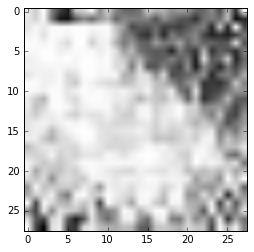

('Estimate:', array([[ 8.45928097]], dtype=float32))
('Iteration:', 73800, 'at', datetime.datetime(2017, 7, 7, 14, 52, 10, 501980))


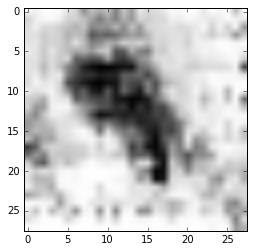

('Estimate:', array([[ 11.00939083]], dtype=float32))
('Iteration:', 73900, 'at', datetime.datetime(2017, 7, 7, 14, 52, 17, 195215))


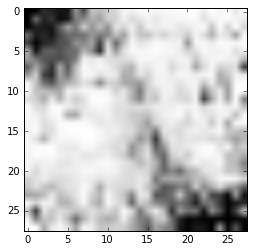

('Estimate:', array([[-8.61472416]], dtype=float32))
('Iteration:', 74000, 'at', datetime.datetime(2017, 7, 7, 14, 52, 24, 129775))


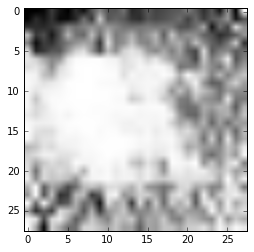

('Estimate:', array([[-15.47233772]], dtype=float32))
('Iteration:', 74100, 'at', datetime.datetime(2017, 7, 7, 14, 52, 31, 576527))


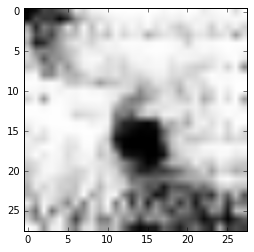

('Estimate:', array([[-2.35212159]], dtype=float32))
('Iteration:', 74200, 'at', datetime.datetime(2017, 7, 7, 14, 52, 39, 661132))


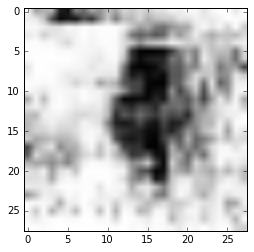

('Estimate:', array([[-5.1607151]], dtype=float32))
('Iteration:', 74300, 'at', datetime.datetime(2017, 7, 7, 14, 52, 46, 621279))


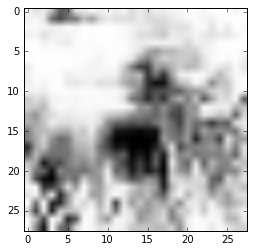

('Estimate:', array([[-10.33718491]], dtype=float32))
('Iteration:', 74400, 'at', datetime.datetime(2017, 7, 7, 14, 52, 53, 671353))


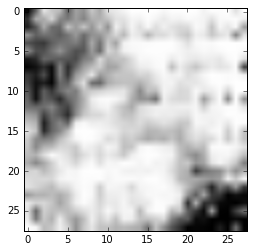

('Estimate:', array([[-24.23441505]], dtype=float32))
('Iteration:', 74500, 'at', datetime.datetime(2017, 7, 7, 14, 53, 0, 689994))


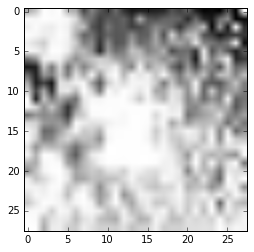

('Estimate:', array([[-1.64394844]], dtype=float32))
('Iteration:', 74600, 'at', datetime.datetime(2017, 7, 7, 14, 53, 7, 937792))


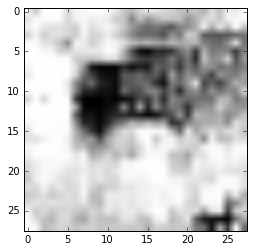

('Estimate:', array([[ 24.24660683]], dtype=float32))
('Iteration:', 74700, 'at', datetime.datetime(2017, 7, 7, 14, 53, 15, 134912))


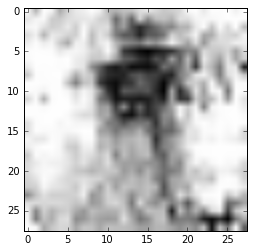

('Estimate:', array([[-9.3833828]], dtype=float32))
('Iteration:', 74800, 'at', datetime.datetime(2017, 7, 7, 14, 53, 22, 150479))


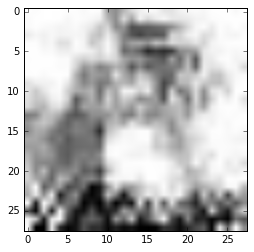

('Estimate:', array([[-23.52084541]], dtype=float32))
('Iteration:', 74900, 'at', datetime.datetime(2017, 7, 7, 14, 53, 29, 525493))


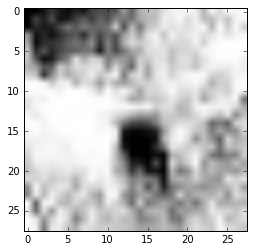

('Estimate:', array([[ 10.68340588]], dtype=float32))
('Iteration:', 75000, 'at', datetime.datetime(2017, 7, 7, 14, 53, 36, 436197))


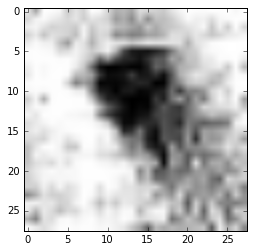

('Estimate:', array([[ 13.40365982]], dtype=float32))
('Iteration:', 75100, 'at', datetime.datetime(2017, 7, 7, 14, 53, 44, 571844))


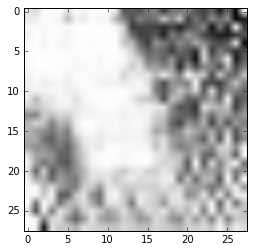

('Estimate:', array([[ 0.06798133]], dtype=float32))
('Iteration:', 75200, 'at', datetime.datetime(2017, 7, 7, 14, 53, 51, 904942))


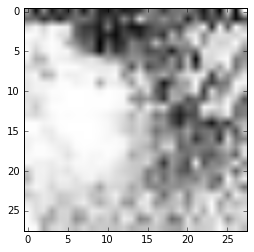

('Estimate:', array([[ 13.76750946]], dtype=float32))
('Iteration:', 75300, 'at', datetime.datetime(2017, 7, 7, 14, 53, 58, 720192))


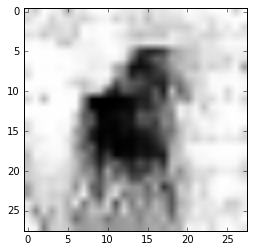

('Estimate:', array([[ 15.28392315]], dtype=float32))
('Iteration:', 75400, 'at', datetime.datetime(2017, 7, 7, 14, 54, 5, 308348))


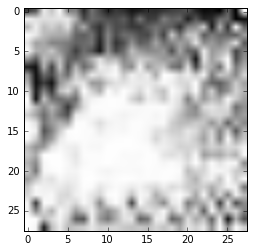

('Estimate:', array([[-1.77470279]], dtype=float32))
('Iteration:', 75500, 'at', datetime.datetime(2017, 7, 7, 14, 54, 13, 168210))


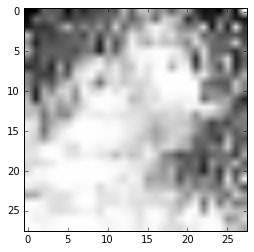

('Estimate:', array([[ 10.76106834]], dtype=float32))
('Iteration:', 75600, 'at', datetime.datetime(2017, 7, 7, 14, 54, 20, 1170))


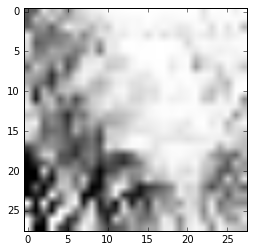

('Estimate:', array([[-0.74499929]], dtype=float32))
('Iteration:', 75700, 'at', datetime.datetime(2017, 7, 7, 14, 54, 26, 932364))


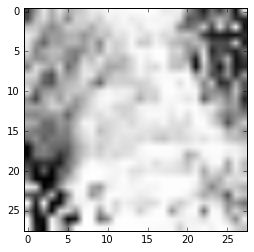

('Estimate:', array([[-2.46774387]], dtype=float32))
('Iteration:', 75800, 'at', datetime.datetime(2017, 7, 7, 14, 54, 33, 991169))


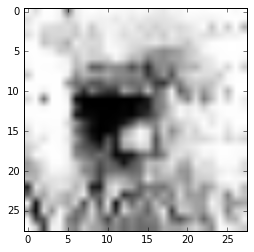

('Estimate:', array([[ 28.95658302]], dtype=float32))
('Iteration:', 75900, 'at', datetime.datetime(2017, 7, 7, 14, 54, 40, 976169))


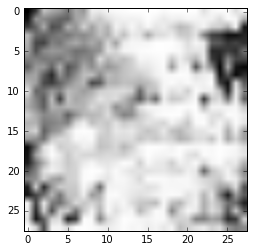

('Estimate:', array([[-6.62573624]], dtype=float32))
('Iteration:', 76000, 'at', datetime.datetime(2017, 7, 7, 14, 54, 49, 870064))


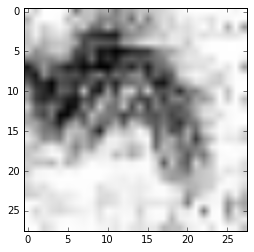

('Estimate:', array([[ 13.29993439]], dtype=float32))
('Iteration:', 76100, 'at', datetime.datetime(2017, 7, 7, 14, 54, 56, 685962))


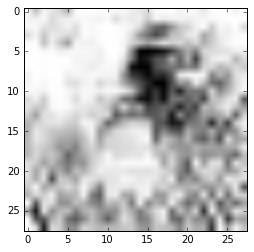

('Estimate:', array([[ 9.76245022]], dtype=float32))
('Iteration:', 76200, 'at', datetime.datetime(2017, 7, 7, 14, 55, 3, 840404))


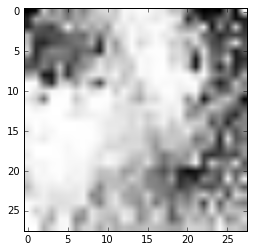

('Estimate:', array([[ 6.90286875]], dtype=float32))
('Iteration:', 76300, 'at', datetime.datetime(2017, 7, 7, 14, 55, 11, 313644))


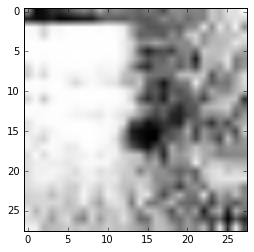

('Estimate:', array([[ 19.69879341]], dtype=float32))
('Iteration:', 76400, 'at', datetime.datetime(2017, 7, 7, 14, 55, 18, 537158))


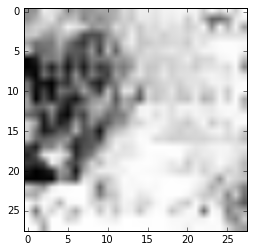

('Estimate:', array([[-2.92402387]], dtype=float32))
('Iteration:', 76500, 'at', datetime.datetime(2017, 7, 7, 14, 55, 25, 676469))


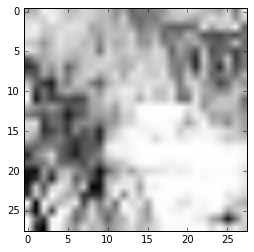

('Estimate:', array([[ 9.15559101]], dtype=float32))
('Iteration:', 76600, 'at', datetime.datetime(2017, 7, 7, 14, 55, 33, 44012))


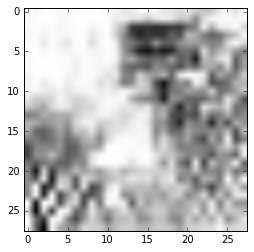

('Estimate:', array([[-0.47503173]], dtype=float32))
('Iteration:', 76700, 'at', datetime.datetime(2017, 7, 7, 14, 55, 40, 259606))


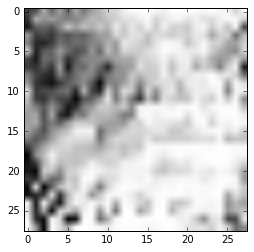

('Estimate:', array([[-15.03628063]], dtype=float32))
('Iteration:', 76800, 'at', datetime.datetime(2017, 7, 7, 14, 55, 47, 471103))


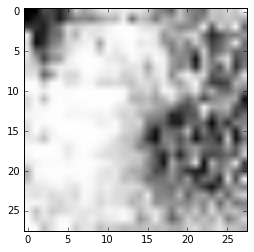

('Estimate:', array([[ 2.41788054]], dtype=float32))
('Iteration:', 76900, 'at', datetime.datetime(2017, 7, 7, 14, 55, 55, 919504))


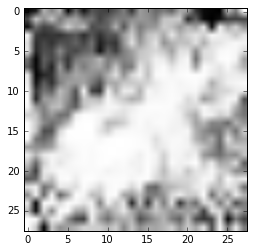

('Estimate:', array([[-0.50637639]], dtype=float32))
('Iteration:', 77000, 'at', datetime.datetime(2017, 7, 7, 14, 56, 2, 849398))


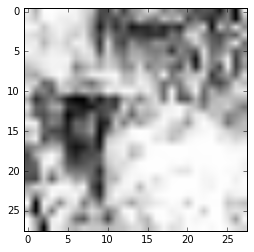

('Estimate:', array([[ 10.0017662]], dtype=float32))
('Iteration:', 77100, 'at', datetime.datetime(2017, 7, 7, 14, 56, 11, 63032))


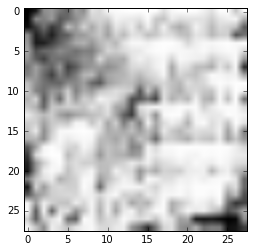

('Estimate:', array([[-35.90915298]], dtype=float32))
('Iteration:', 77200, 'at', datetime.datetime(2017, 7, 7, 14, 56, 18, 518324))


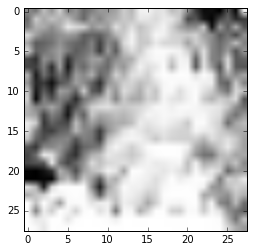

('Estimate:', array([[ 4.52660513]], dtype=float32))
('Iteration:', 77300, 'at', datetime.datetime(2017, 7, 7, 14, 56, 26, 236324))


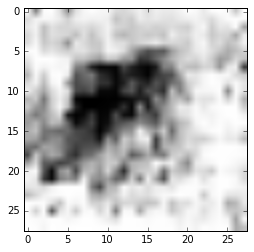

('Estimate:', array([[ 11.68928623]], dtype=float32))
('Iteration:', 77400, 'at', datetime.datetime(2017, 7, 7, 14, 56, 33, 688863))


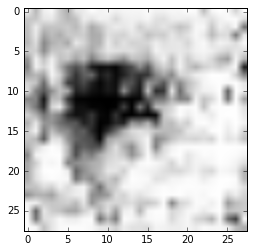

('Estimate:', array([[ 17.7691555]], dtype=float32))
('Iteration:', 77500, 'at', datetime.datetime(2017, 7, 7, 14, 56, 41, 436457))


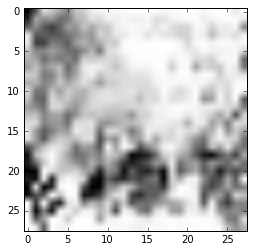

('Estimate:', array([[ 10.13493729]], dtype=float32))
('Iteration:', 77600, 'at', datetime.datetime(2017, 7, 7, 14, 56, 49, 241127))


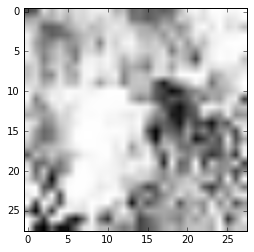

('Estimate:', array([[ 0.81915247]], dtype=float32))
('Iteration:', 77700, 'at', datetime.datetime(2017, 7, 7, 14, 56, 56, 799232))


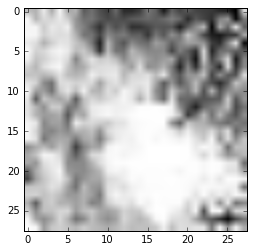

('Estimate:', array([[-7.90496206]], dtype=float32))
('Iteration:', 77800, 'at', datetime.datetime(2017, 7, 7, 14, 57, 4, 814826))


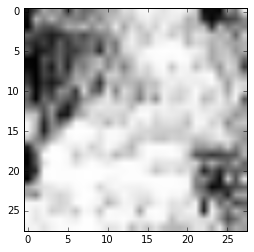

('Estimate:', array([[ 3.4974122]], dtype=float32))
('Iteration:', 77900, 'at', datetime.datetime(2017, 7, 7, 14, 57, 12, 186761))


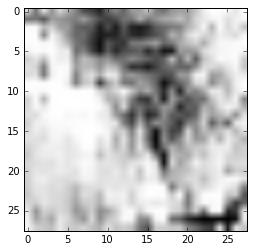

('Estimate:', array([[ 10.13420296]], dtype=float32))
('Iteration:', 78000, 'at', datetime.datetime(2017, 7, 7, 14, 57, 19, 305137))


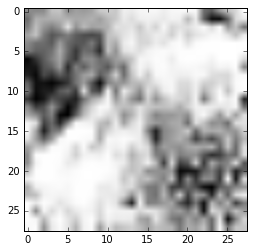

('Estimate:', array([[-8.42569828]], dtype=float32))
('Iteration:', 78100, 'at', datetime.datetime(2017, 7, 7, 14, 57, 26, 591635))


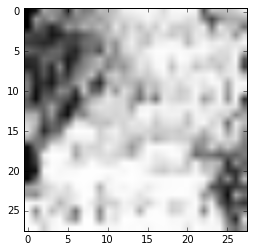

('Estimate:', array([[-0.50821161]], dtype=float32))
('Iteration:', 78200, 'at', datetime.datetime(2017, 7, 7, 14, 57, 33, 815397))


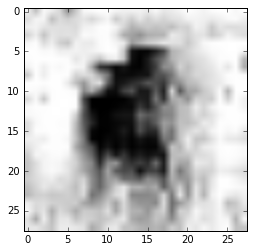

('Estimate:', array([[-2.37874031]], dtype=float32))
('Iteration:', 78300, 'at', datetime.datetime(2017, 7, 7, 14, 57, 41, 56963))


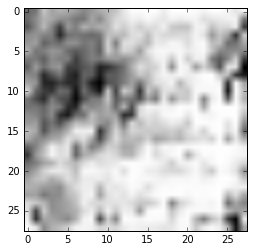

('Estimate:', array([[-7.90778351]], dtype=float32))
('Iteration:', 78400, 'at', datetime.datetime(2017, 7, 7, 14, 57, 48, 267685))


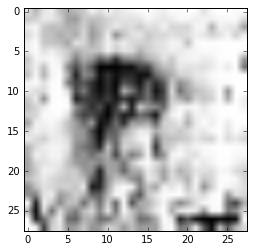

('Estimate:', array([[ 8.6777401]], dtype=float32))
('Iteration:', 78500, 'at', datetime.datetime(2017, 7, 7, 14, 57, 55, 339432))


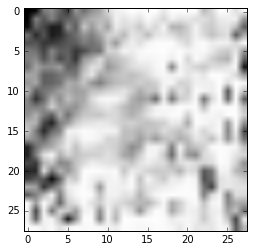

('Estimate:', array([[-18.70868301]], dtype=float32))
('Iteration:', 78600, 'at', datetime.datetime(2017, 7, 7, 14, 58, 2, 310086))


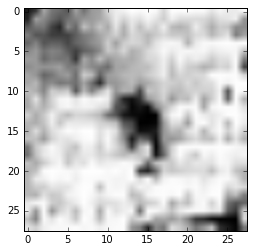

('Estimate:', array([[-45.20633698]], dtype=float32))
('Iteration:', 78700, 'at', datetime.datetime(2017, 7, 7, 14, 58, 11, 26750))


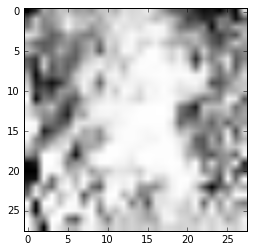

('Estimate:', array([[ 2.54602885]], dtype=float32))
('Iteration:', 78800, 'at', datetime.datetime(2017, 7, 7, 14, 58, 18, 128208))


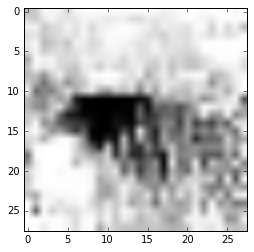

('Estimate:', array([[ 27.32015419]], dtype=float32))
('Iteration:', 78900, 'at', datetime.datetime(2017, 7, 7, 14, 58, 25, 106872))


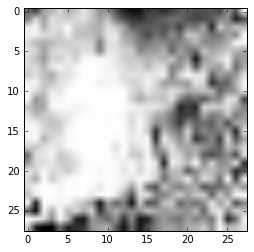

('Estimate:', array([[ 14.20448399]], dtype=float32))
('Iteration:', 79000, 'at', datetime.datetime(2017, 7, 7, 14, 58, 32, 699707))


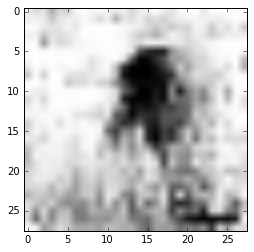

('Estimate:', array([[ 16.48998642]], dtype=float32))
('Iteration:', 79100, 'at', datetime.datetime(2017, 7, 7, 14, 58, 39, 756076))


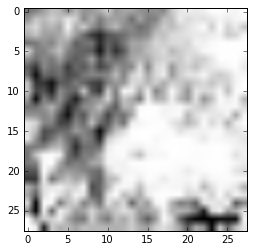

('Estimate:', array([[-0.76833427]], dtype=float32))
('Iteration:', 79200, 'at', datetime.datetime(2017, 7, 7, 14, 58, 47, 131080))


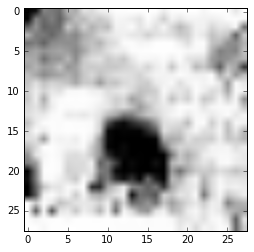

('Estimate:', array([[ 21.11616516]], dtype=float32))
('Iteration:', 79300, 'at', datetime.datetime(2017, 7, 7, 14, 58, 54, 238053))


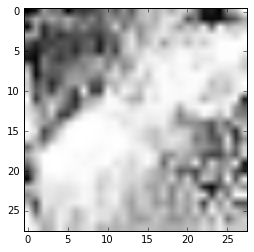

('Estimate:', array([[-6.6556983]], dtype=float32))
('Iteration:', 79400, 'at', datetime.datetime(2017, 7, 7, 14, 59, 1, 281383))


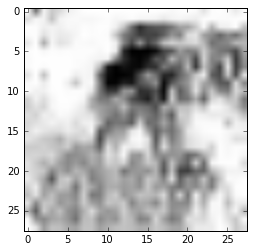

('Estimate:', array([[ 2.99118781]], dtype=float32))
('Iteration:', 79500, 'at', datetime.datetime(2017, 7, 7, 14, 59, 8, 607550))


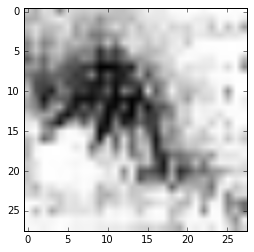

('Estimate:', array([[ 8.09933281]], dtype=float32))
('Iteration:', 79600, 'at', datetime.datetime(2017, 7, 7, 14, 59, 17, 64000))


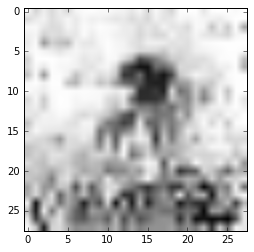

('Estimate:', array([[ 1.84332514]], dtype=float32))
('Iteration:', 79700, 'at', datetime.datetime(2017, 7, 7, 14, 59, 24, 258143))


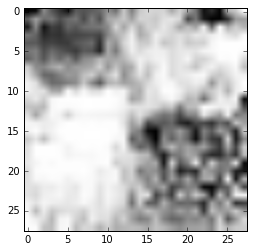

('Estimate:', array([[ 24.20214653]], dtype=float32))
('Iteration:', 79800, 'at', datetime.datetime(2017, 7, 7, 14, 59, 31, 650817))


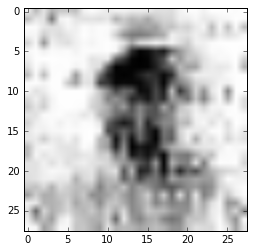

('Estimate:', array([[ 22.10682106]], dtype=float32))
('Iteration:', 79900, 'at', datetime.datetime(2017, 7, 7, 14, 59, 38, 827572))


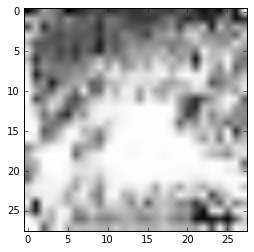

('Estimate:', array([[ 4.15669966]], dtype=float32))
('Iteration:', 80000, 'at', datetime.datetime(2017, 7, 7, 14, 59, 46, 150043))


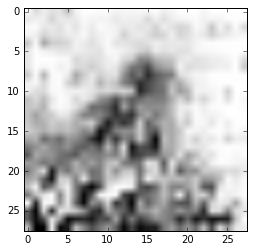

('Estimate:', array([[-9.39255428]], dtype=float32))
('Iteration:', 80100, 'at', datetime.datetime(2017, 7, 7, 14, 59, 53, 556221))


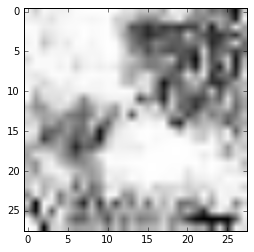

('Estimate:', array([[ 21.91601181]], dtype=float32))
('Iteration:', 80200, 'at', datetime.datetime(2017, 7, 7, 15, 0, 0, 875095))


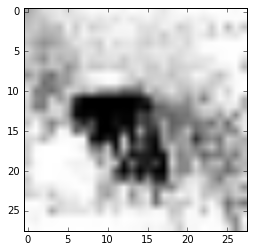

('Estimate:', array([[ 35.13763046]], dtype=float32))
('Iteration:', 80300, 'at', datetime.datetime(2017, 7, 7, 15, 0, 8, 473475))


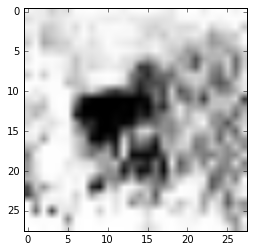

('Estimate:', array([[ 15.11060333]], dtype=float32))
('Iteration:', 80400, 'at', datetime.datetime(2017, 7, 7, 15, 0, 15, 727353))


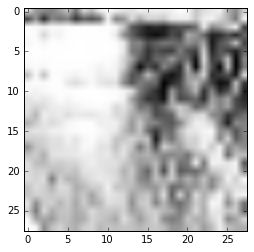

('Estimate:', array([[ 4.5783987]], dtype=float32))
('Iteration:', 80500, 'at', datetime.datetime(2017, 7, 7, 15, 0, 24, 63379))


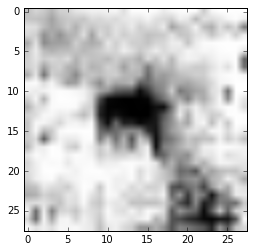

('Estimate:', array([[-21.10414505]], dtype=float32))
('Iteration:', 80600, 'at', datetime.datetime(2017, 7, 7, 15, 0, 31, 638356))


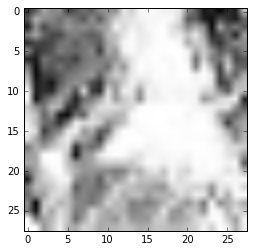

('Estimate:', array([[-1.77957594]], dtype=float32))
('Iteration:', 80700, 'at', datetime.datetime(2017, 7, 7, 15, 0, 38, 954289))


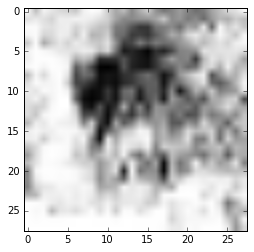

('Estimate:', array([[ 9.00916672]], dtype=float32))
('Iteration:', 80800, 'at', datetime.datetime(2017, 7, 7, 15, 0, 46, 242330))


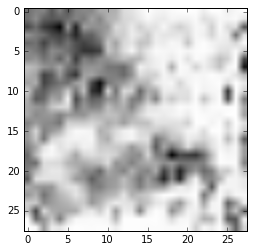

('Estimate:', array([[ 9.32538509]], dtype=float32))
('Iteration:', 80900, 'at', datetime.datetime(2017, 7, 7, 15, 0, 53, 449375))


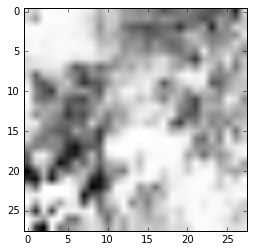

('Estimate:', array([[-20.5332756]], dtype=float32))
('Iteration:', 81000, 'at', datetime.datetime(2017, 7, 7, 15, 1, 0, 755809))


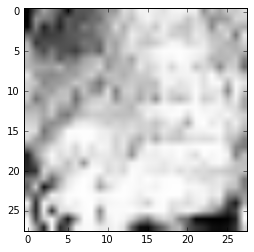

('Estimate:', array([[ 18.04714966]], dtype=float32))
('Iteration:', 81100, 'at', datetime.datetime(2017, 7, 7, 15, 1, 8, 48867))


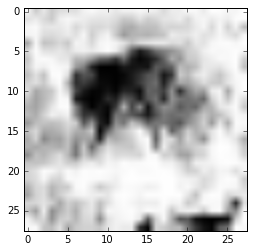

('Estimate:', array([[ 22.06953812]], dtype=float32))
('Iteration:', 81200, 'at', datetime.datetime(2017, 7, 7, 15, 1, 17, 531387))


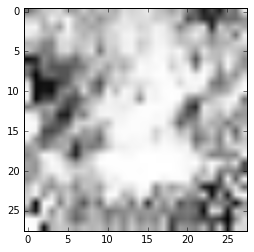

('Estimate:', array([[ 2.24452305]], dtype=float32))
('Iteration:', 81300, 'at', datetime.datetime(2017, 7, 7, 15, 1, 25, 329403))


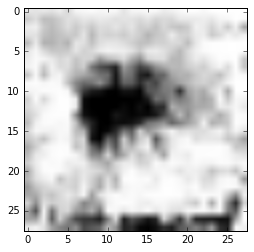

('Estimate:', array([[ 3.22112298]], dtype=float32))
('Iteration:', 81400, 'at', datetime.datetime(2017, 7, 7, 15, 1, 34, 411361))


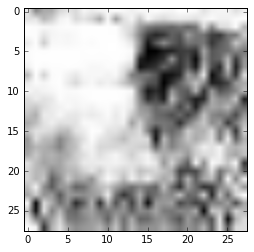

('Estimate:', array([[ 21.357481]], dtype=float32))
('Iteration:', 81500, 'at', datetime.datetime(2017, 7, 7, 15, 1, 41, 902416))


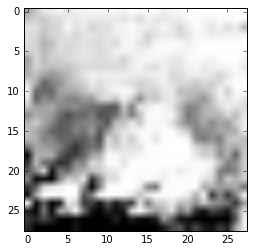

('Estimate:', array([[ 33.37627029]], dtype=float32))
('Iteration:', 81600, 'at', datetime.datetime(2017, 7, 7, 15, 1, 49, 468557))


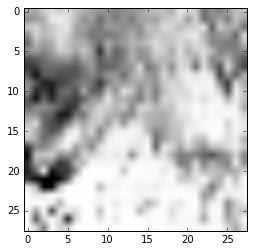

('Estimate:', array([[ 15.55678272]], dtype=float32))
('Iteration:', 81700, 'at', datetime.datetime(2017, 7, 7, 15, 1, 56, 751015))


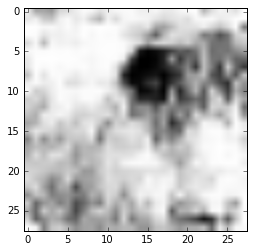

('Estimate:', array([[ 23.39948273]], dtype=float32))
('Iteration:', 81800, 'at', datetime.datetime(2017, 7, 7, 15, 2, 4, 401997))


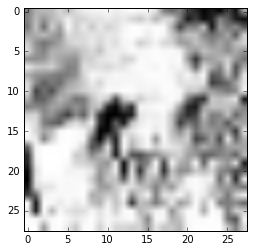

('Estimate:', array([[ 0.70733196]], dtype=float32))
('Iteration:', 81900, 'at', datetime.datetime(2017, 7, 7, 15, 2, 12, 141168))


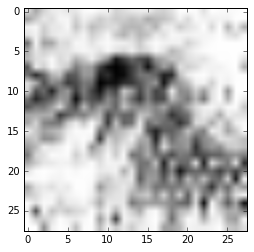

('Estimate:', array([[ 22.06097603]], dtype=float32))
('Iteration:', 82000, 'at', datetime.datetime(2017, 7, 7, 15, 2, 19, 973301))


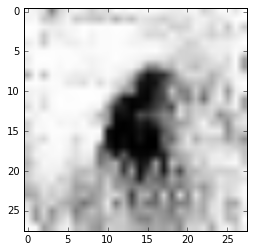

('Estimate:', array([[ 6.10694456]], dtype=float32))
('Iteration:', 82100, 'at', datetime.datetime(2017, 7, 7, 15, 2, 27, 734949))


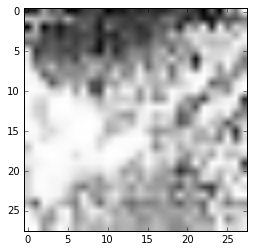

('Estimate:', array([[-14.08559227]], dtype=float32))
('Iteration:', 82200, 'at', datetime.datetime(2017, 7, 7, 15, 2, 35, 483105))


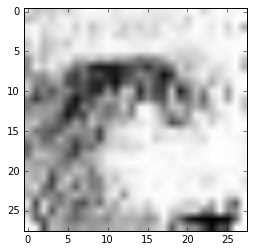

('Estimate:', array([[ 17.75169945]], dtype=float32))
('Iteration:', 82300, 'at', datetime.datetime(2017, 7, 7, 15, 2, 44, 17301))


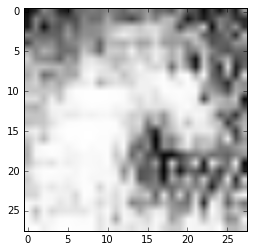

('Estimate:', array([[ 10.76436329]], dtype=float32))
('Iteration:', 82400, 'at', datetime.datetime(2017, 7, 7, 15, 2, 51, 725624))


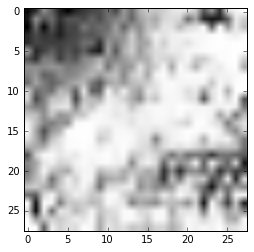

('Estimate:', array([[ 37.0165329]], dtype=float32))
('Iteration:', 82500, 'at', datetime.datetime(2017, 7, 7, 15, 2, 58, 982148))


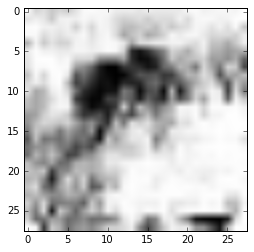

('Estimate:', array([[ 12.57798672]], dtype=float32))
('Iteration:', 82600, 'at', datetime.datetime(2017, 7, 7, 15, 3, 6, 679768))


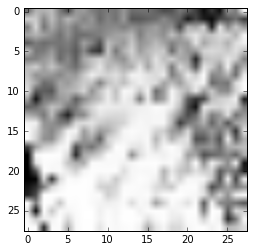

('Estimate:', array([[ 10.91645527]], dtype=float32))
('Iteration:', 82700, 'at', datetime.datetime(2017, 7, 7, 15, 3, 14, 256427))


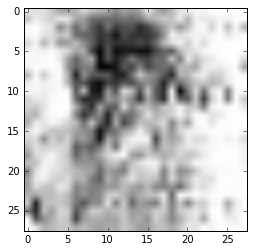

('Estimate:', array([[ 24.97386742]], dtype=float32))
('Iteration:', 82800, 'at', datetime.datetime(2017, 7, 7, 15, 3, 21, 846871))


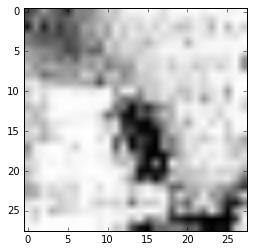

('Estimate:', array([[ 15.69046116]], dtype=float32))
('Iteration:', 82900, 'at', datetime.datetime(2017, 7, 7, 15, 3, 29, 329566))


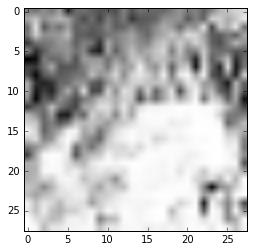

('Estimate:', array([[-5.19179535]], dtype=float32))
('Iteration:', 83000, 'at', datetime.datetime(2017, 7, 7, 15, 3, 37, 8787))


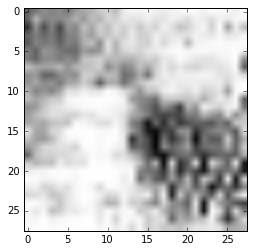

('Estimate:', array([[ 13.48338509]], dtype=float32))
('Iteration:', 83100, 'at', datetime.datetime(2017, 7, 7, 15, 3, 44, 601179))


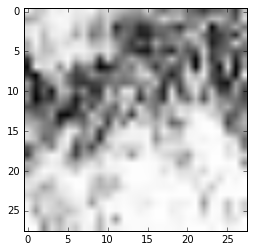

('Estimate:', array([[-3.66108751]], dtype=float32))
('Iteration:', 83200, 'at', datetime.datetime(2017, 7, 7, 15, 3, 53, 381638))


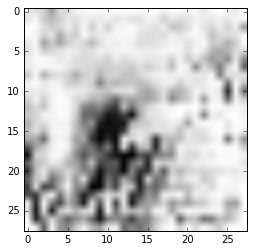

('Estimate:', array([[-4.74080992]], dtype=float32))
('Iteration:', 83300, 'at', datetime.datetime(2017, 7, 7, 15, 4, 0, 690886))


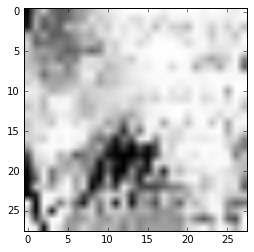

('Estimate:', array([[-11.01918602]], dtype=float32))
('Iteration:', 83400, 'at', datetime.datetime(2017, 7, 7, 15, 4, 8, 461683))


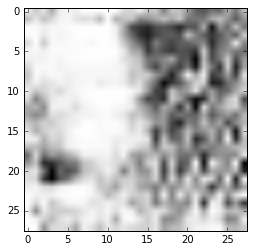

('Estimate:', array([[ 15.35461617]], dtype=float32))
('Iteration:', 83500, 'at', datetime.datetime(2017, 7, 7, 15, 4, 15, 988112))


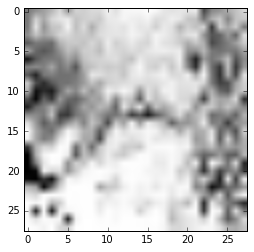

('Estimate:', array([[-2.97381639]], dtype=float32))
('Iteration:', 83600, 'at', datetime.datetime(2017, 7, 7, 15, 4, 23, 356149))


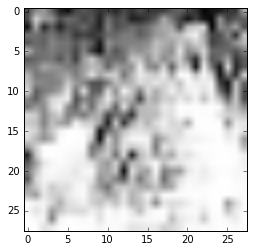

('Estimate:', array([[ 30.91043472]], dtype=float32))
('Iteration:', 83700, 'at', datetime.datetime(2017, 7, 7, 15, 4, 31, 194874))


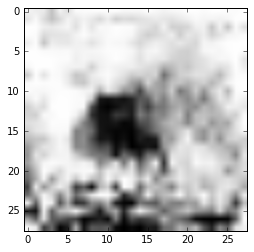

('Estimate:', array([[ 21.12808037]], dtype=float32))
('Iteration:', 83800, 'at', datetime.datetime(2017, 7, 7, 15, 4, 38, 786270))


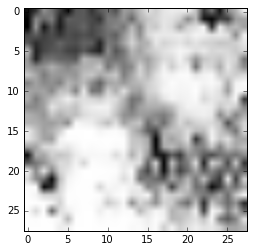

('Estimate:', array([[ 17.02638817]], dtype=float32))
('Iteration:', 83900, 'at', datetime.datetime(2017, 7, 7, 15, 4, 47, 174958))


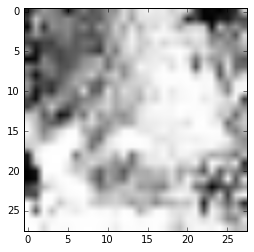

('Estimate:', array([[ 21.67201233]], dtype=float32))
('Iteration:', 84000, 'at', datetime.datetime(2017, 7, 7, 15, 4, 54, 589174))


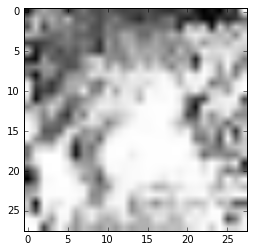

('Estimate:', array([[-9.66425133]], dtype=float32))
('Iteration:', 84100, 'at', datetime.datetime(2017, 7, 7, 15, 5, 3, 375770))


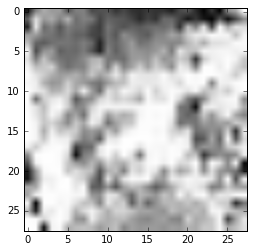

('Estimate:', array([[ 5.8325758]], dtype=float32))
('Iteration:', 84200, 'at', datetime.datetime(2017, 7, 7, 15, 5, 11, 314792))


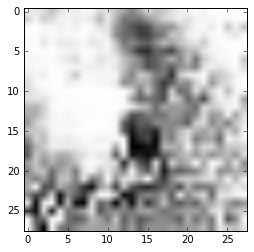

('Estimate:', array([[ 2.97861099]], dtype=float32))
('Iteration:', 84300, 'at', datetime.datetime(2017, 7, 7, 15, 5, 19, 10119))


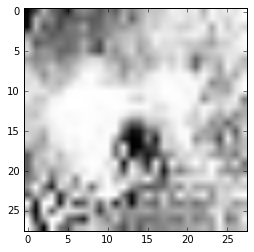

('Estimate:', array([[ 28.34849548]], dtype=float32))
('Iteration:', 84400, 'at', datetime.datetime(2017, 7, 7, 15, 5, 27, 333481))


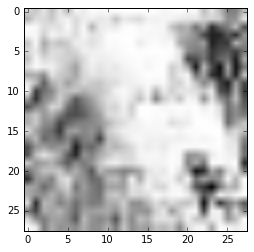

('Estimate:', array([[ 15.54355145]], dtype=float32))
('Iteration:', 84500, 'at', datetime.datetime(2017, 7, 7, 15, 5, 35, 161086))


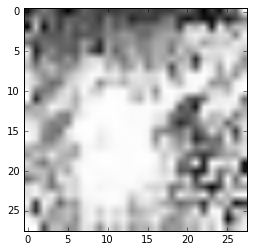

('Estimate:', array([[ 10.90372086]], dtype=float32))
('Iteration:', 84600, 'at', datetime.datetime(2017, 7, 7, 15, 5, 42, 632411))


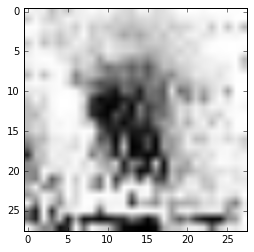

('Estimate:', array([[-5.62461329]], dtype=float32))
('Iteration:', 84700, 'at', datetime.datetime(2017, 7, 7, 15, 5, 50, 763153))


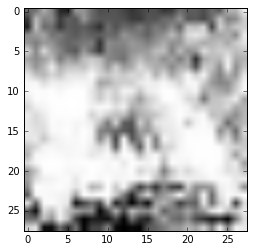

('Estimate:', array([[ 23.90626717]], dtype=float32))
('Iteration:', 84800, 'at', datetime.datetime(2017, 7, 7, 15, 5, 57, 996512))


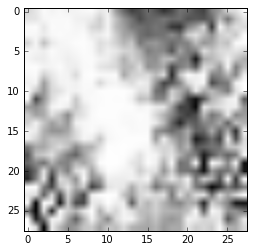

('Estimate:', array([[-17.06501579]], dtype=float32))
('Iteration:', 84900, 'at', datetime.datetime(2017, 7, 7, 15, 6, 5, 912359))


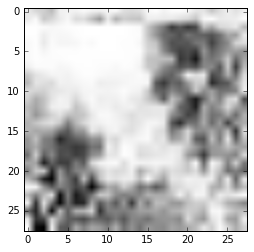

('Estimate:', array([[ 13.47698021]], dtype=float32))
('Iteration:', 85000, 'at', datetime.datetime(2017, 7, 7, 15, 6, 15, 20432))


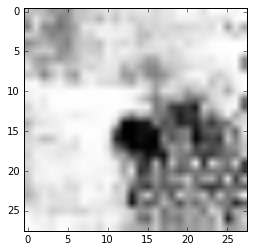

('Estimate:', array([[ 16.06406021]], dtype=float32))
('Iteration:', 85100, 'at', datetime.datetime(2017, 7, 7, 15, 6, 22, 632766))


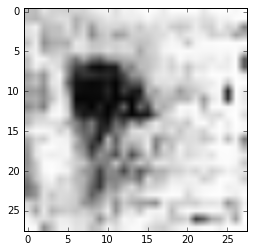

('Estimate:', array([[-16.66741753]], dtype=float32))
('Iteration:', 85200, 'at', datetime.datetime(2017, 7, 7, 15, 6, 30, 759098))


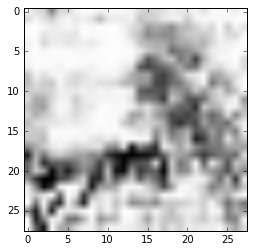

('Estimate:', array([[ 5.25024319]], dtype=float32))
('Iteration:', 85300, 'at', datetime.datetime(2017, 7, 7, 15, 6, 38, 362712))


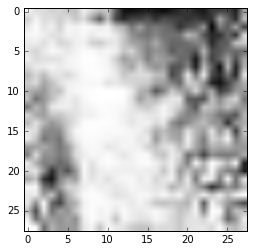

('Estimate:', array([[ 10.76578522]], dtype=float32))
('Iteration:', 85400, 'at', datetime.datetime(2017, 7, 7, 15, 6, 46, 108446))


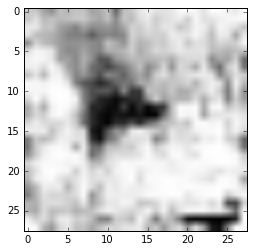

('Estimate:', array([[-12.20138836]], dtype=float32))
('Iteration:', 85500, 'at', datetime.datetime(2017, 7, 7, 15, 6, 53, 883334))


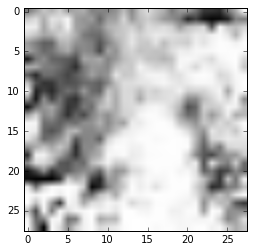

('Estimate:', array([[ 14.77434921]], dtype=float32))
('Iteration:', 85600, 'at', datetime.datetime(2017, 7, 7, 15, 7, 1, 407499))


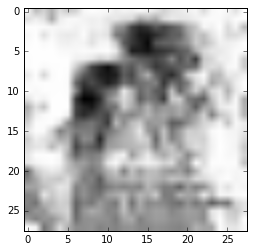

('Estimate:', array([[ 10.59614658]], dtype=float32))
('Iteration:', 85700, 'at', datetime.datetime(2017, 7, 7, 15, 7, 8, 914023))


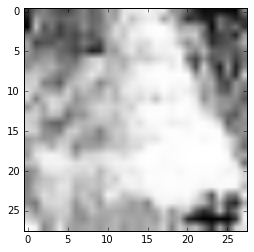

('Estimate:', array([[ 6.62281036]], dtype=float32))
('Iteration:', 85800, 'at', datetime.datetime(2017, 7, 7, 15, 7, 16, 515106))


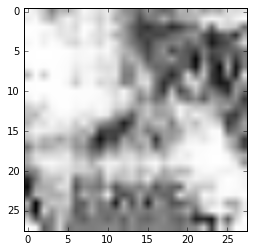

('Estimate:', array([[-7.69396925]], dtype=float32))
('Iteration:', 85900, 'at', datetime.datetime(2017, 7, 7, 15, 7, 25, 100229))


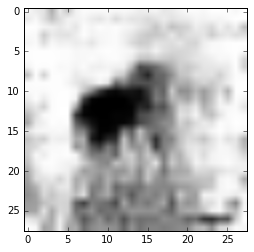

('Estimate:', array([[ 34.3669281]], dtype=float32))
('Iteration:', 86000, 'at', datetime.datetime(2017, 7, 7, 15, 7, 33, 179008))


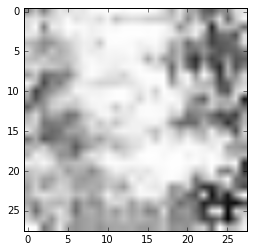

('Estimate:', array([[ 0.38471931]], dtype=float32))
('Iteration:', 86100, 'at', datetime.datetime(2017, 7, 7, 15, 7, 41, 225258))


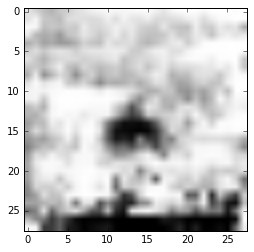

('Estimate:', array([[ 4.31842661]], dtype=float32))
('Iteration:', 86200, 'at', datetime.datetime(2017, 7, 7, 15, 7, 50, 461407))


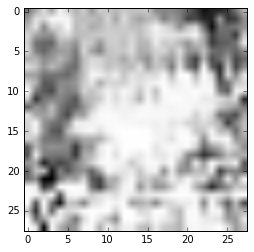

('Estimate:', array([[-26.44497681]], dtype=float32))
('Iteration:', 86300, 'at', datetime.datetime(2017, 7, 7, 15, 7, 58, 197987))


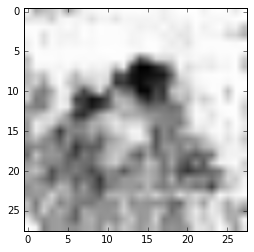

('Estimate:', array([[ 26.50704193]], dtype=float32))
('Iteration:', 86400, 'at', datetime.datetime(2017, 7, 7, 15, 8, 5, 538620))


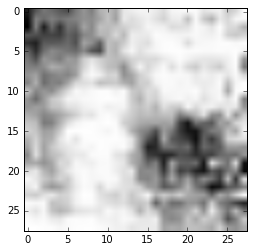

('Estimate:', array([[-0.80976582]], dtype=float32))
('Iteration:', 86500, 'at', datetime.datetime(2017, 7, 7, 15, 8, 13, 761247))


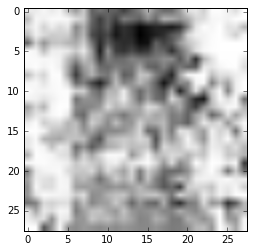

('Estimate:', array([[-16.74312973]], dtype=float32))
('Iteration:', 86600, 'at', datetime.datetime(2017, 7, 7, 15, 8, 21, 286006))


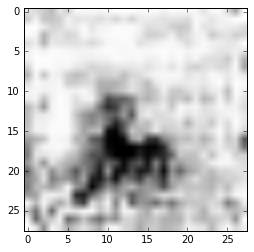

('Estimate:', array([[-22.80812073]], dtype=float32))
('Iteration:', 86700, 'at', datetime.datetime(2017, 7, 7, 15, 8, 29, 143562))


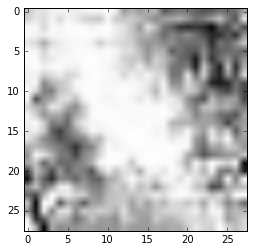

('Estimate:', array([[-30.12947845]], dtype=float32))
('Iteration:', 86800, 'at', datetime.datetime(2017, 7, 7, 15, 8, 37, 708867))


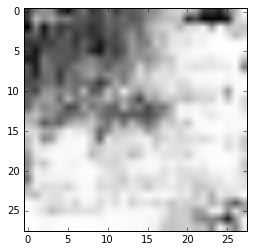

('Estimate:', array([[ 22.86745644]], dtype=float32))
('Iteration:', 86900, 'at', datetime.datetime(2017, 7, 7, 15, 8, 45, 103216))


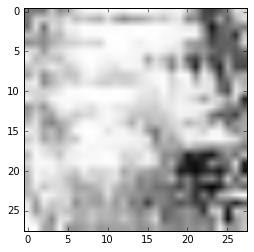

('Estimate:', array([[-11.93301487]], dtype=float32))
('Iteration:', 87000, 'at', datetime.datetime(2017, 7, 7, 15, 8, 52, 901050))


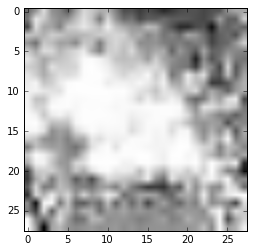

('Estimate:', array([[ 12.62482166]], dtype=float32))
('Iteration:', 87100, 'at', datetime.datetime(2017, 7, 7, 15, 9, 0, 790827))


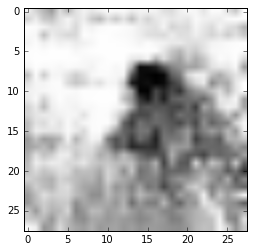

('Estimate:', array([[ 24.06295013]], dtype=float32))
('Iteration:', 87200, 'at', datetime.datetime(2017, 7, 7, 15, 9, 8, 722636))


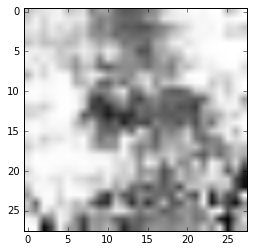

('Estimate:', array([[-0.31940281]], dtype=float32))
('Iteration:', 87300, 'at', datetime.datetime(2017, 7, 7, 15, 9, 17, 598333))


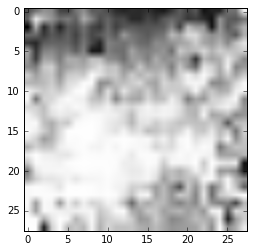

('Estimate:', array([[ 14.14265347]], dtype=float32))
('Iteration:', 87400, 'at', datetime.datetime(2017, 7, 7, 15, 9, 25, 402764))


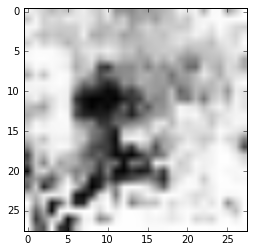

('Estimate:', array([[ 13.46608734]], dtype=float32))
('Iteration:', 87500, 'at', datetime.datetime(2017, 7, 7, 15, 9, 34, 177901))


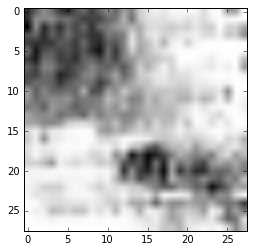

('Estimate:', array([[ 26.17423058]], dtype=float32))
('Iteration:', 87600, 'at', datetime.datetime(2017, 7, 7, 15, 9, 42, 158152))


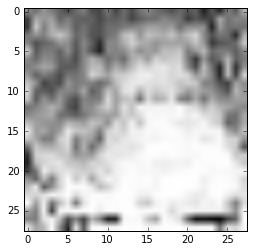

('Estimate:', array([[ 35.63629913]], dtype=float32))
('Iteration:', 87700, 'at', datetime.datetime(2017, 7, 7, 15, 9, 52, 11169))


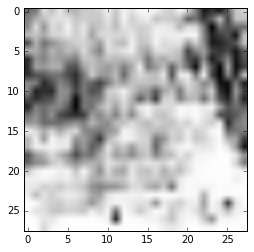

('Estimate:', array([[ 31.51360512]], dtype=float32))
('Iteration:', 87800, 'at', datetime.datetime(2017, 7, 7, 15, 9, 59, 713445))


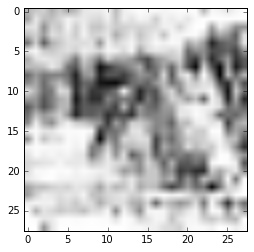

('Estimate:', array([[ 17.5913887]], dtype=float32))
('Iteration:', 87900, 'at', datetime.datetime(2017, 7, 7, 15, 10, 7, 754799))


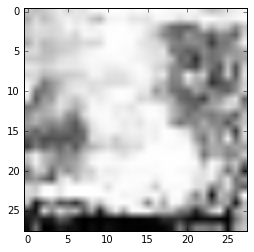

('Estimate:', array([[ 45.0213356]], dtype=float32))
('Iteration:', 88000, 'at', datetime.datetime(2017, 7, 7, 15, 10, 15, 70158))


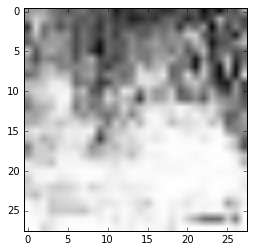

('Estimate:', array([[ 27.47374535]], dtype=float32))
('Iteration:', 88100, 'at', datetime.datetime(2017, 7, 7, 15, 10, 22, 899195))


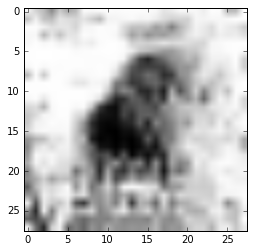

('Estimate:', array([[ 22.90152168]], dtype=float32))
('Iteration:', 88200, 'at', datetime.datetime(2017, 7, 7, 15, 10, 30, 803316))


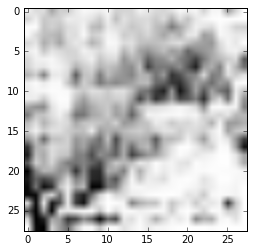

('Estimate:', array([[-4.49181509]], dtype=float32))
('Iteration:', 88300, 'at', datetime.datetime(2017, 7, 7, 15, 10, 38, 575223))


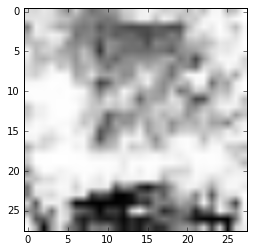

('Estimate:', array([[ 7.83321238]], dtype=float32))
('Iteration:', 88400, 'at', datetime.datetime(2017, 7, 7, 15, 10, 46, 467690))


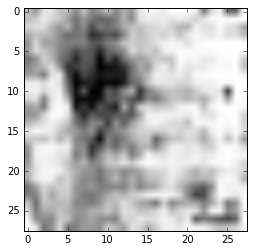

('Estimate:', array([[-8.59286022]], dtype=float32))
('Iteration:', 88500, 'at', datetime.datetime(2017, 7, 7, 15, 10, 54, 341529))


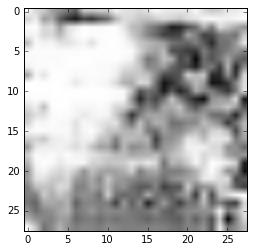

('Estimate:', array([[ 21.60746193]], dtype=float32))
('Iteration:', 88600, 'at', datetime.datetime(2017, 7, 7, 15, 11, 3, 214651))


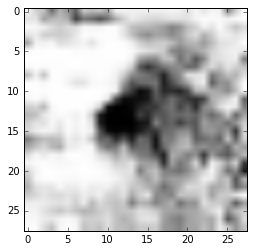

('Estimate:', array([[ 18.93959045]], dtype=float32))
('Iteration:', 88700, 'at', datetime.datetime(2017, 7, 7, 15, 11, 11, 66925))


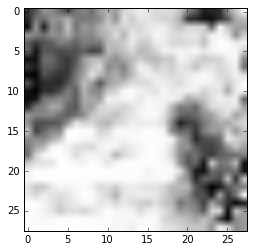

('Estimate:', array([[ 11.47573757]], dtype=float32))
('Iteration:', 88800, 'at', datetime.datetime(2017, 7, 7, 15, 11, 18, 748427))


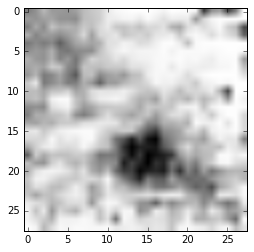

('Estimate:', array([[ 11.53291512]], dtype=float32))
('Iteration:', 88900, 'at', datetime.datetime(2017, 7, 7, 15, 11, 26, 542586))


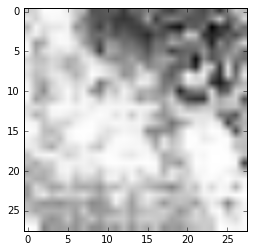

('Estimate:', array([[ 6.60989618]], dtype=float32))
('Iteration:', 89000, 'at', datetime.datetime(2017, 7, 7, 15, 11, 34, 511944))


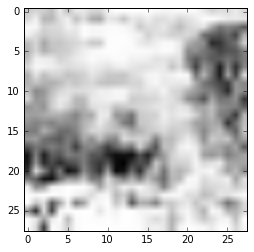

('Estimate:', array([[ 16.4008503]], dtype=float32))
('Iteration:', 89100, 'at', datetime.datetime(2017, 7, 7, 15, 11, 42, 158792))


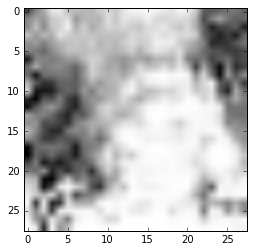

('Estimate:', array([[ 19.3076725]], dtype=float32))
('Iteration:', 89200, 'at', datetime.datetime(2017, 7, 7, 15, 11, 50, 57517))


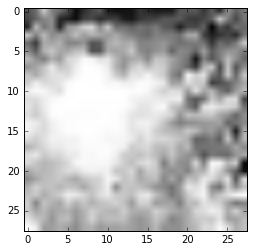

('Estimate:', array([[ 6.0111084]], dtype=float32))
('Iteration:', 89300, 'at', datetime.datetime(2017, 7, 7, 15, 11, 58, 589058))


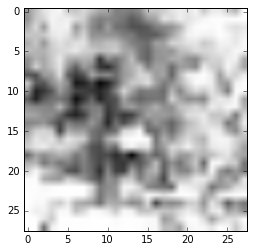

('Estimate:', array([[ 0.5314154]], dtype=float32))
('Iteration:', 89400, 'at', datetime.datetime(2017, 7, 7, 15, 12, 7, 79127))


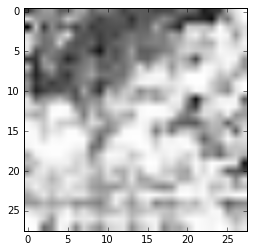

('Estimate:', array([[-20.4708004]], dtype=float32))
('Iteration:', 89500, 'at', datetime.datetime(2017, 7, 7, 15, 12, 15, 888853))


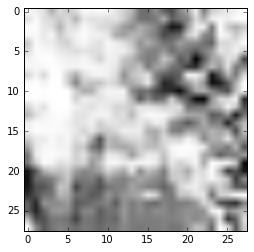

('Estimate:', array([[-8.54957867]], dtype=float32))
('Iteration:', 89600, 'at', datetime.datetime(2017, 7, 7, 15, 12, 23, 468907))


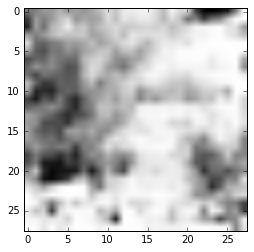

('Estimate:', array([[ 8.50342464]], dtype=float32))
('Iteration:', 89700, 'at', datetime.datetime(2017, 7, 7, 15, 12, 31, 892123))


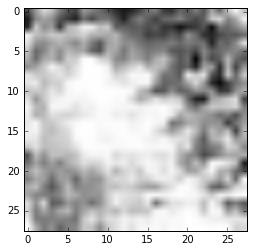

('Estimate:', array([[ 4.71382523]], dtype=float32))
('Iteration:', 89800, 'at', datetime.datetime(2017, 7, 7, 15, 12, 39, 167804))


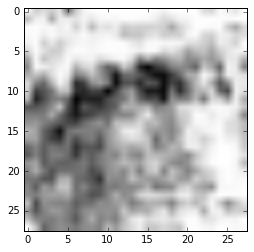

('Estimate:', array([[-1.71577203]], dtype=float32))
('Iteration:', 89900, 'at', datetime.datetime(2017, 7, 7, 15, 12, 48, 293990))


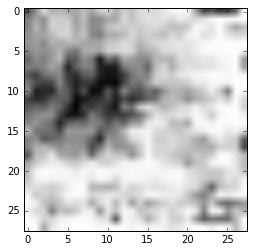

('Estimate:', array([[-16.02561569]], dtype=float32))
('Iteration:', 90000, 'at', datetime.datetime(2017, 7, 7, 15, 12, 56, 768543))


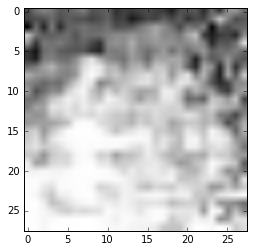

('Estimate:', array([[ 6.64981556]], dtype=float32))
('Iteration:', 90100, 'at', datetime.datetime(2017, 7, 7, 15, 13, 5, 328503))


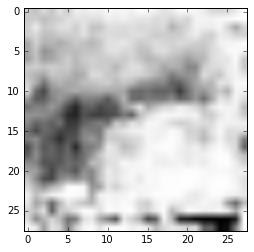

('Estimate:', array([[-34.94268036]], dtype=float32))
('Iteration:', 90200, 'at', datetime.datetime(2017, 7, 7, 15, 13, 14, 38013))


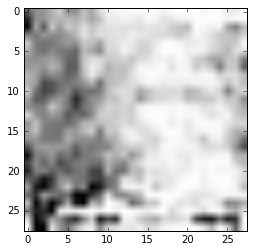

('Estimate:', array([[ 4.44621706]], dtype=float32))
('Iteration:', 90300, 'at', datetime.datetime(2017, 7, 7, 15, 13, 22, 720694))


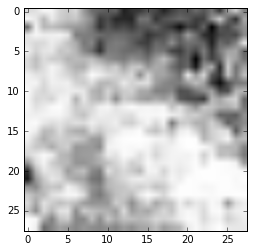

('Estimate:', array([[ 1.29833817]], dtype=float32))
('Iteration:', 90400, 'at', datetime.datetime(2017, 7, 7, 15, 13, 32, 392906))


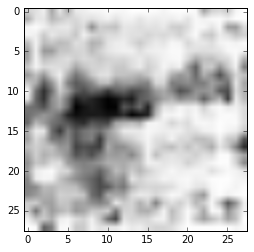

('Estimate:', array([[ 10.13473225]], dtype=float32))
('Iteration:', 90500, 'at', datetime.datetime(2017, 7, 7, 15, 13, 40, 441391))


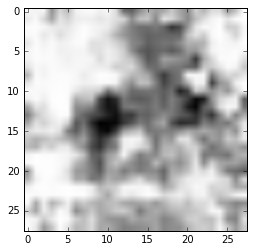

('Estimate:', array([[-7.88619041]], dtype=float32))
('Iteration:', 90600, 'at', datetime.datetime(2017, 7, 7, 15, 13, 48, 499880))


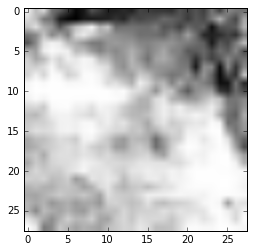

('Estimate:', array([[ 13.65829182]], dtype=float32))
('Iteration:', 90700, 'at', datetime.datetime(2017, 7, 7, 15, 13, 56, 301837))


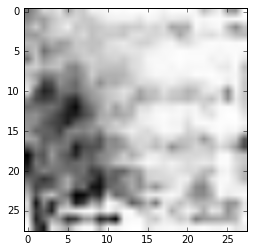

('Estimate:', array([[ 15.70615673]], dtype=float32))
('Iteration:', 90800, 'at', datetime.datetime(2017, 7, 7, 15, 14, 4, 334960))


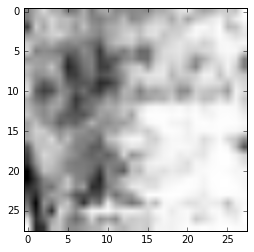

('Estimate:', array([[-3.72433972]], dtype=float32))
('Iteration:', 90900, 'at', datetime.datetime(2017, 7, 7, 15, 14, 12, 809406))


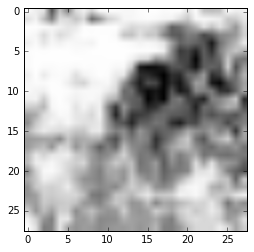

('Estimate:', array([[ 10.72632694]], dtype=float32))
('Iteration:', 91000, 'at', datetime.datetime(2017, 7, 7, 15, 14, 20, 816535))


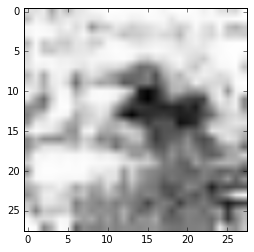

('Estimate:', array([[-14.47615528]], dtype=float32))
('Iteration:', 91100, 'at', datetime.datetime(2017, 7, 7, 15, 14, 29, 317460))


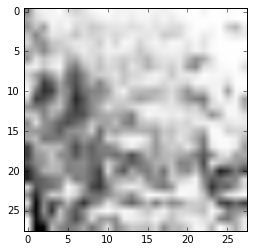

('Estimate:', array([[-20.15156364]], dtype=float32))
('Iteration:', 91200, 'at', datetime.datetime(2017, 7, 7, 15, 14, 37, 362302))


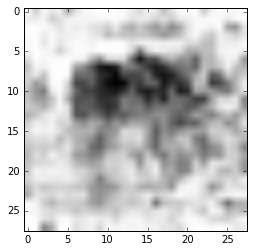

('Estimate:', array([[-6.00292826]], dtype=float32))
('Iteration:', 91300, 'at', datetime.datetime(2017, 7, 7, 15, 14, 46, 416706))


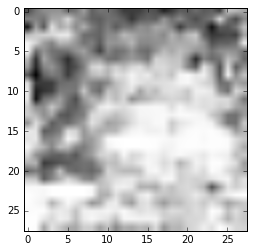

('Estimate:', array([[-8.42071629]], dtype=float32))
('Iteration:', 91400, 'at', datetime.datetime(2017, 7, 7, 15, 14, 54, 486041))


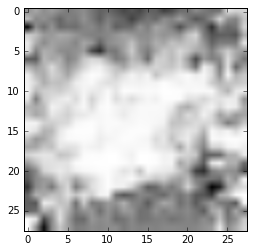

('Estimate:', array([[-2.57462406]], dtype=float32))
('Iteration:', 91500, 'at', datetime.datetime(2017, 7, 7, 15, 15, 2, 167208))


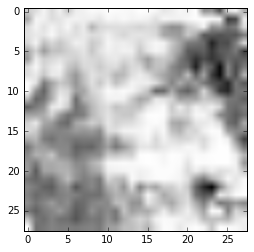

('Estimate:', array([[-2.01937652]], dtype=float32))
('Iteration:', 91600, 'at', datetime.datetime(2017, 7, 7, 15, 15, 10, 241978))


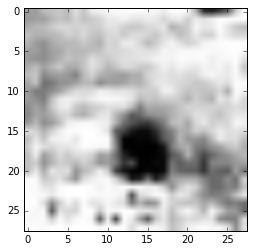

('Estimate:', array([[ 7.316679]], dtype=float32))
('Iteration:', 91700, 'at', datetime.datetime(2017, 7, 7, 15, 15, 18, 123913))


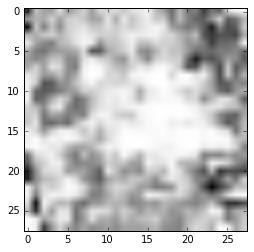

('Estimate:', array([[-6.54443836]], dtype=float32))
('Iteration:', 91800, 'at', datetime.datetime(2017, 7, 7, 15, 15, 26, 120731))


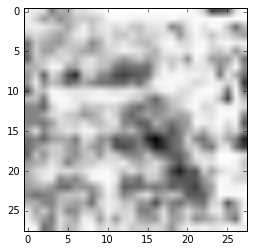

('Estimate:', array([[-43.66333771]], dtype=float32))
('Iteration:', 91900, 'at', datetime.datetime(2017, 7, 7, 15, 15, 34, 7687))


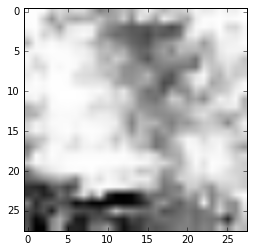

('Estimate:', array([[-13.07834053]], dtype=float32))
('Iteration:', 92000, 'at', datetime.datetime(2017, 7, 7, 15, 15, 41, 922965))


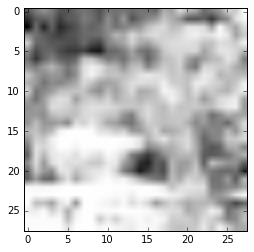

('Estimate:', array([[-13.57248116]], dtype=float32))
('Iteration:', 92100, 'at', datetime.datetime(2017, 7, 7, 15, 15, 50, 813423))


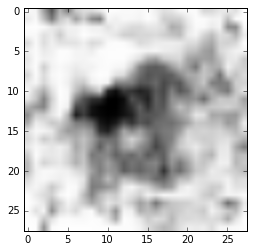

('Estimate:', array([[ 9.63083458]], dtype=float32))
('Iteration:', 92200, 'at', datetime.datetime(2017, 7, 7, 15, 15, 59, 976159))


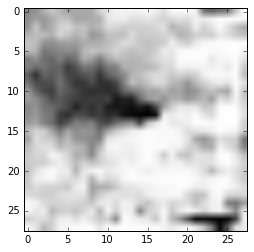

('Estimate:', array([[ 20.01555443]], dtype=float32))
('Iteration:', 92300, 'at', datetime.datetime(2017, 7, 7, 15, 16, 8, 365563))


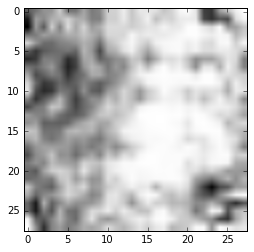

('Estimate:', array([[-15.74658585]], dtype=float32))
('Iteration:', 92400, 'at', datetime.datetime(2017, 7, 7, 15, 16, 16, 462484))


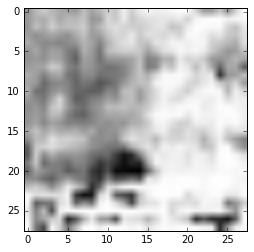

('Estimate:', array([[ 16.76977921]], dtype=float32))
('Iteration:', 92500, 'at', datetime.datetime(2017, 7, 7, 15, 16, 24, 576640))


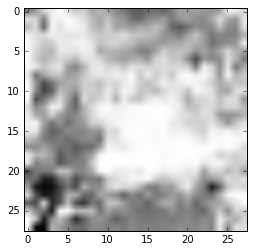

('Estimate:', array([[ 7.18793106]], dtype=float32))
('Iteration:', 92600, 'at', datetime.datetime(2017, 7, 7, 15, 16, 33, 359678))


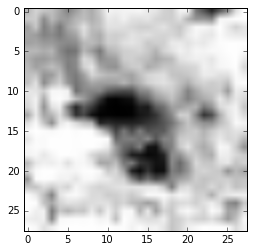

('Estimate:', array([[ 7.90466738]], dtype=float32))
('Iteration:', 92700, 'at', datetime.datetime(2017, 7, 7, 15, 16, 42, 587043))


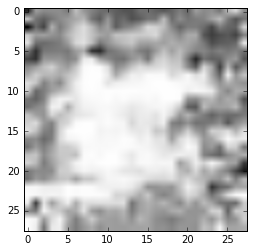

('Estimate:', array([[ 30.97445679]], dtype=float32))
('Iteration:', 92800, 'at', datetime.datetime(2017, 7, 7, 15, 16, 50, 979099))


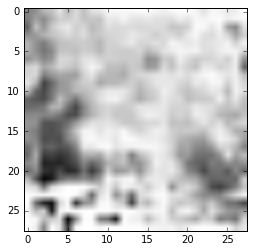

('Estimate:', array([[-6.36774921]], dtype=float32))
('Iteration:', 92900, 'at', datetime.datetime(2017, 7, 7, 15, 17, 1, 873810))


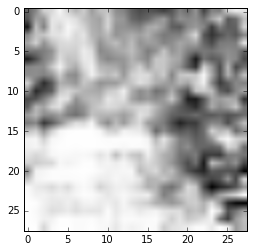

('Estimate:', array([[ 12.72532368]], dtype=float32))
('Iteration:', 93000, 'at', datetime.datetime(2017, 7, 7, 15, 17, 10, 998489))


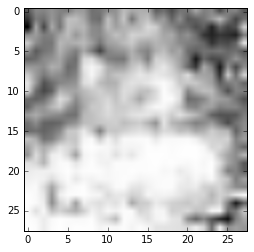

('Estimate:', array([[-5.92099905]], dtype=float32))
('Iteration:', 93100, 'at', datetime.datetime(2017, 7, 7, 15, 17, 21, 205172))


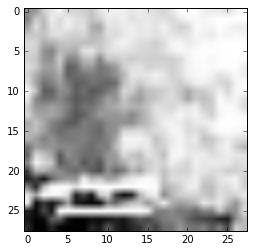

('Estimate:', array([[ 23.43469048]], dtype=float32))
('Iteration:', 93200, 'at', datetime.datetime(2017, 7, 7, 15, 17, 29, 623652))


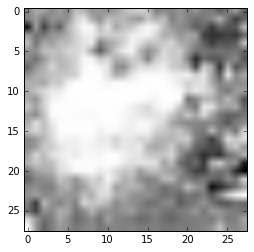

('Estimate:', array([[-8.1138382]], dtype=float32))
('Iteration:', 93300, 'at', datetime.datetime(2017, 7, 7, 15, 17, 37, 714976))


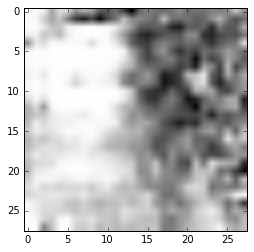

('Estimate:', array([[ 38.28022766]], dtype=float32))
('Iteration:', 93400, 'at', datetime.datetime(2017, 7, 7, 15, 17, 45, 787986))


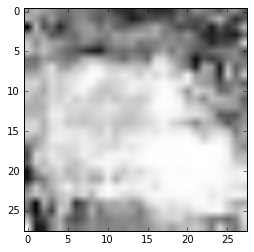

('Estimate:', array([[ 2.84031844]], dtype=float32))
('Iteration:', 93500, 'at', datetime.datetime(2017, 7, 7, 15, 17, 54, 538367))


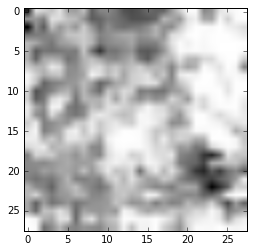

('Estimate:', array([[ 5.29872942]], dtype=float32))
('Iteration:', 93600, 'at', datetime.datetime(2017, 7, 7, 15, 18, 2, 545790))


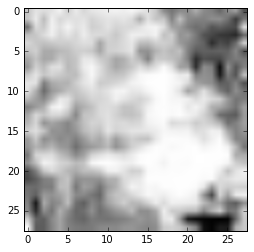

('Estimate:', array([[ 21.17307091]], dtype=float32))
('Iteration:', 93700, 'at', datetime.datetime(2017, 7, 7, 15, 18, 10, 819707))


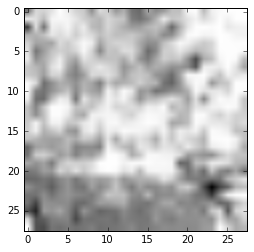

('Estimate:', array([[-24.1115284]], dtype=float32))
('Iteration:', 93800, 'at', datetime.datetime(2017, 7, 7, 15, 18, 19, 686338))


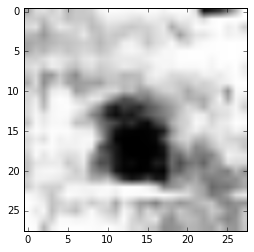

('Estimate:', array([[-22.0322113]], dtype=float32))
('Iteration:', 93900, 'at', datetime.datetime(2017, 7, 7, 15, 18, 28, 677600))


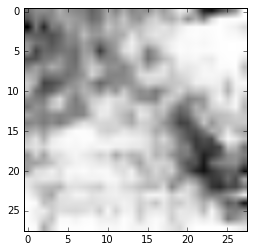

('Estimate:', array([[-2.2416265]], dtype=float32))
('Iteration:', 94000, 'at', datetime.datetime(2017, 7, 7, 15, 18, 38, 309728))


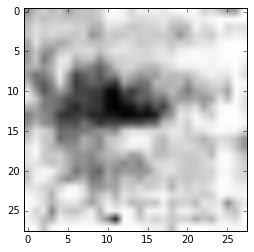

('Estimate:', array([[-21.16256142]], dtype=float32))
('Iteration:', 94100, 'at', datetime.datetime(2017, 7, 7, 15, 18, 46, 814011))


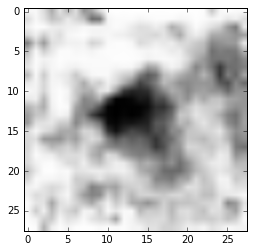

('Estimate:', array([[-7.02515697]], dtype=float32))
('Iteration:', 94200, 'at', datetime.datetime(2017, 7, 7, 15, 18, 55, 124401))


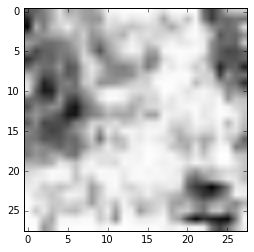

('Estimate:', array([[ 4.68162251]], dtype=float32))
('Iteration:', 94300, 'at', datetime.datetime(2017, 7, 7, 15, 19, 3, 408497))


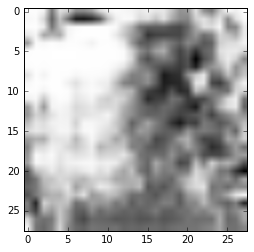

('Estimate:', array([[ 36.58577728]], dtype=float32))
('Iteration:', 94400, 'at', datetime.datetime(2017, 7, 7, 15, 19, 12, 258533))


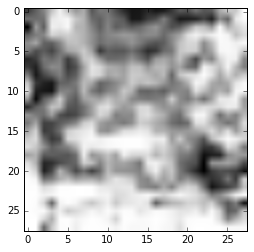

('Estimate:', array([[ 7.36876822]], dtype=float32))
('Iteration:', 94500, 'at', datetime.datetime(2017, 7, 7, 15, 19, 20, 516647))


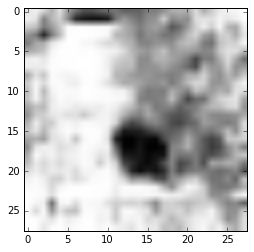

('Estimate:', array([[ 9.28651047]], dtype=float32))
('Iteration:', 94600, 'at', datetime.datetime(2017, 7, 7, 15, 19, 29, 109343))


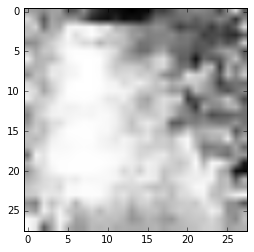

('Estimate:', array([[ 10.94974041]], dtype=float32))
('Iteration:', 94700, 'at', datetime.datetime(2017, 7, 7, 15, 19, 37, 115400))


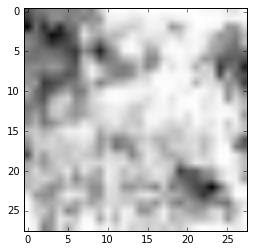

('Estimate:', array([[ 3.61865401]], dtype=float32))
('Iteration:', 94800, 'at', datetime.datetime(2017, 7, 7, 15, 19, 45, 324655))


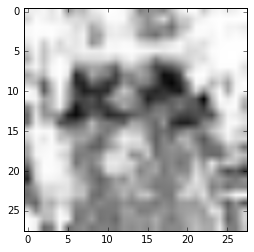

('Estimate:', array([[ 7.12391329]], dtype=float32))
('Iteration:', 94900, 'at', datetime.datetime(2017, 7, 7, 15, 19, 55, 181706))


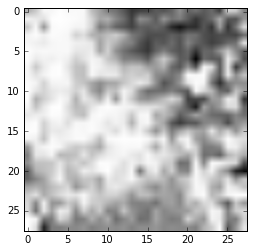

('Estimate:', array([[-39.30231857]], dtype=float32))
('Iteration:', 95000, 'at', datetime.datetime(2017, 7, 7, 15, 20, 3, 387033))


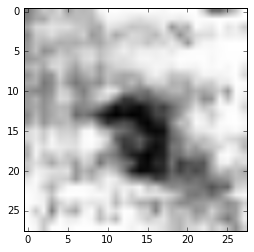

('Estimate:', array([[ 9.09481525]], dtype=float32))
('Iteration:', 95100, 'at', datetime.datetime(2017, 7, 7, 15, 20, 11, 931955))


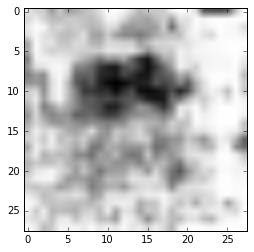

('Estimate:', array([[-0.76563215]], dtype=float32))
('Iteration:', 95200, 'at', datetime.datetime(2017, 7, 7, 15, 20, 20, 274343))


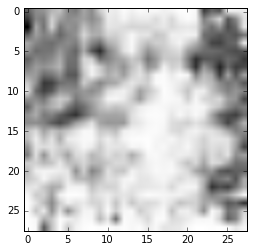

('Estimate:', array([[-1.60411131]], dtype=float32))
('Iteration:', 95300, 'at', datetime.datetime(2017, 7, 7, 15, 20, 28, 917711))


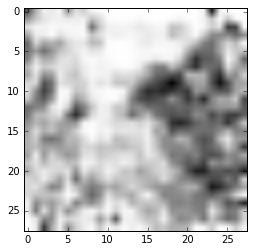

('Estimate:', array([[-13.13999367]], dtype=float32))
('Iteration:', 95400, 'at', datetime.datetime(2017, 7, 7, 15, 20, 37, 26577))


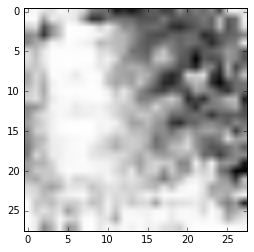

('Estimate:', array([[ 3.7607491]], dtype=float32))
('Iteration:', 95500, 'at', datetime.datetime(2017, 7, 7, 15, 20, 44, 973670))


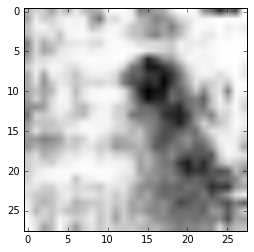

('Estimate:', array([[ 16.17033005]], dtype=float32))
('Iteration:', 95600, 'at', datetime.datetime(2017, 7, 7, 15, 20, 53, 304281))


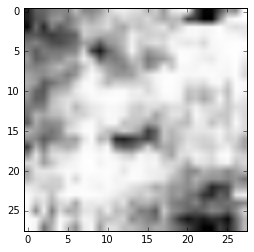

('Estimate:', array([[-28.30947876]], dtype=float32))
('Iteration:', 95700, 'at', datetime.datetime(2017, 7, 7, 15, 21, 1, 598379))


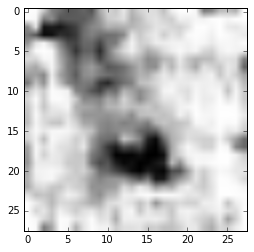

('Estimate:', array([[ 32.60420609]], dtype=float32))
('Iteration:', 95800, 'at', datetime.datetime(2017, 7, 7, 15, 21, 10, 980620))


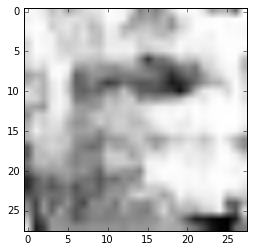

('Estimate:', array([[ 22.08407974]], dtype=float32))
('Iteration:', 95900, 'at', datetime.datetime(2017, 7, 7, 15, 21, 19, 81278))


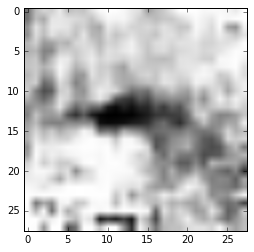

('Estimate:', array([[ 4.47237539]], dtype=float32))
('Iteration:', 96000, 'at', datetime.datetime(2017, 7, 7, 15, 21, 27, 512592))


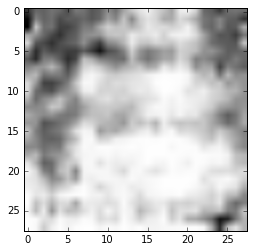

('Estimate:', array([[-1.96842146]], dtype=float32))
('Iteration:', 96100, 'at', datetime.datetime(2017, 7, 7, 15, 21, 35, 465401))


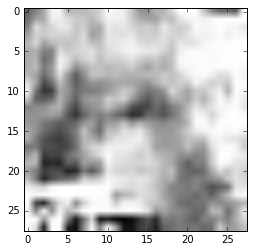

('Estimate:', array([[ 17.02200508]], dtype=float32))
('Iteration:', 96200, 'at', datetime.datetime(2017, 7, 7, 15, 21, 43, 823968))


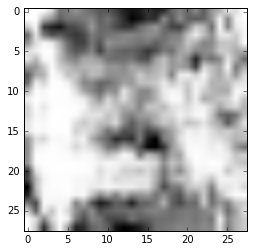

('Estimate:', array([[ 1.22093225]], dtype=float32))
('Iteration:', 96300, 'at', datetime.datetime(2017, 7, 7, 15, 21, 52, 533547))


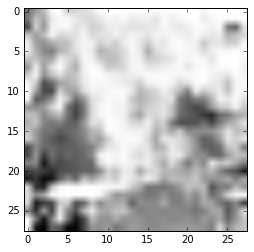

('Estimate:', array([[ 9.00751114]], dtype=float32))
('Iteration:', 96400, 'at', datetime.datetime(2017, 7, 7, 15, 22, 0, 834183))


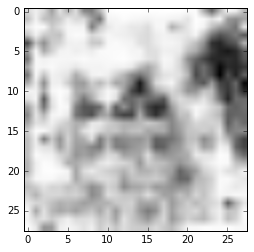

('Estimate:', array([[-55.73939514]], dtype=float32))
('Iteration:', 96500, 'at', datetime.datetime(2017, 7, 7, 15, 22, 9, 681797))


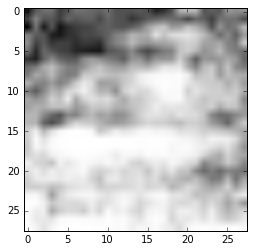

('Estimate:', array([[ 21.48440742]], dtype=float32))
('Iteration:', 96600, 'at', datetime.datetime(2017, 7, 7, 15, 22, 18, 702301))


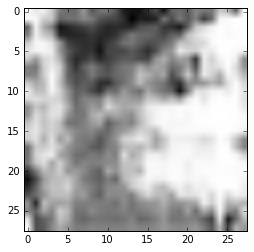

('Estimate:', array([[ 1.83758819]], dtype=float32))
('Iteration:', 96700, 'at', datetime.datetime(2017, 7, 7, 15, 22, 28, 745353))


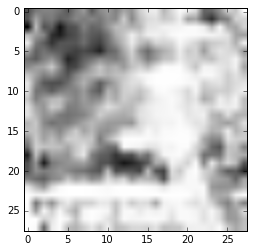

('Estimate:', array([[ 38.95607376]], dtype=float32))
('Iteration:', 96800, 'at', datetime.datetime(2017, 7, 7, 15, 22, 37, 102041))


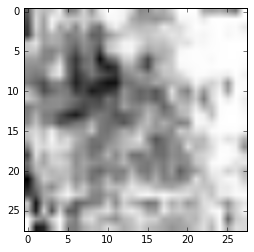

('Estimate:', array([[-4.00674248]], dtype=float32))
('Iteration:', 96900, 'at', datetime.datetime(2017, 7, 7, 15, 22, 45, 538905))


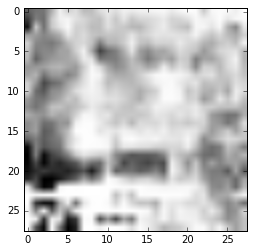

('Estimate:', array([[ 4.86251736]], dtype=float32))
('Iteration:', 97000, 'at', datetime.datetime(2017, 7, 7, 15, 22, 54, 147885))


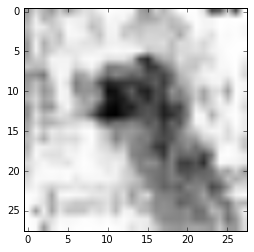

('Estimate:', array([[ 15.37490368]], dtype=float32))
('Iteration:', 97100, 'at', datetime.datetime(2017, 7, 7, 15, 23, 2, 271566))


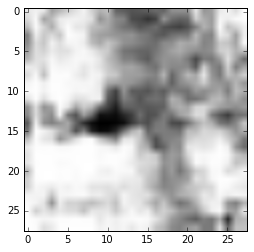

('Estimate:', array([[ 7.38360357]], dtype=float32))
('Iteration:', 97200, 'at', datetime.datetime(2017, 7, 7, 15, 23, 11, 773821))


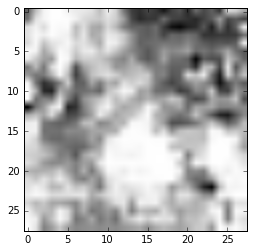

('Estimate:', array([[ 0.85485423]], dtype=float32))
('Iteration:', 97300, 'at', datetime.datetime(2017, 7, 7, 15, 23, 20, 607907))


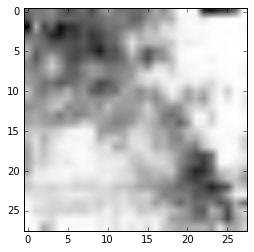

('Estimate:', array([[ 31.81530762]], dtype=float32))
('Iteration:', 97400, 'at', datetime.datetime(2017, 7, 7, 15, 23, 29, 908274))


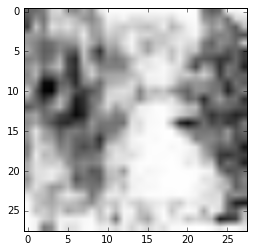

('Estimate:', array([[ 18.97779274]], dtype=float32))
('Iteration:', 97500, 'at', datetime.datetime(2017, 7, 7, 15, 23, 38, 441277))


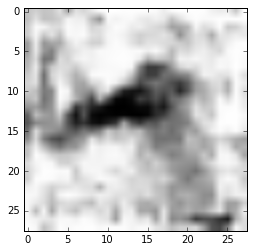

('Estimate:', array([[ 4.32414389]], dtype=float32))
('Iteration:', 97600, 'at', datetime.datetime(2017, 7, 7, 15, 23, 47, 890800))


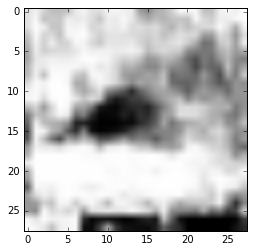

('Estimate:', array([[ 6.70384502]], dtype=float32))
('Iteration:', 97700, 'at', datetime.datetime(2017, 7, 7, 15, 23, 56, 49792))


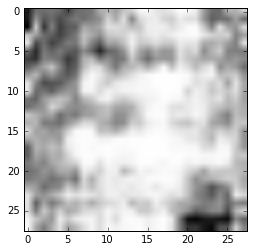

('Estimate:', array([[ 24.60021973]], dtype=float32))
('Iteration:', 97800, 'at', datetime.datetime(2017, 7, 7, 15, 24, 4, 576440))


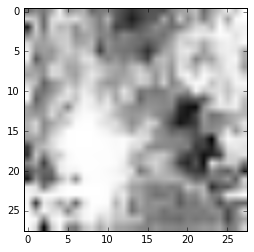

('Estimate:', array([[-20.78600311]], dtype=float32))
('Iteration:', 97900, 'at', datetime.datetime(2017, 7, 7, 15, 24, 13, 247472))


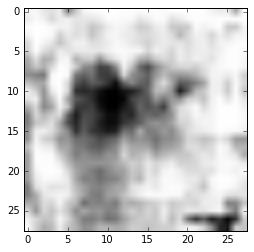

('Estimate:', array([[ 4.50067282]], dtype=float32))
('Iteration:', 98000, 'at', datetime.datetime(2017, 7, 7, 15, 24, 21, 409733))


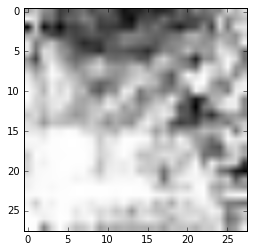

('Estimate:', array([[-27.88055038]], dtype=float32))
('Iteration:', 98100, 'at', datetime.datetime(2017, 7, 7, 15, 24, 29, 976879))


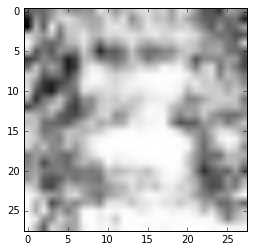

('Estimate:', array([[ 4.41856384]], dtype=float32))
('Iteration:', 98200, 'at', datetime.datetime(2017, 7, 7, 15, 24, 38, 458240))


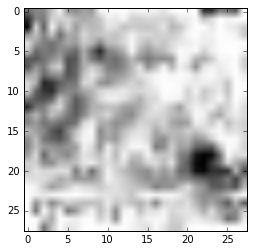

('Estimate:', array([[-4.04783964]], dtype=float32))
('Iteration:', 98300, 'at', datetime.datetime(2017, 7, 7, 15, 24, 47, 136907))


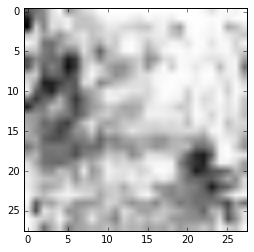

('Estimate:', array([[-14.9091711]], dtype=float32))
('Iteration:', 98400, 'at', datetime.datetime(2017, 7, 7, 15, 24, 55, 567079))


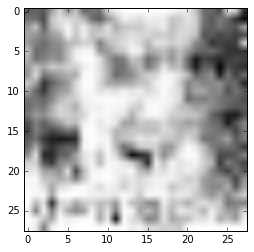

('Estimate:', array([[-22.342556]], dtype=float32))
('Iteration:', 98500, 'at', datetime.datetime(2017, 7, 7, 15, 25, 5, 245430))


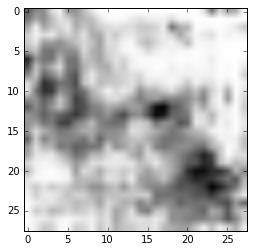

('Estimate:', array([[-0.27769446]], dtype=float32))
('Iteration:', 98600, 'at', datetime.datetime(2017, 7, 7, 15, 25, 14, 92903))


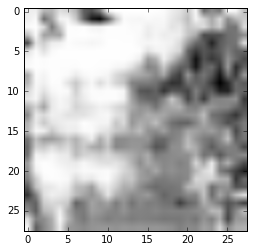

('Estimate:', array([[ 13.26334572]], dtype=float32))
('Iteration:', 98700, 'at', datetime.datetime(2017, 7, 7, 15, 25, 22, 635074))


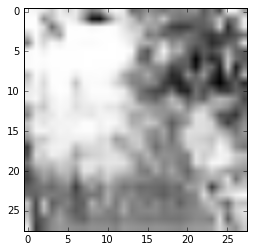

('Estimate:', array([[ 15.81180763]], dtype=float32))
('Iteration:', 98800, 'at', datetime.datetime(2017, 7, 7, 15, 25, 31, 350667))


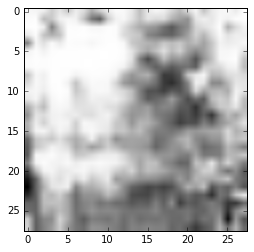

('Estimate:', array([[ 26.53946877]], dtype=float32))
('Iteration:', 98900, 'at', datetime.datetime(2017, 7, 7, 15, 25, 39, 411658))


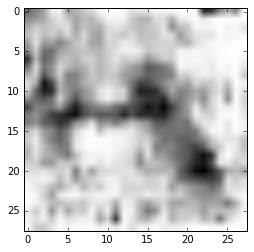

('Estimate:', array([[-14.18491364]], dtype=float32))
('Iteration:', 99000, 'at', datetime.datetime(2017, 7, 7, 15, 25, 48, 30897))


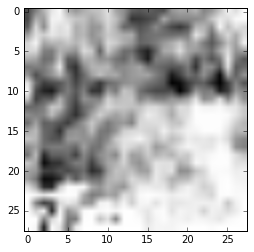

('Estimate:', array([[ 12.44781971]], dtype=float32))
('Iteration:', 99100, 'at', datetime.datetime(2017, 7, 7, 15, 25, 56, 438044))


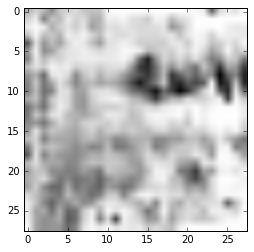

('Estimate:', array([[ 8.3272419]], dtype=float32))
('Iteration:', 99200, 'at', datetime.datetime(2017, 7, 7, 15, 26, 5, 931759))


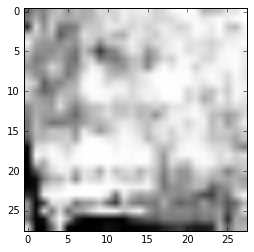

('Estimate:', array([[-7.03828001]], dtype=float32))
('Iteration:', 99300, 'at', datetime.datetime(2017, 7, 7, 15, 26, 14, 859008))


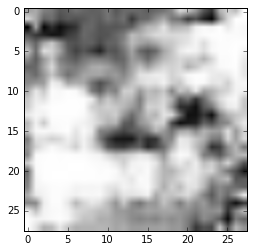

('Estimate:', array([[ 21.27856064]], dtype=float32))
('Iteration:', 99400, 'at', datetime.datetime(2017, 7, 7, 15, 26, 24, 556285))


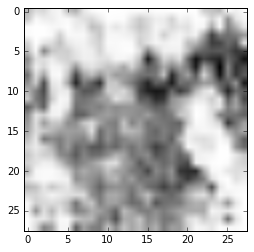

('Estimate:', array([[-14.74714947]], dtype=float32))
('Iteration:', 99500, 'at', datetime.datetime(2017, 7, 7, 15, 26, 33, 403473))


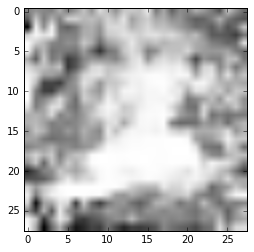

('Estimate:', array([[-2.46284938]], dtype=float32))
('Iteration:', 99600, 'at', datetime.datetime(2017, 7, 7, 15, 26, 41, 732755))


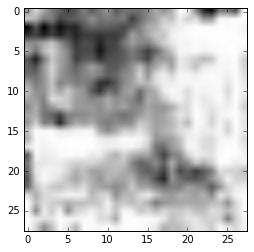

('Estimate:', array([[ 13.71348858]], dtype=float32))
('Iteration:', 99700, 'at', datetime.datetime(2017, 7, 7, 15, 26, 50, 687509))


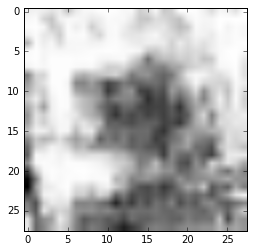

('Estimate:', array([[ 5.17143202]], dtype=float32))
('Iteration:', 99800, 'at', datetime.datetime(2017, 7, 7, 15, 26, 59, 246415))


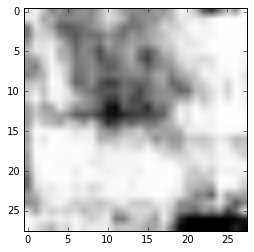

('Estimate:', array([[-6.42777014]], dtype=float32))
('Iteration:', 99900, 'at', datetime.datetime(2017, 7, 7, 15, 27, 7, 703288))


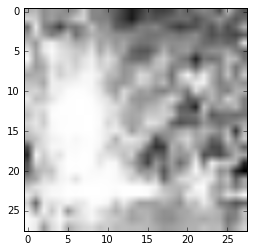

('Estimate:', array([[-12.0887022]], dtype=float32))


In [14]:
sess = tf.Session()
sess.run(tf.global_variables_initializer())

# Pre-train discriminator
for i in range(500):
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
    real_image_batch = mnist.train.next_batch(batch_size)[0].reshape([batch_size, 28, 28, 1])
    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
                                           {x_placeholder: real_image_batch, z_placeholder: z_batch})

    if(i % 100 == 0):
        print("dLossReal:", dLossReal, "dLossFake:", dLossFake)

# Train generator and discriminator together
for i in range(100000):
    real_image_batch = mnist.train.next_batch(batch_size)[0].reshape([batch_size, 28, 28, 1])
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])

    # Train discriminator on both real and fake images
    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
                                           {x_placeholder: real_image_batch, z_placeholder: z_batch})

    # Train generator
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
    _ = sess.run(g_trainer, feed_dict={z_placeholder: z_batch})

    if i % 10 == 0:
        # Update TensorBoard with summary statistics
        z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
        summary = sess.run(merged, {z_placeholder: z_batch, x_placeholder: real_image_batch})
        writer.add_summary(summary, i)

    if i % 100 == 0:
        # Every 100 iterations, show a generated image
        print("Iteration:", i, "at", datetime.datetime.now())
        z_batch = np.random.normal(0, 1, size=[1, z_dimensions])
        generated_images = generator(z_placeholder, 1, z_dimensions)
        images = sess.run(generated_images, {z_placeholder: z_batch})
        plt.imshow(images[0].reshape([28, 28]), cmap='Greys')
        plt.show()

        # Show discriminator's estimate
        im = images[0].reshape([1, 28, 28, 1])
        result = discriminator(x_placeholder)
        estimate = sess.run(result, {x_placeholder: im})
        print("Estimate:", estimate)

Because it can take so long to train a GAN, we recommend that you skip the cell above and execute the following cell. It loads a model that we've already trained for several hours on a fast GPU machine, and lets you experiment with the output of a trained GAN.

INFO:tensorflow:Restoring parameters from pretrained-model/pretrained_gan.ckpt


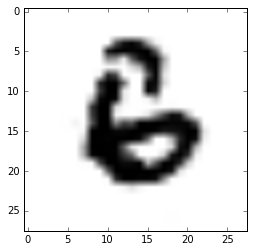

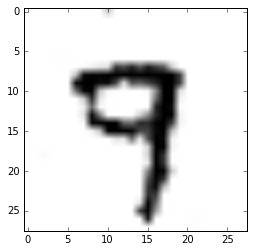

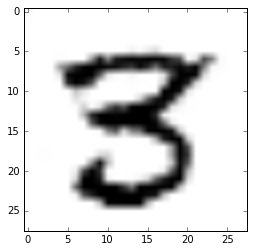

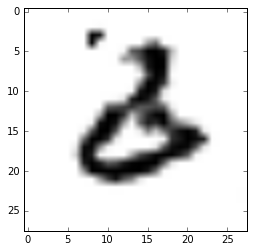

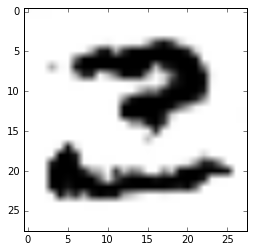

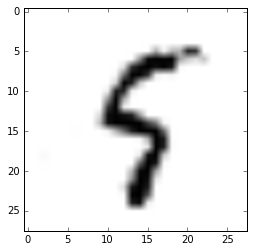

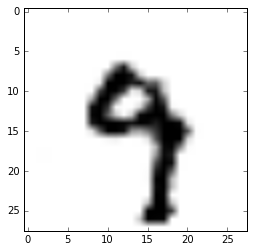

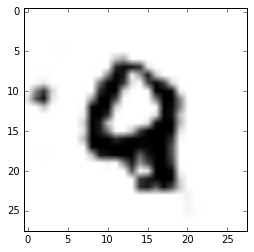

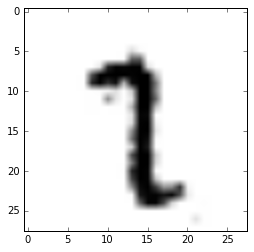

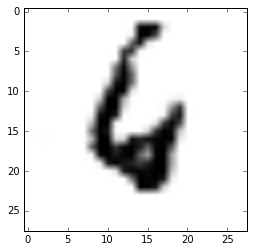

In [20]:
saver = tf.train.Saver()
with tf.Session() as sess:
    saver.restore(sess, 'pretrained-model/pretrained_gan.ckpt')
    z_batch = np.random.normal(0, 1, size=[10, z_dimensions])
    z_placeholder = tf.placeholder(tf.float32, [None, z_dimensions], name='z_placeholder') 
    generated_images = generator(z_placeholder, 10, z_dimensions)
    images = sess.run(generated_images, {z_placeholder: z_batch})
    for i in range(10):
        plt.imshow(images[i].reshape([28, 28]), cmap='Greys')
        plt.show()

## Training difficulties

GANs are notoriously difficult to train. Without the right hyperparameters, network architecture, and training procedure, the discriminator can overpower the generator, or vice-versa.

In one common failure mode, the discriminator overpowers the generator, classifying generated images as fake with absolute certainty. When the discriminator responds with absolute certainty, it leaves no gradient for the generator to descend. This is partly why we built our discriminator to produce unscaled output rather than passing its output through a sigmoid function that would push its evaluation toward either 0 or 1.

In another common failure mode known as **mode collapse**, the generator discovers and exploits some weakness in the discriminator. You can recognize mode collapse in your GAN if it generates many very similar images regardless of variation in the generator input _z_. Mode collapse can sometimes be corrected by "strengthening" the discriminator in some way—for instance, by adjusting its training rate or by reconfiguring its layers.

Researchers have identified a handful of ["GAN hacks"](https://github.com/soumith/ganhacks) that can be helpful in building stable GANs.

## Closing thoughts

GANs have tremendous potential to reshape the digital world that we interact with every day. The field is still very young, and the next great GAN discovery could be yours!

## Other resources

- [The original GAN paper](https://arxiv.org/abs/1406.2661) by Ian Goodfellow and his collaborators, published in 2014
- [A more recent tutorial by Goodfellow](https://arxiv.org/abs/1701.00160) that explains GANs in somewhat more accessible terms
- [A paper by Alec Radford, Luke Metz, and Soumith Chintala](https://arxiv.org/abs/1511.06434) that introduces deep convolutional GANs, whose basic structure we use in our generator in this tutorial. Also see [their DCGAN code on GitHub](https://github.com/Newmu/dcgan_code).
- [A reference collection of generative networks by Agustinus Kristiadi](https://github.com/wiseodd/generative-models), implemented in TensorFlow